In [1]:
import emgfit 
import numpy as np
import matplotlib.pyplot as plt
import pandas as pd
from tqdm.auto import tqdm

True peak spacing: 0.000186000 u
Bin width: 1.00e-05 u


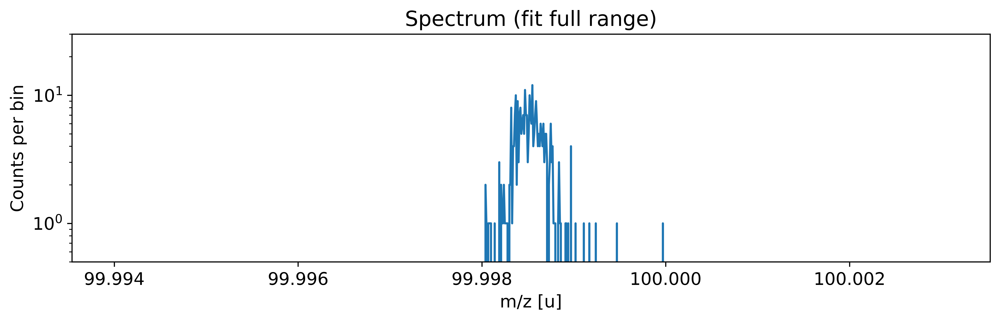

In [2]:
# Load shape parameters from 61Ga fit
df = pd.read_csv("2019-09-13_007 61u MRS on lasers on 400 IT fitting MLE_peakshape_calib.txt", sep="\t")
fit_model = df.keys()[0][-5:]
df.set_index(df.keys()[0], inplace=True)
shape_pars = df["Value"].to_dict()
#default_shape_pars = emgfit.fit_models.create_default_init_pars(mass_number=100)

FWHM = 0.000372 
true_dm = 0.5*FWHM
print(f"True peak spacing: {true_dm:.9f} u")
mus = [99.998441, 99.998441 + true_dm]
amps = [1.0, 1.0]
bkg_c = 0.0
N_events = 300
x_min = np.mean(mus) - 0.005
x_max = np.mean(mus) + 0.005
N_bins = 1000
bin_width = (x_max-x_min)/N_bins
print(f"Bin width: {bin_width:.2e} u")

from emgfit.sample import simulate_events
events = simulate_events(shape_pars, mus, amps, bkg_c, N_events, x_min, x_max, N_bins=N_bins)

# Create simulated spectrum
spec = emgfit.spectrum(df=events, show_plot=True)

In [3]:
#spec.detect_peaks(thres=0.006)
spec.add_peak(mus[0] + np.random.normal(scale=10e-06) )
spec.add_peak(mus[1] + np.random.normal(scale=10e-06) )


Added peak at 99.99843040714255 u
Added peak at 99.99861579129501 u


In [4]:
#spec.determine_peak_shape(index_shape_calib=0)

# Set shape calibration parameters to true reference values
spec.index_shape_calibrant = 0
spec.shape_cal_pars = shape_pars
spec.fit_model = fit_model


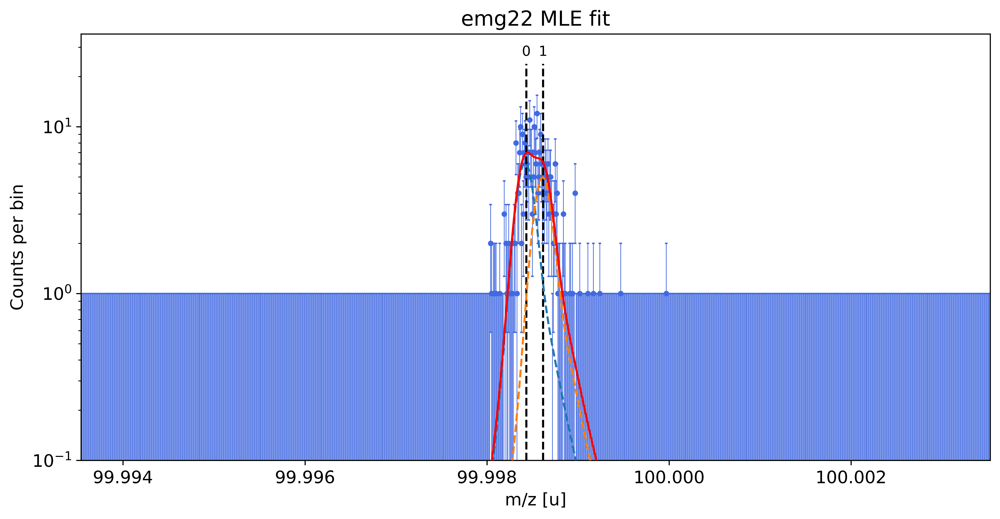

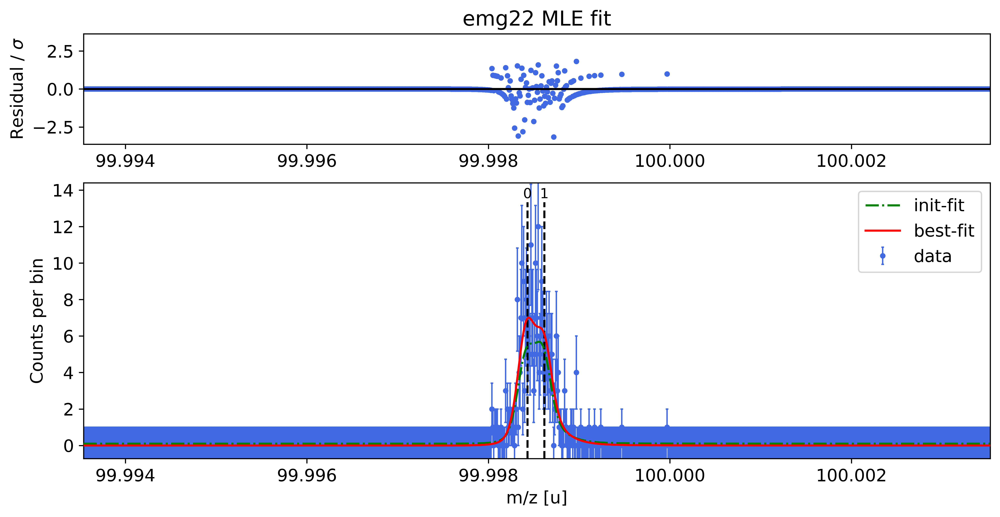

FWHM: 0.000226 u
mu0 - mu0_true: 0.000004 u
mu1 - mu1_true: 0.000011 u


In [5]:
exp_fit_result = spec.peakfit(cost_func="MLE", fit_model=spec.fit_model, method="least_squares")
print(f"FWHM: {spec.calc_FWHM_emg(0, fit_result=exp_fit_result):.6f} u")
m_dev0 = exp_fit_result.params["p0_mu"] - mus[0]
m_dev1 = exp_fit_result.params["p1_mu"] - mus[1]
print(f"mu0 - mu0_true: {m_dev0:.6f} u")
print(f"mu1 - mu1_true: {m_dev1:.6f} u")

In [6]:
from emgfit.sample import simulate_events
    
def fit_doublet(shape_pars, mus, amps, N_ions, N_bkg, fit_model=fit_model, cost_func="MLE", method="least_squares", 
                N_bins=1000, par_hint_args={}, show_outputs=False):
    """Fit double-peak and return best-fit Gaussian centroids"""
    x_min = np.mean(mus) - 0.005
    x_max = np.mean(mus) + 0.005
    bin_width = (x_max-x_min)/N_bins
    N_events = round(N_ions + N_bkg)
    bkg_c = (np.sum(amps)*N_events/(bin_width*N_ions) - np.sum(amps)/bin_width)/N_bins
    
    events = simulate_events(shape_pars, mus, amps, bkg_c, N_events, x_min, x_max,
                             out='hist', scl_facs=None, N_bins=N_bins)

    # Create simulated spectrum
    spec = emgfit.spectrum(df=events, show_plot=show_outputs)
    
    # Initialize peaks
    spec.add_peak(mus[0] + np.random.normal(scale=10e-06), verbose=show_outputs )
    spec.add_peak(mus[1] + np.random.normal(scale=10e-06), verbose=show_outputs )

    # Set shape calibration parameters to true reference values
    spec.index_shape_calibrant = 0
    spec.shape_cal_pars = shape_pars
    spec.fit_model = fit_model
    
    # Fit spectrum
    fit_result = spec.peakfit(cost_func=cost_func, fit_model=spec.fit_model, method=method,
                              show_plots=show_outputs, par_hint_args=par_hint_args)
    if show_outputs:
        print(f"FWHM: {spec.calc_FWHM_emg(0, fit_result=fit_result)} u")

    return fit_result

Total event number: 130


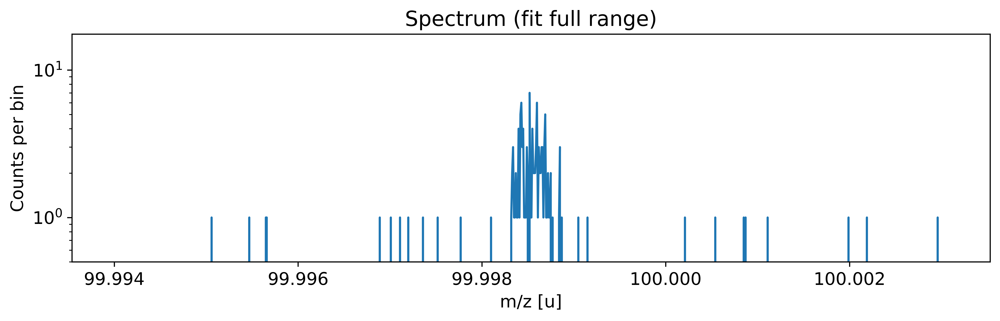

Added peak at 99.99845996117533 u
Added peak at 99.99861596200678 u


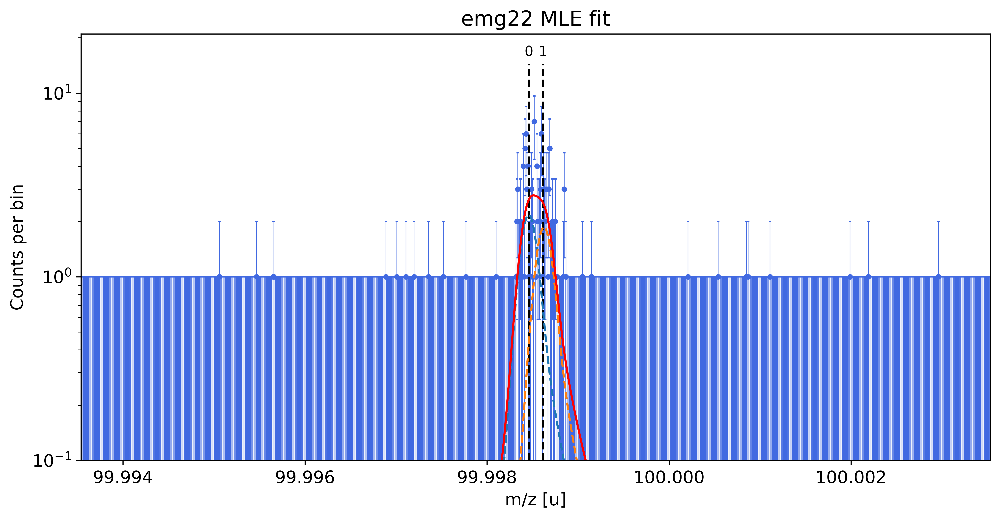

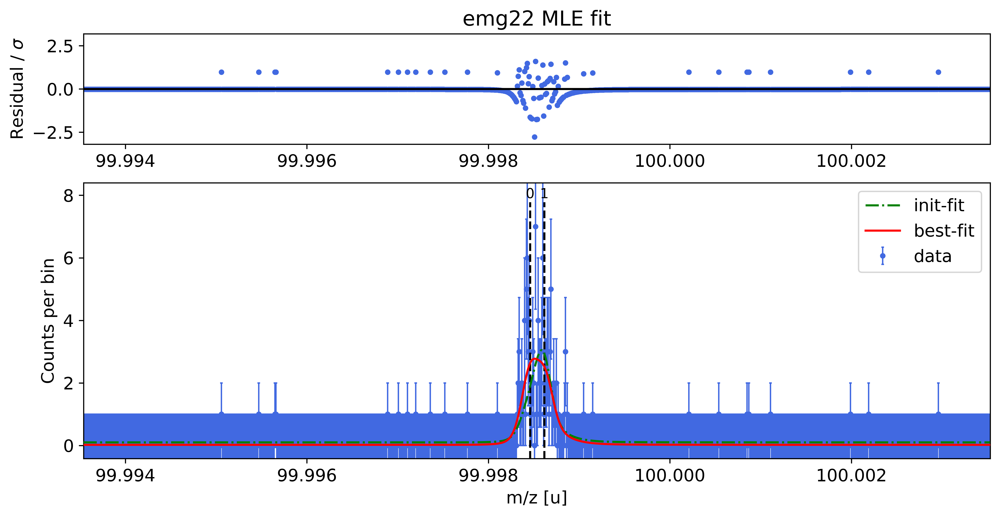

FWHM: 0.00022624276930116594 u


In [7]:
amps = [1.0, 1.0]
bkg_c = 1.0
N_ions = 100
N_bkg = 30
N_spectra = 10
cost_func = "MLE"
method = "least_squares"

N_events = N_ions + N_bkg
print(f"Total event number: {N_events}")

fit_doublet(shape_pars, mus, amps, N_ions, N_bkg, cost_func=cost_func, method=method, show_outputs=True)

In [8]:
def get_peak_overlap_bias(peak_separations, amps, N_ions, N_bkg,
                          N_spectra=1000, cost_func="MLE", method="least_squares"):
    mean_mu0s = []
    mean_mu1s = []
    stderr_mu0s = []
    stderr_mu1s = []
    true_mu0s = []
    true_mu1s = []
    for true_dm in peak_separations:
        print("Peak separation:",true_dm,"u")
        true_mus = [99.998441, 99.998441 + true_dm]
        true_mu0s.append(true_mus[0])
        true_mu1s.append(true_mus[1])
        mu0s = []
        mu1s = []
        N_failed_fits = 0
        for i in tqdm(range(N_spectra)):
            try:
                fit_result = fit_doublet(shape_pars, true_mus, amps, N_ions, N_bkg,
                                         cost_func=cost_func, method=method)
                mu0 = fit_result.params["p0_mu"].value
                mu1 = fit_result.params["p1_mu"].value
                mu0s.append(mu0)
                mu1s.append(mu1)
            except ValueError:
                N_failed_fits += 1 
        
        if N_failed_fits > 0: 
            print(f"Number of failed fits: {N_failed_fits}")
        mean_mu0s.append(np.mean(mu0s))
        mean_mu1s.append(np.mean(mu1s))
        stderr_mu0s.append(np.std(mu0s, ddof=1)/np.sqrt(len(mu0s)))
        stderr_mu1s.append(np.std(mu1s, ddof=1)/np.sqrt(len(mu1s)))
        
        
        plt.hist(mu0s, color="mediumblue", label="Centroids - left peak", bins=20)
        plt.gca().axvline(mean_mu0s[-1], linestyle="dashed", color="mediumblue")
        plt.gca().axvline(true_mus[0], color="mediumblue"), #label= "True centroid - left peak")
        plt.hist(mu1s, color="firebrick", label="Centroids - right peak", bins=20)
        plt.gca().axvline(mean_mu1s[-1], linestyle="dashed", color="firebrick")
        plt.gca().axvline(true_mus[1], color="firebrick")# label= "True centroid - right peak")
        plt.xlabel("m/z (u)")
        plt.legend()
        plt.show()
    
    return np.array(true_mu0s), np.array(true_mu1s), np.array(mean_mu0s), np.array(mean_mu1s), np.array(stderr_mu0s), np.array(stderr_mu1s)

def evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, N_spectra=1000, 
                               cost_func="MLE", method="least_squares", N_bins=1000, save_figure=True):
    N_events = N_ions + N_bkg
    print(f"Total event number: {N_events}")
    bkg_c = (np.sum(amps)*N_events/(bin_width*N_ions) - np.sum(amps)/bin_width)/N_bins
    print(f"Background amplitude: bkg_c = {bkg_c}")

    # Plot an example spectrum
    print("\n##### Plot example spectrum and fit #####")
    fit_doublet(shape_pars, mus, amps, N_ions, N_bkg, fit_model=fit_model, cost_func=cost_func, 
                method=method, N_bins=N_bins, show_outputs=True)

    # Run MC simulation
    print("\n##### Evaluate peak overlap bias #####")
    results = get_peak_overlap_bias(peak_separations, amps, N_ions, N_bkg, N_spectra=N_spectra, 
                                    cost_func=cost_func, method=method)
    true_mu0s, true_mu1s, mean_mu0s, mean_mu1s, stderr_mu0s, stderr_mu1s = results 

    # Plot results
    plt.title(str(N_ions)+" ions, "+str(cost_func)+" "+str(method)+" fit")
    plt.errorbar(peak_separations/FWHM, (mean_mu0s-true_mu0s)/FWHM, stderr_mu0s/FWHM, 
                 fmt="o--", capsize=4, color="mediumblue", label="Left peak")
    plt.errorbar(peak_separations/FWHM, (mean_mu1s-true_mu1s)/FWHM, stderr_mu1s/FWHM, 
                 fmt="o--", capsize=4, color="firebrick", label="Right peak")
    plt.gca().axhline(0, color="black")
    plt.xlabel("True peak separation (FWHM)")
    plt.ylabel("Mean deviation from true centroid (FWHM)")
    plt.legend()
    plt.tight_layout()
    if save_figure:
        plt.savefig("Peak_overlap_bias_"+str(N_ions)+"_ions_amps_"+str(amps)+"_N_bkg_"+str(N_bkg)+"_"+str(cost_func)+"_"+str(method)+"_fit.png", dpi=600)
    plt.show()

# Compare different statistics

### 100 ions

#### chi-square, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 6.000000000005453

##### Plot example spectrum and fit #####


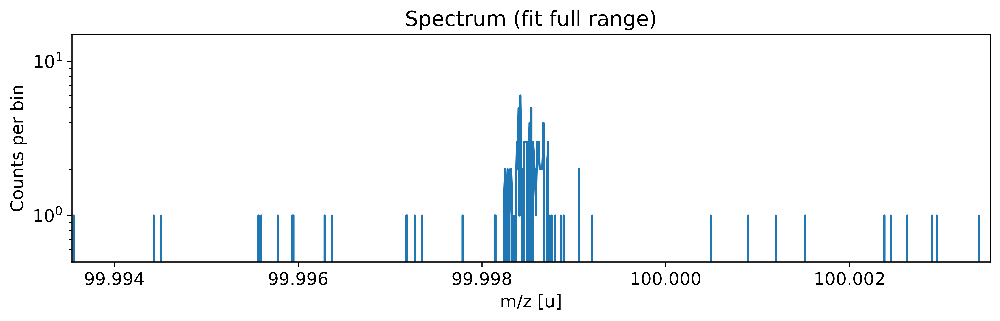

Added peak at 99.9984334108579 u
Added peak at 99.9986427565403 u


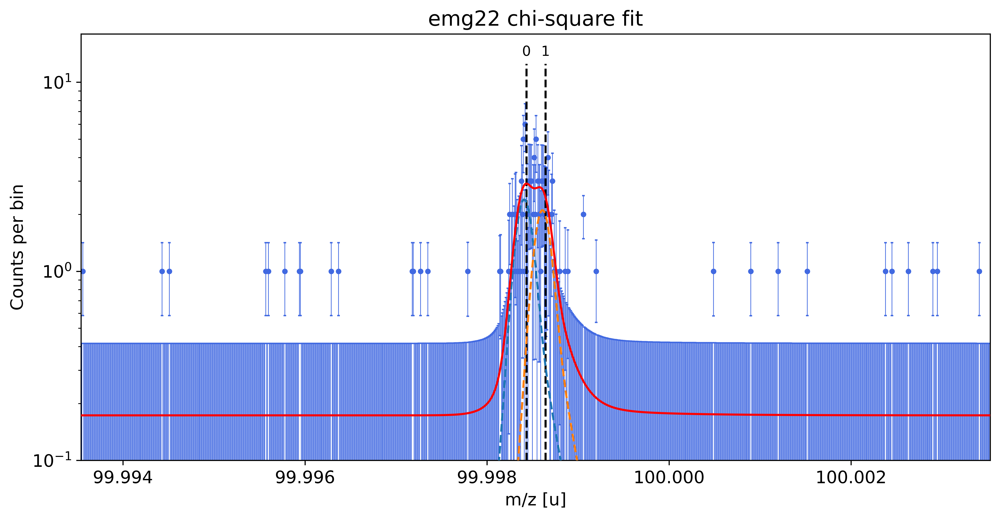

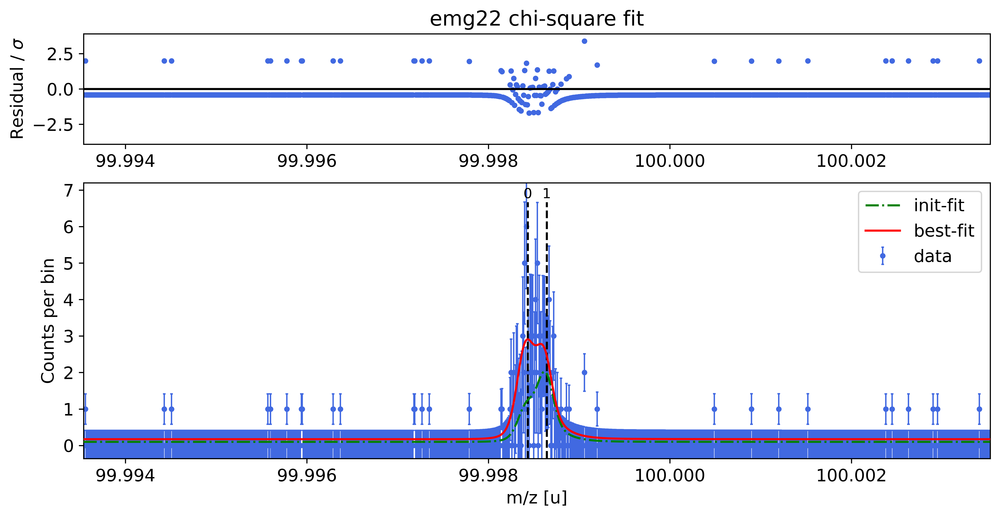

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


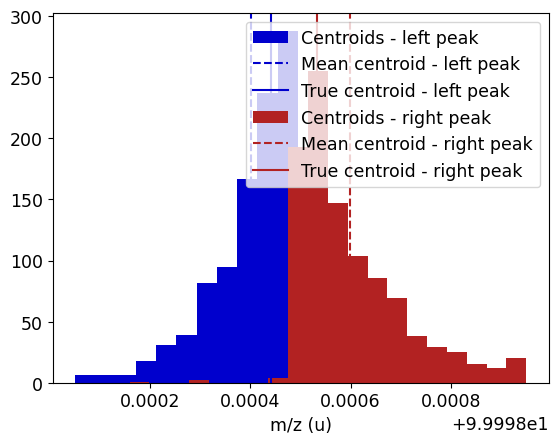

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

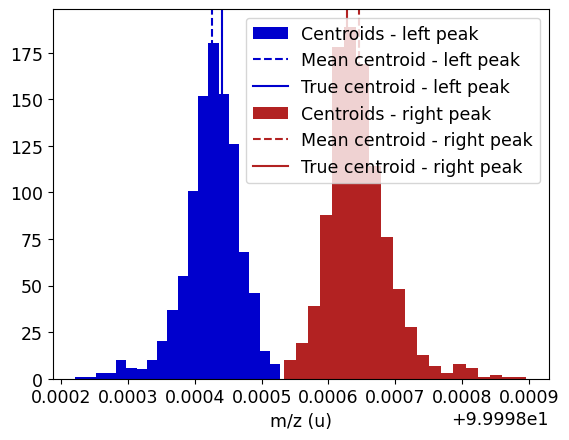

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

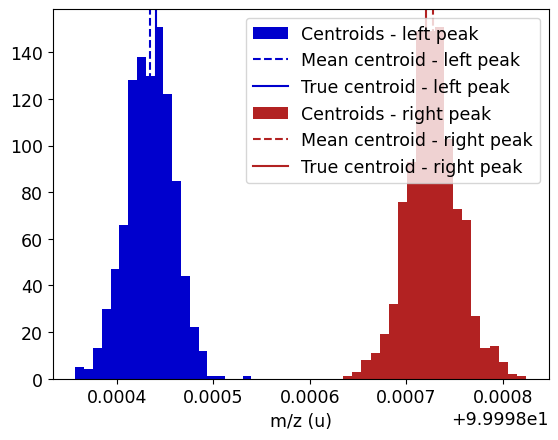

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

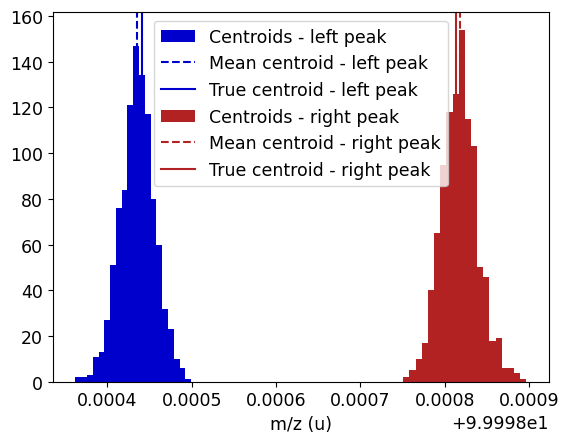

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

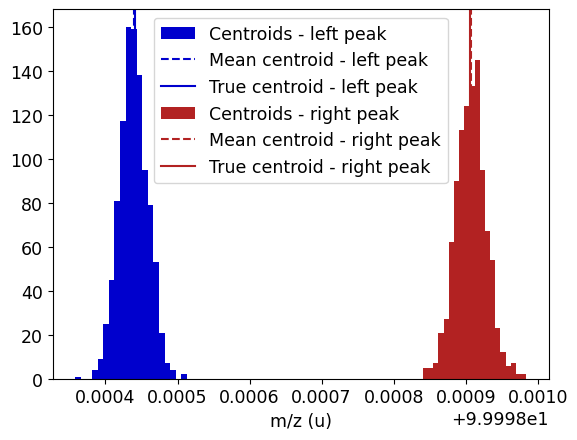

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

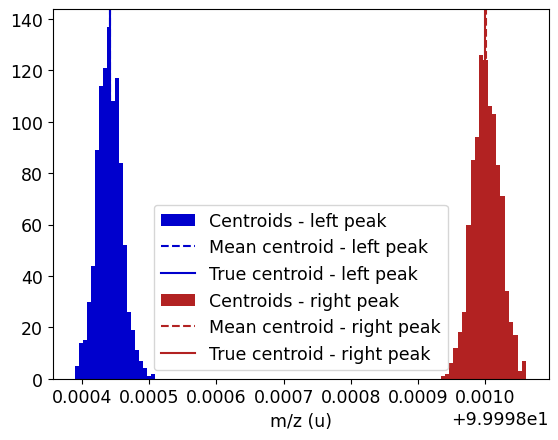

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p1_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


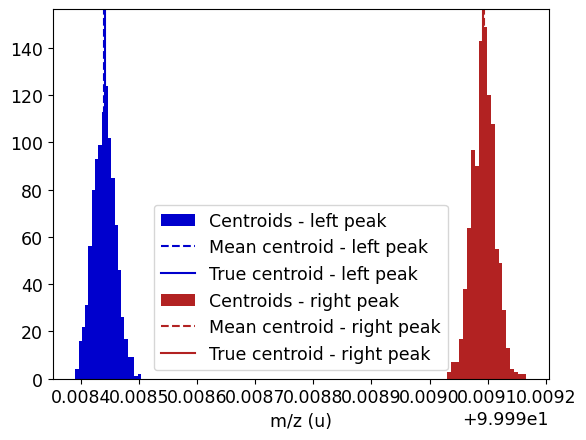

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

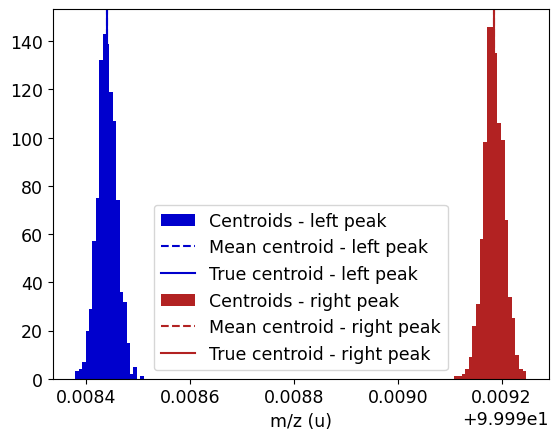

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

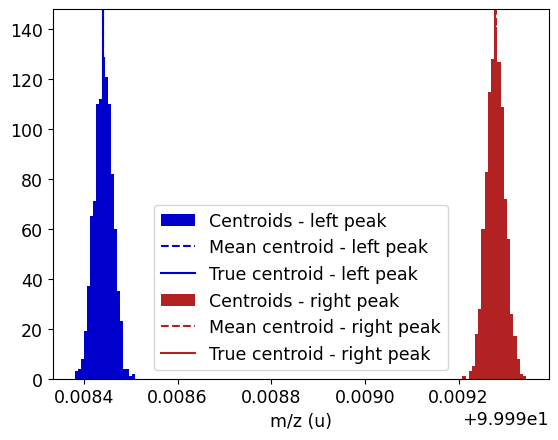

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

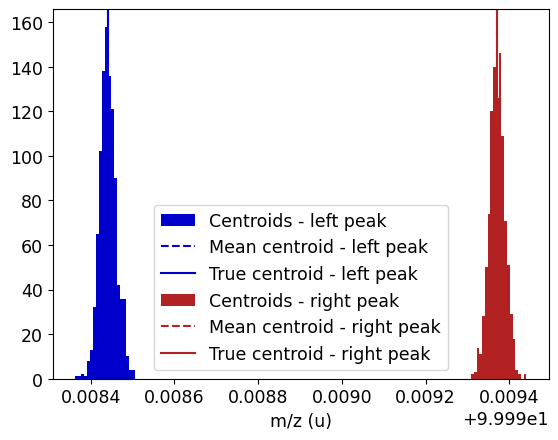

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

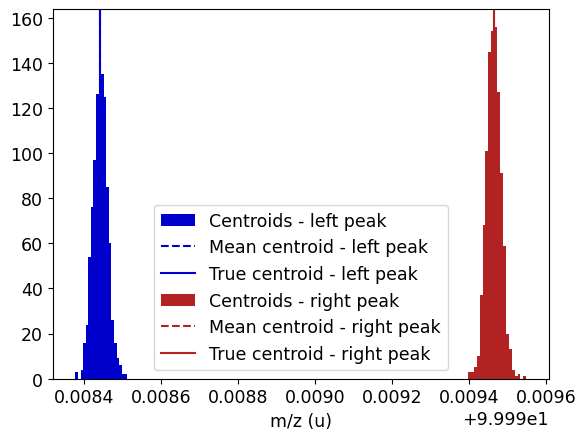

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

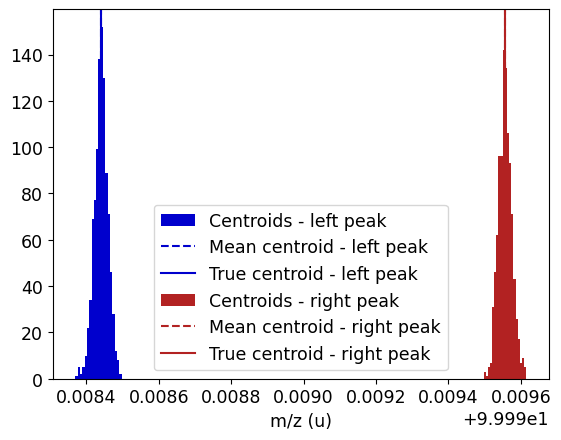

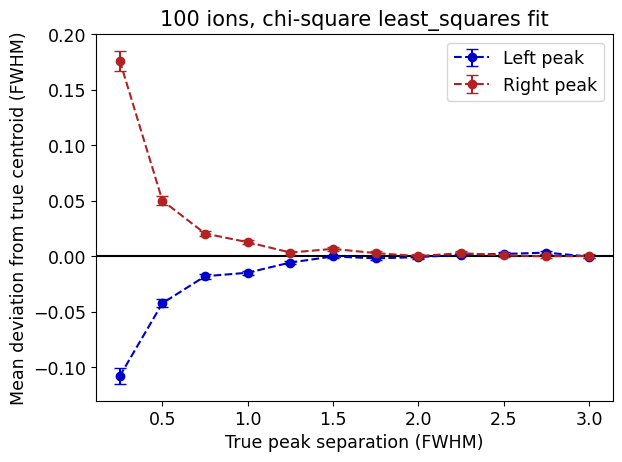

In [23]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 6.000000000005453

##### Plot example spectrum and fit #####


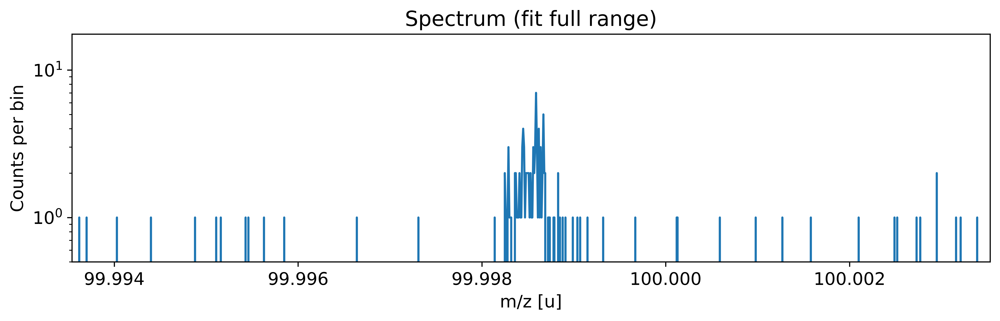

Added peak at 99.99844442869002 u
Added peak at 99.99862690285131 u


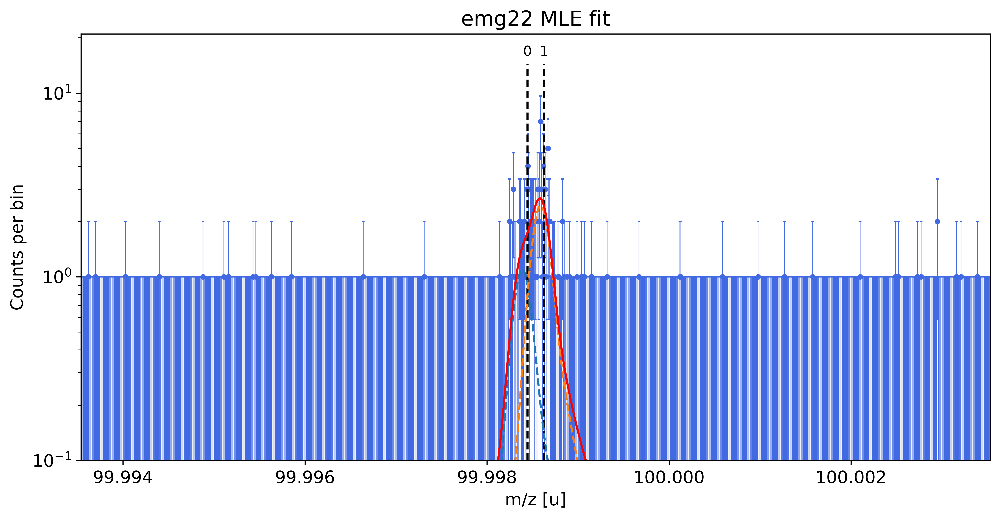

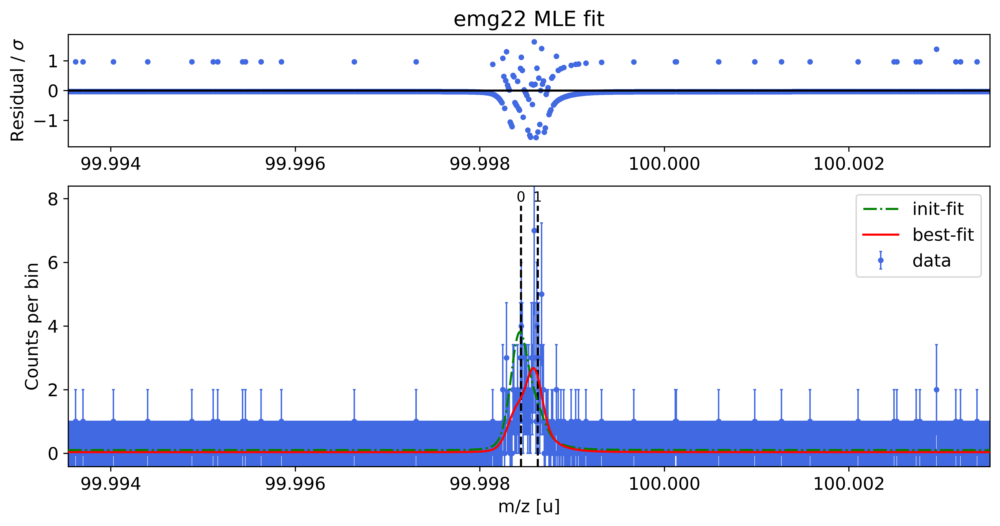

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


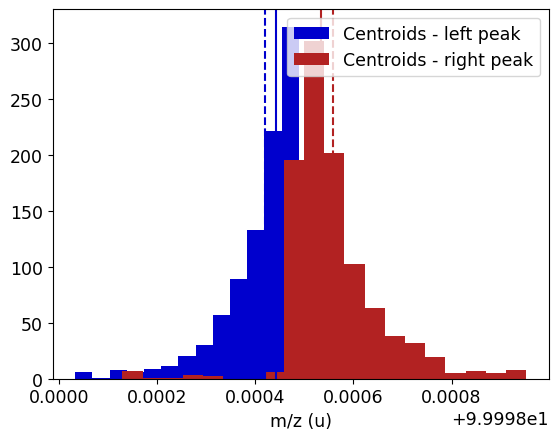

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

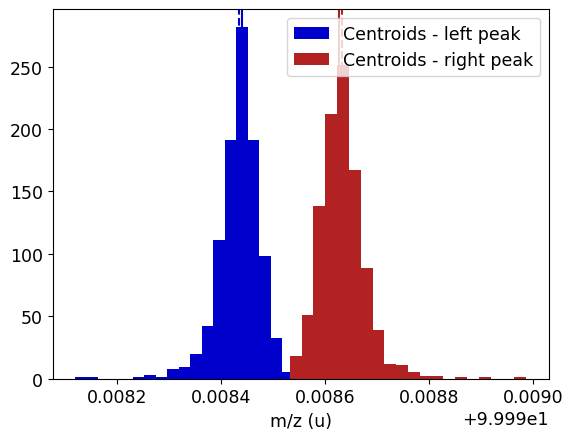

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

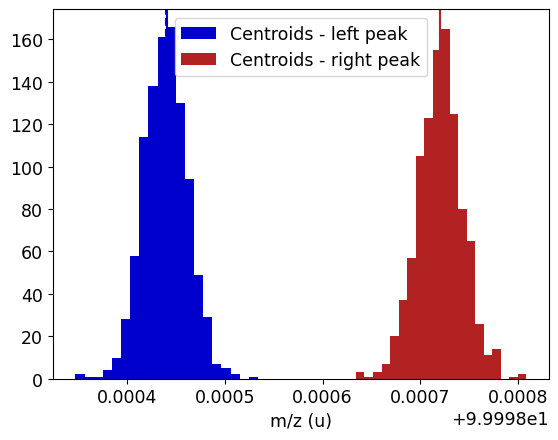

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

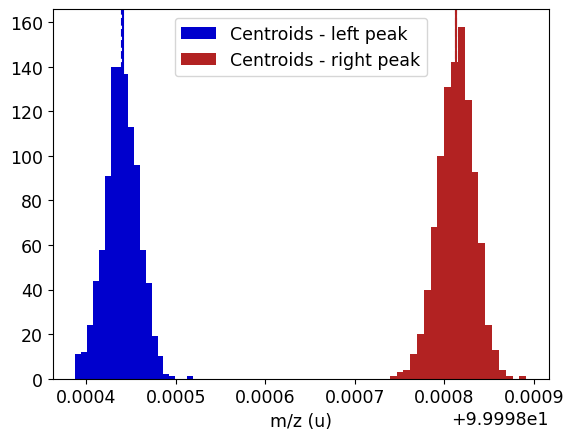

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

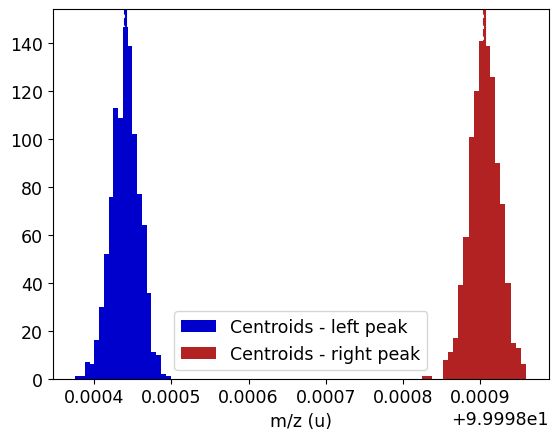

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

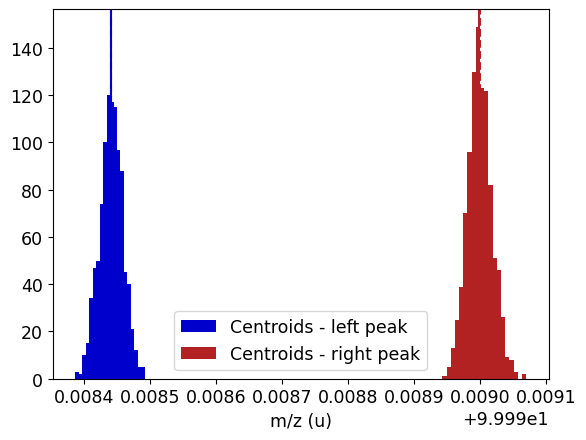

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

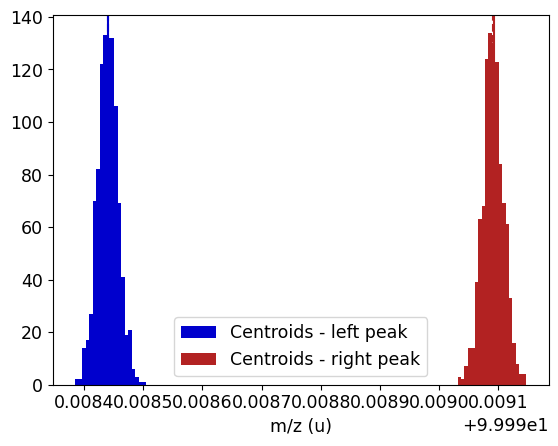

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

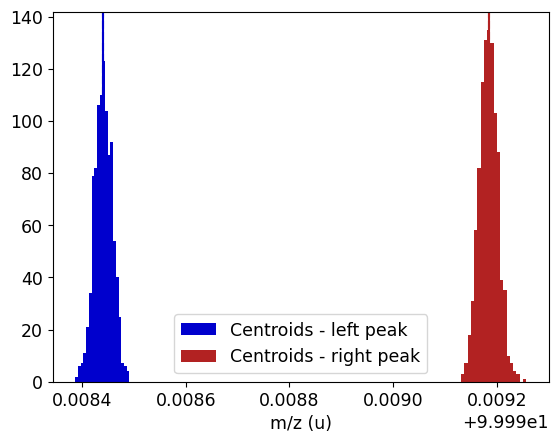

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

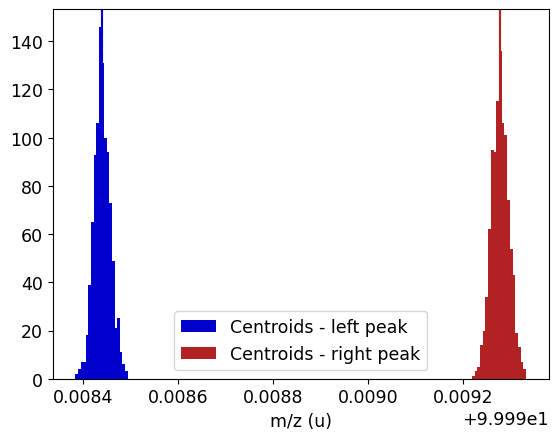

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

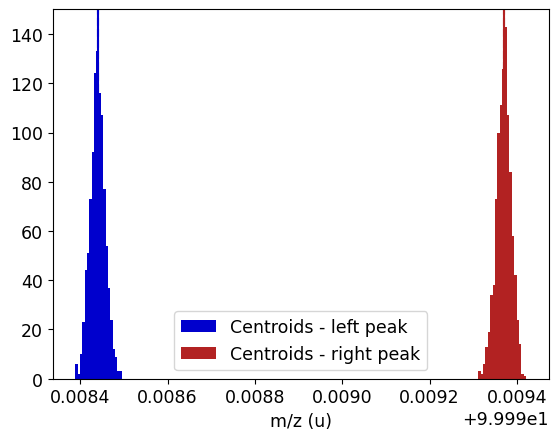

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

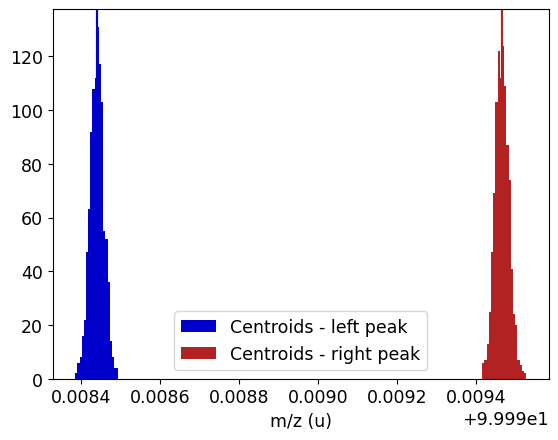

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

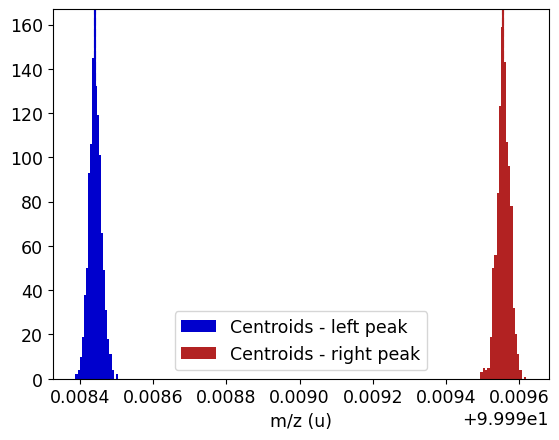

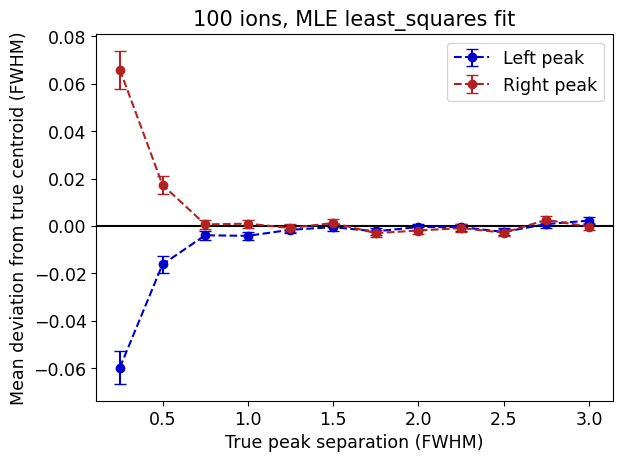

In [31]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, Powell fit

Total event number: 130
Background amplitude: bkg_c = 6.000000000005453

##### Plot example spectrum and fit #####


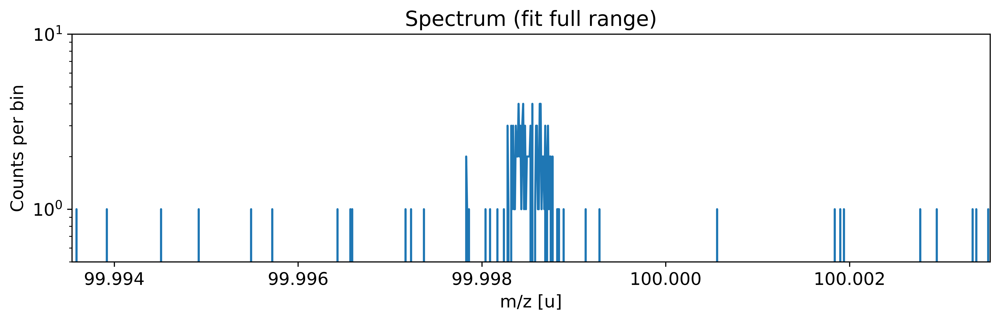

Added peak at 99.99844206087016 u
Added peak at 99.99863726619922 u


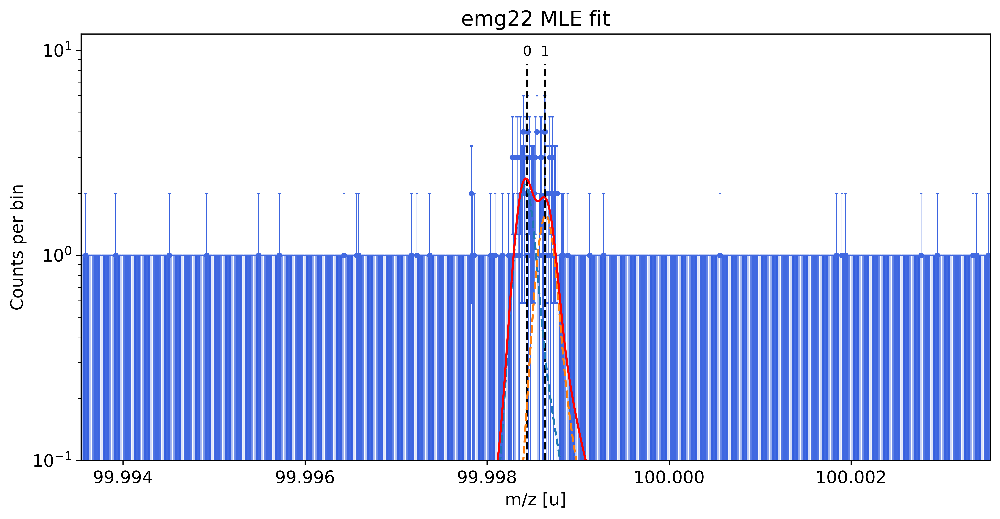

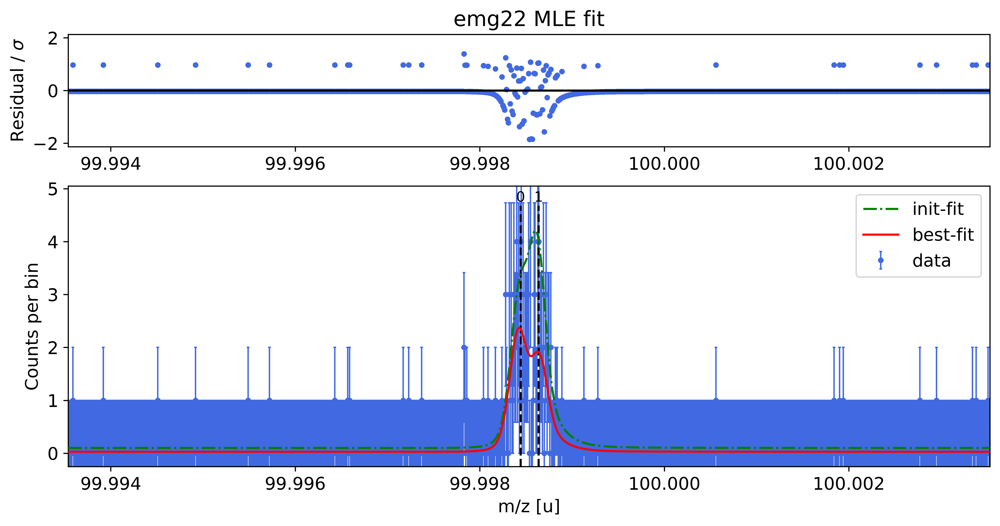

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


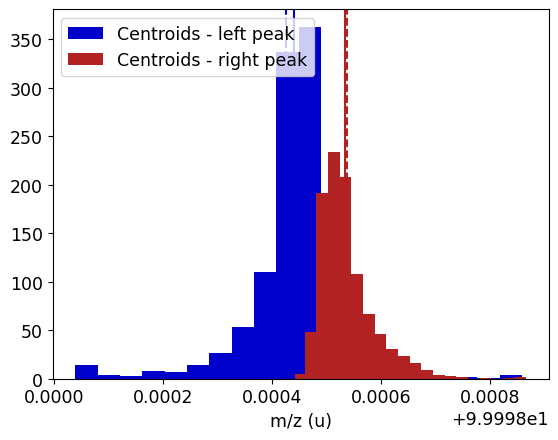

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

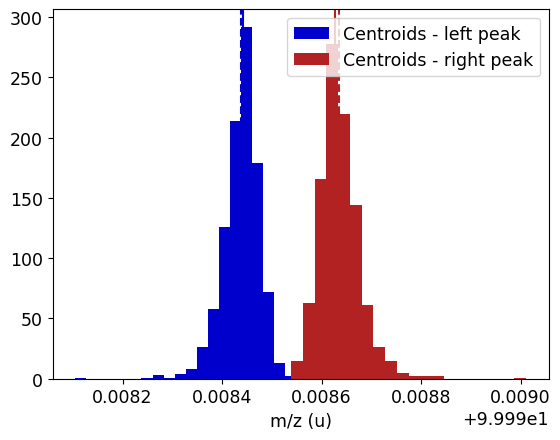

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

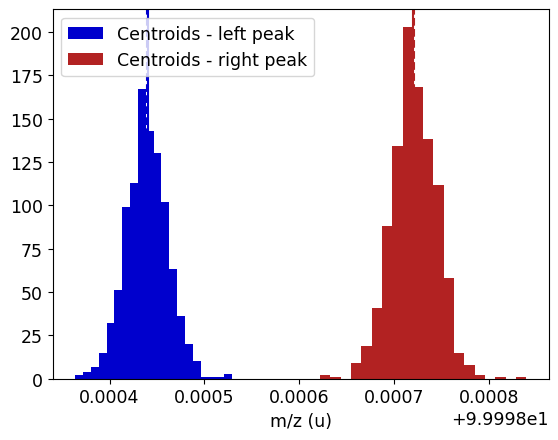

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

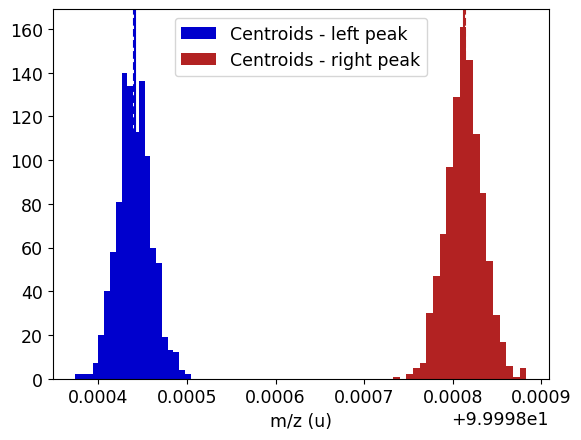

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

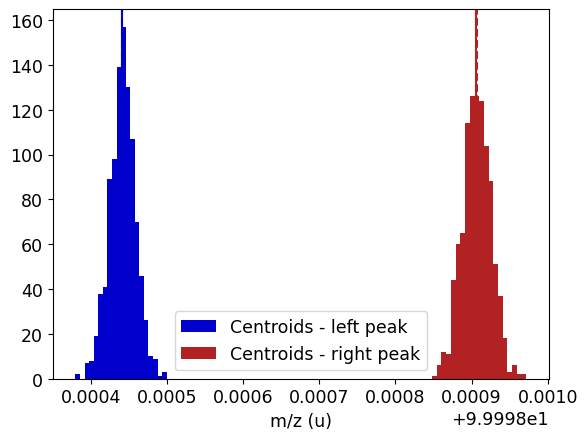

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

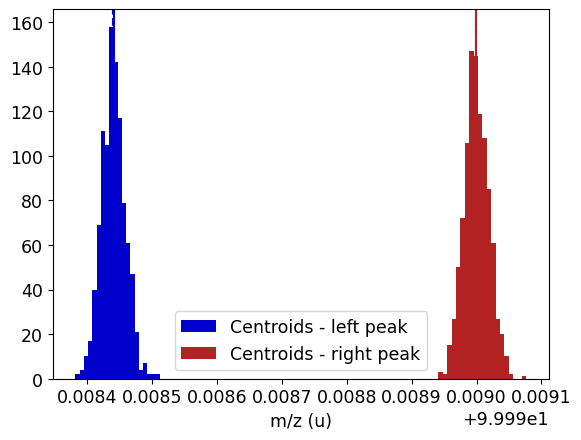

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

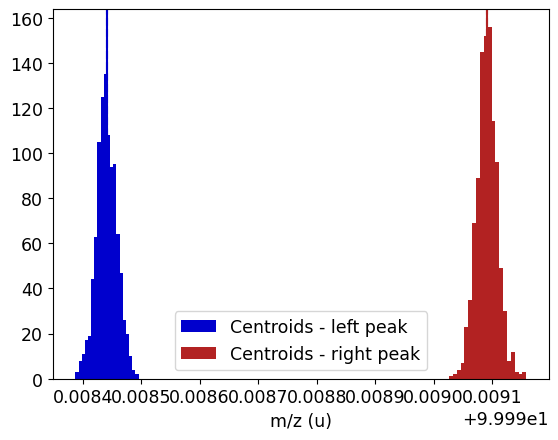

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

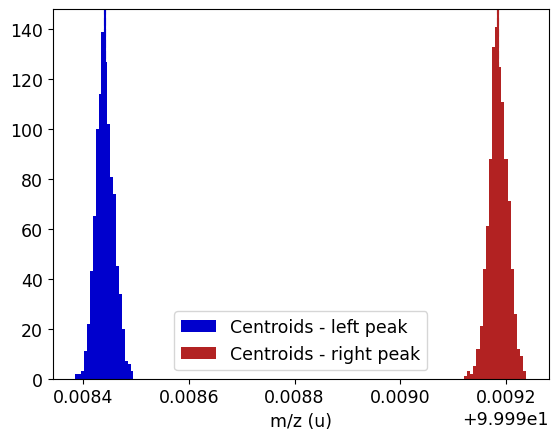

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

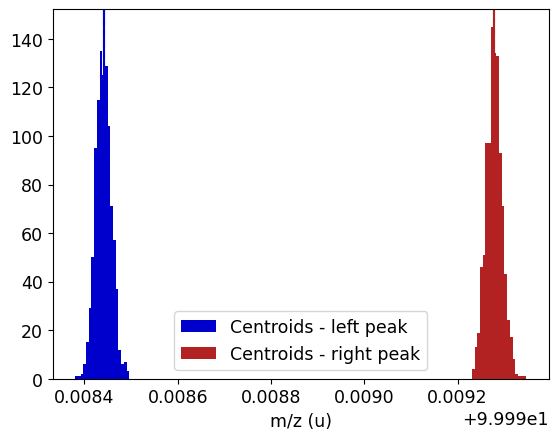

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

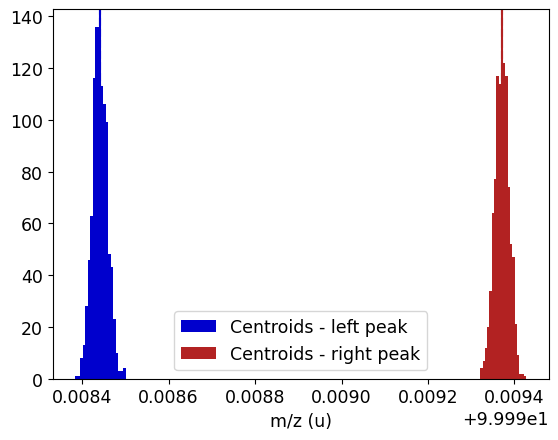

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

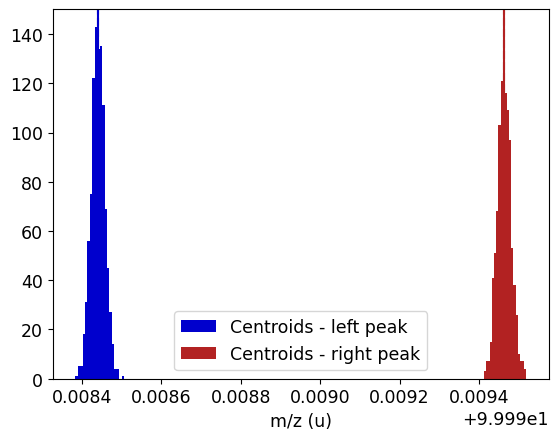

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

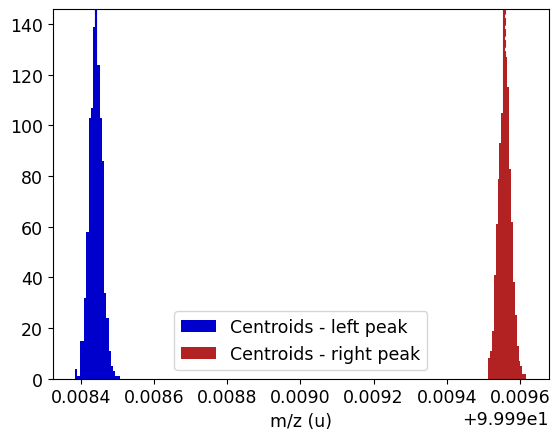

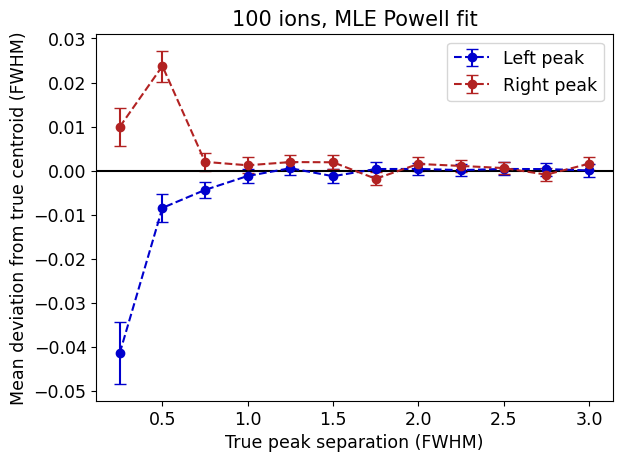

In [36]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

### 1000 ions

#### chi-square, least_squares fit

Total event number: 1030
Background amplitude: bkg_c = 0.6000000000005457

##### Plot example spectrum and fit #####


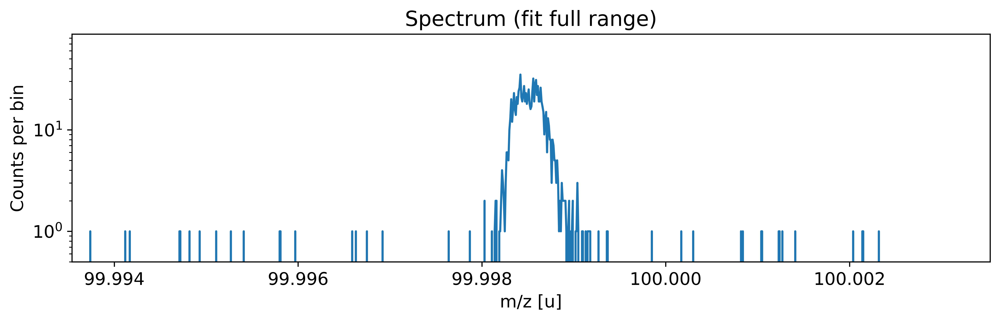

Added peak at 99.99844769018421 u
Added peak at 99.99862988475513 u


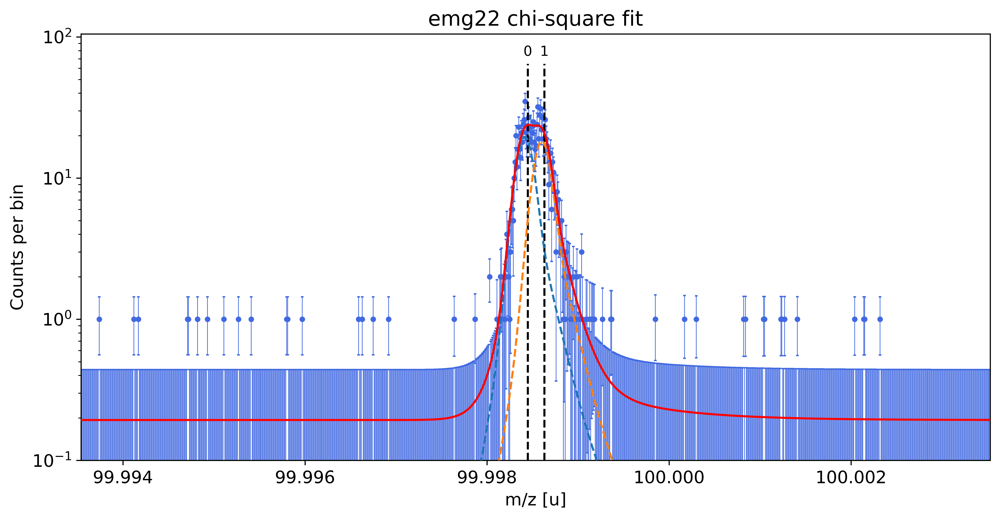

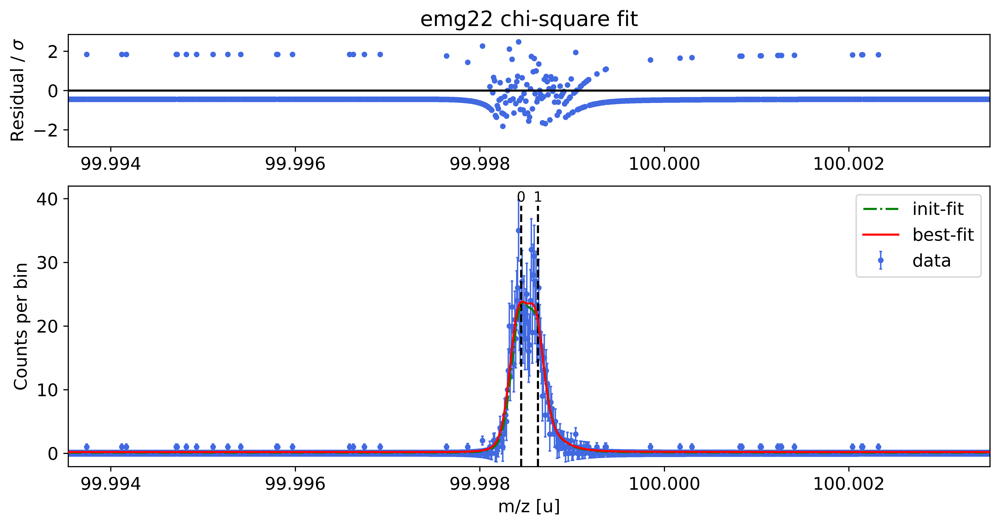

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


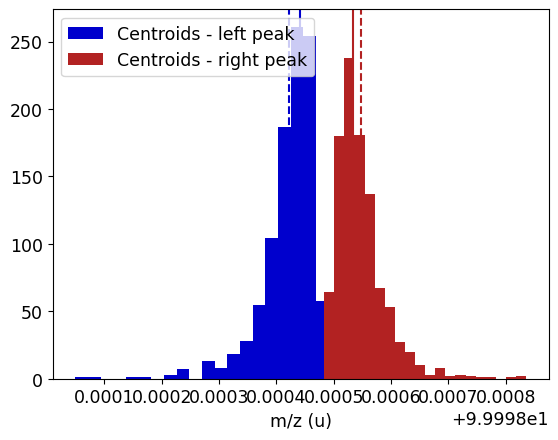

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

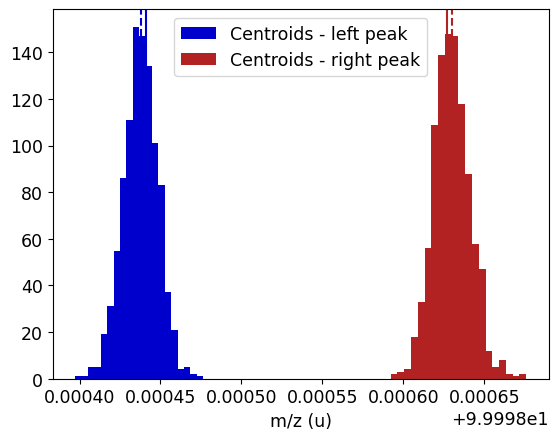

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

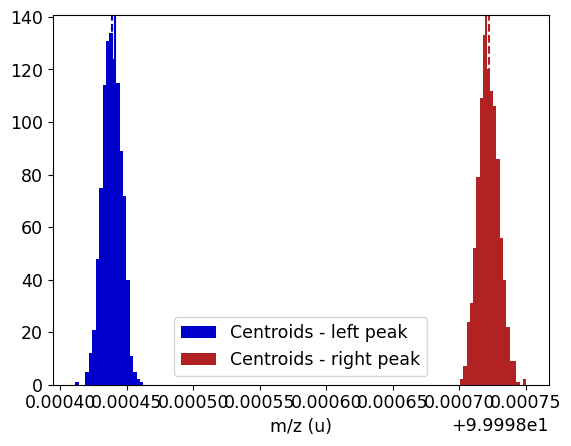

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

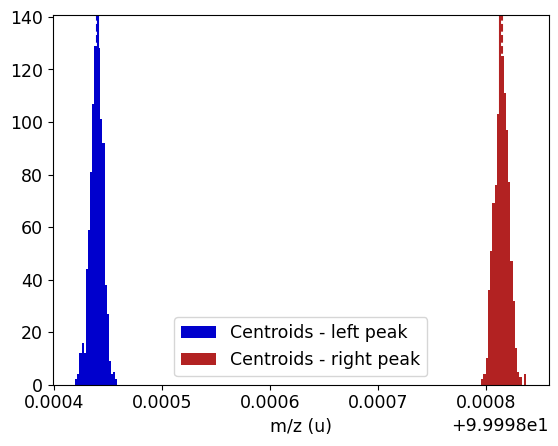

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p1_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


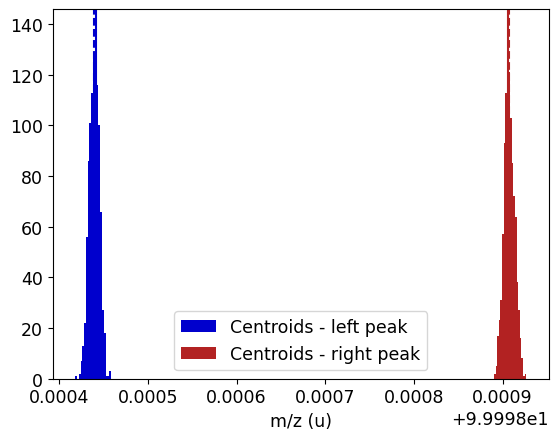

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

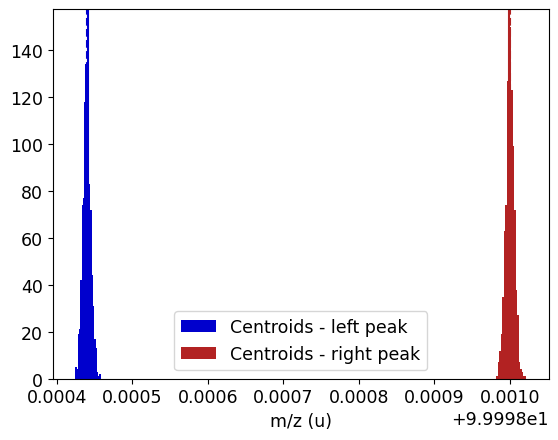

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

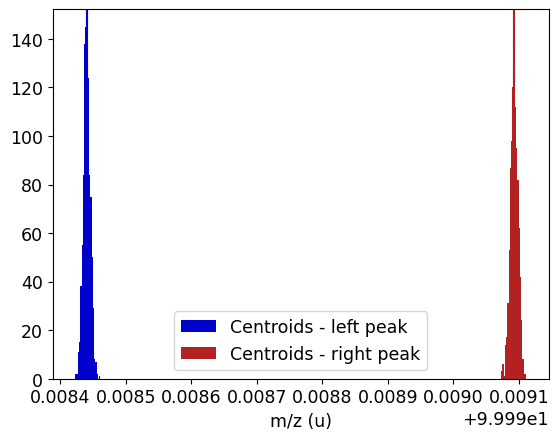

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

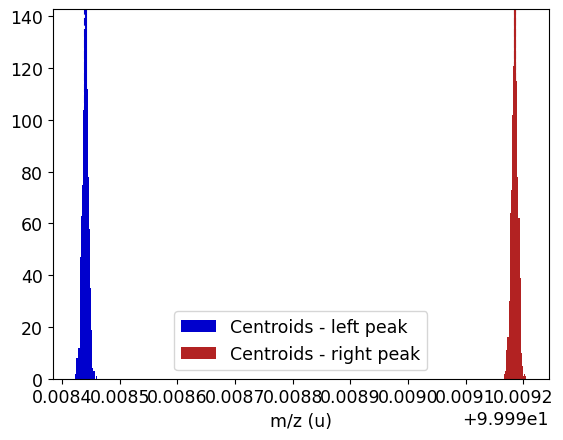

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

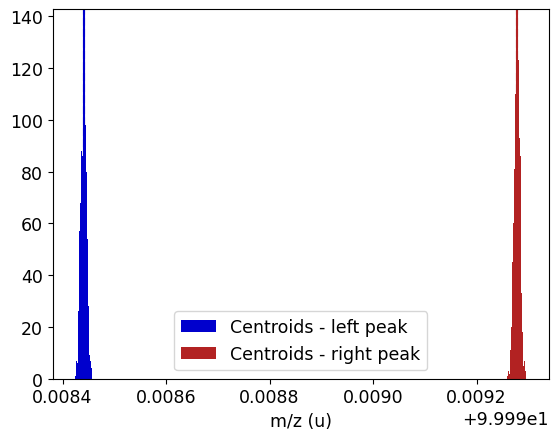

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 2 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


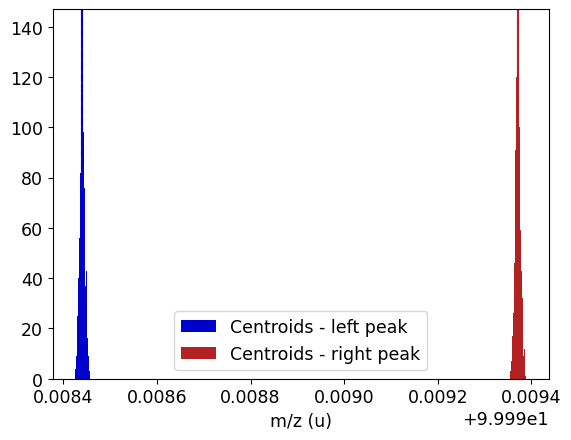

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

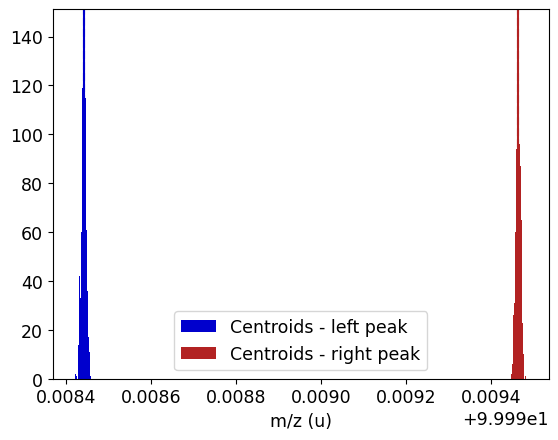

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

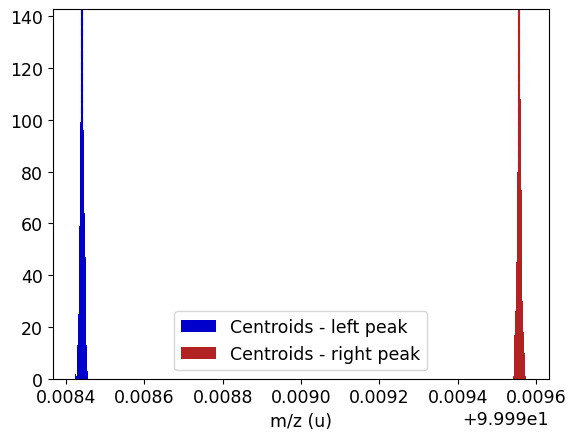

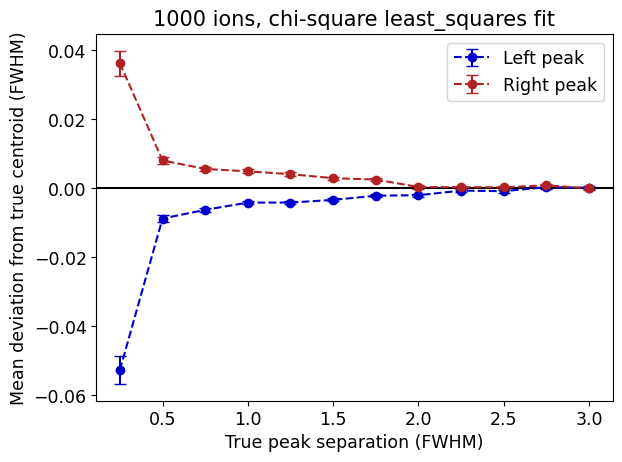

In [37]:
amps = [0.1, 0.1]
N_ions = 1000
N_bkg = 30
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 1030
Background amplitude: bkg_c = 0.6000000000005457

##### Plot example spectrum and fit #####


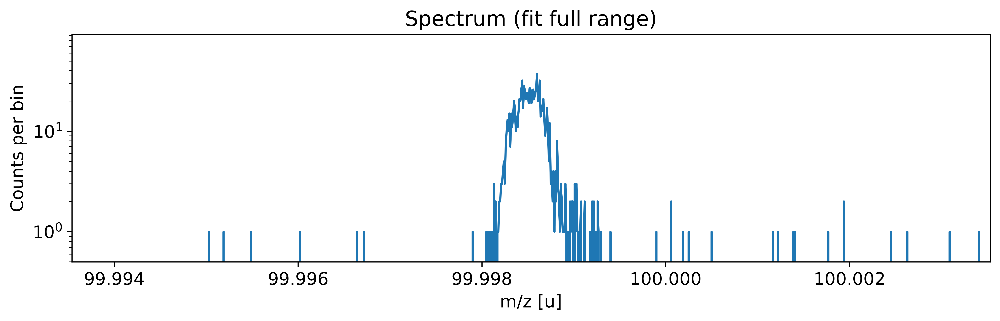

Added peak at 99.99843615788602 u
Added peak at 99.9986183201284 u


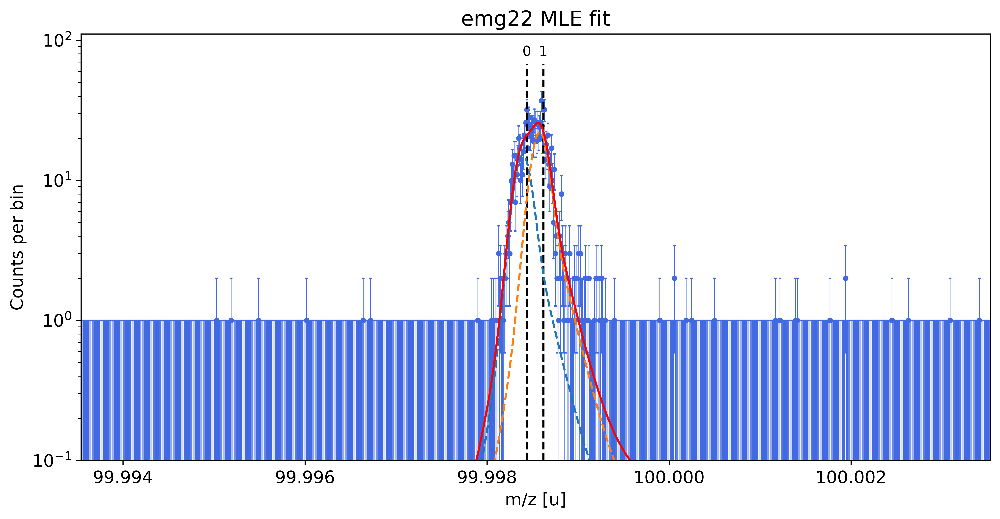

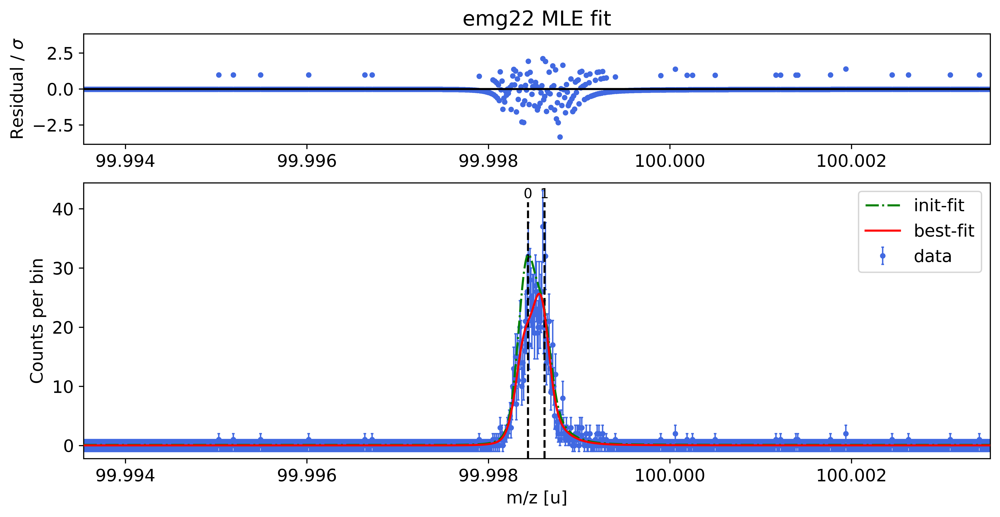

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


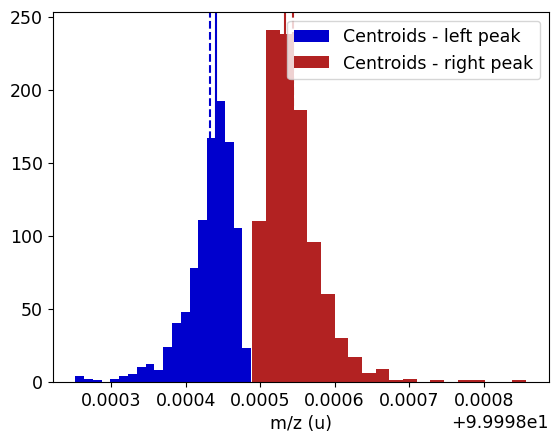

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2627: RuntimeWarning: invalid value encountered in sqrt
  ret = sqrt(NLLR)


Number of failed fits: 1


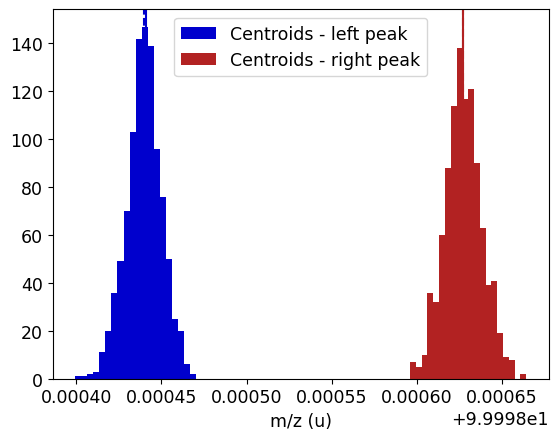

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

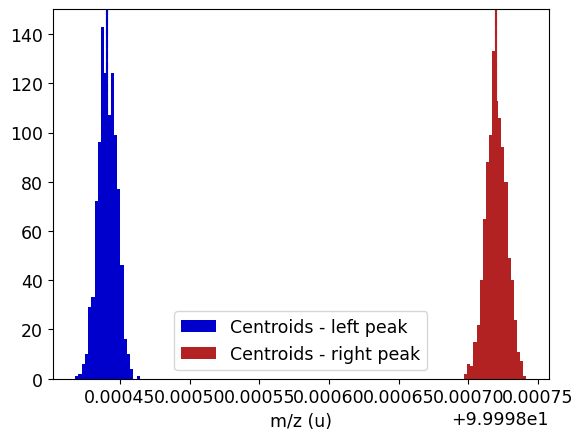

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 2 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


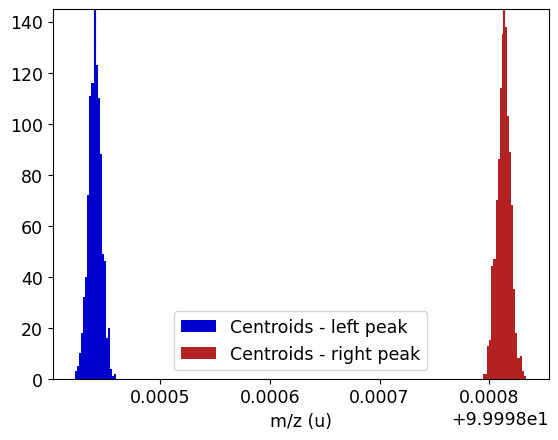

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

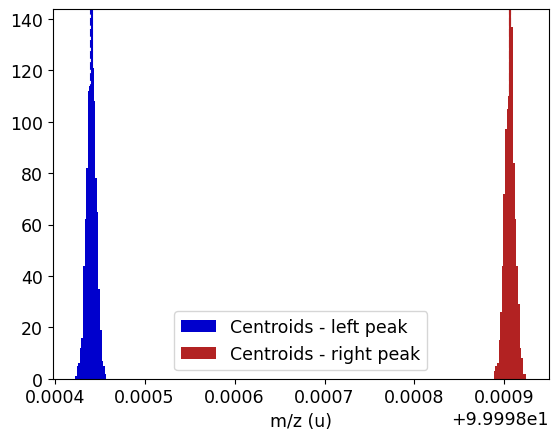

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

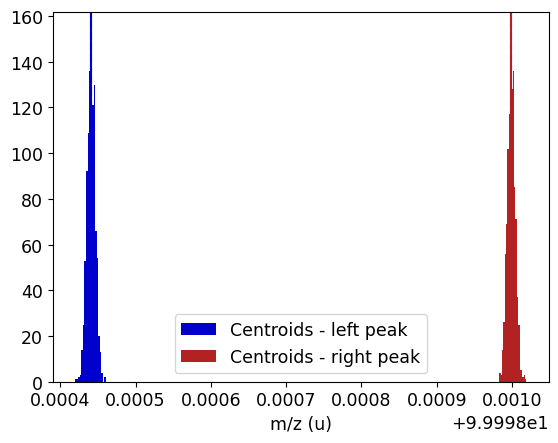

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

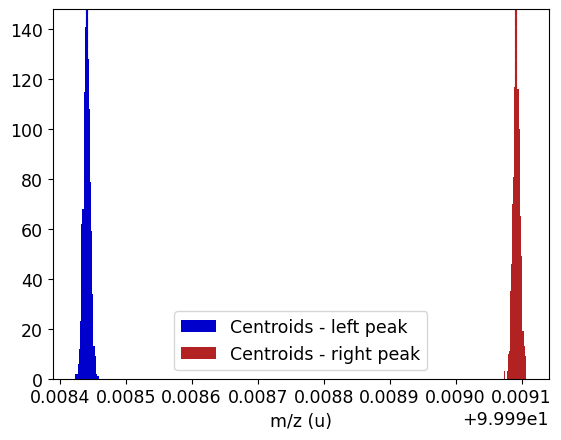

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

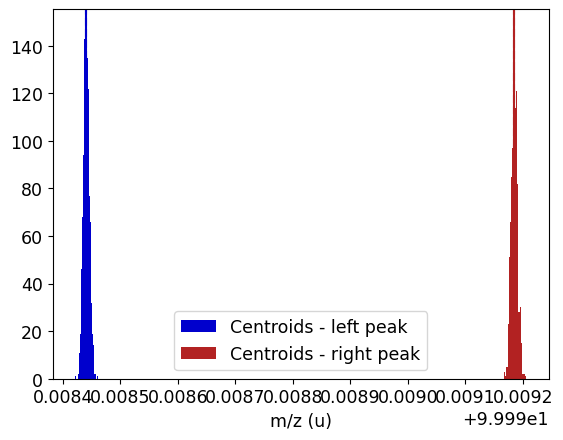

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

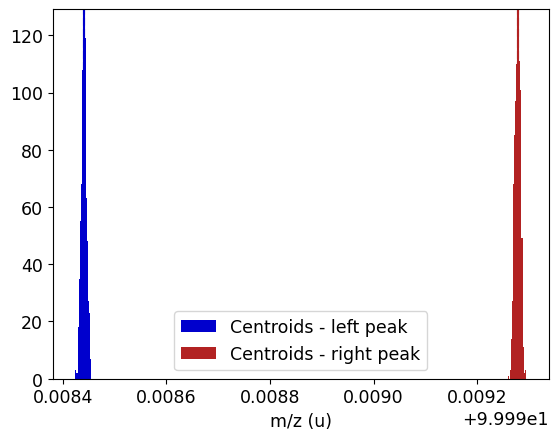

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

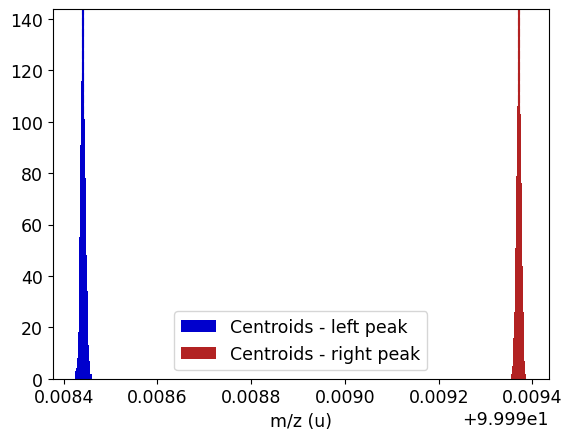

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

Number of failed fits: 2


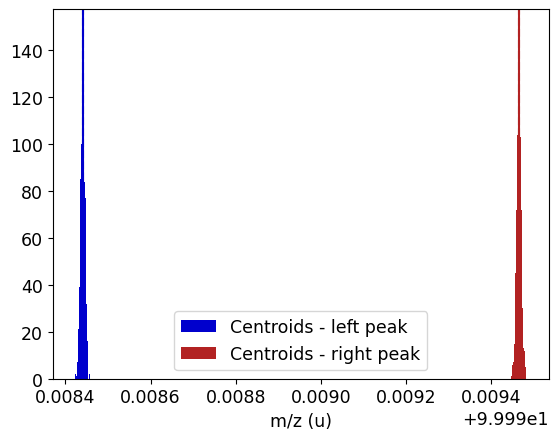

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

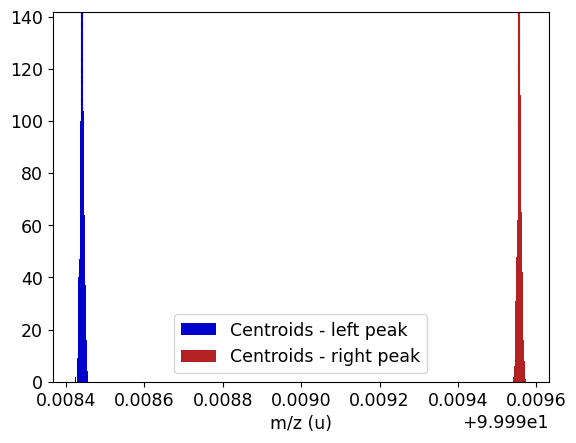

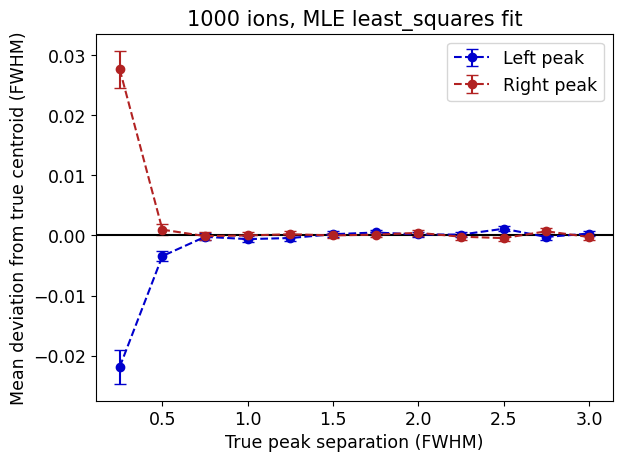

In [43]:
amps = [0.1, 0.1]
N_ions = 1000
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, Powell fit

Total event number: 1030
Background amplitude: bkg_c = 0.6000000000005457

##### Plot example spectrum and fit #####


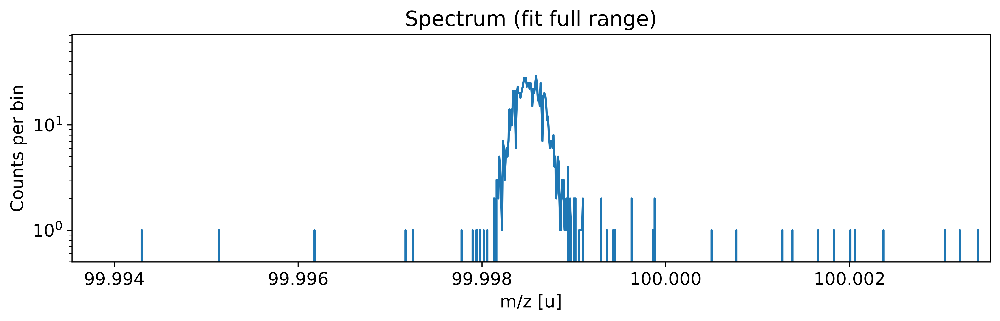

Added peak at 99.99844018893863 u
Added peak at 99.99863637974067 u


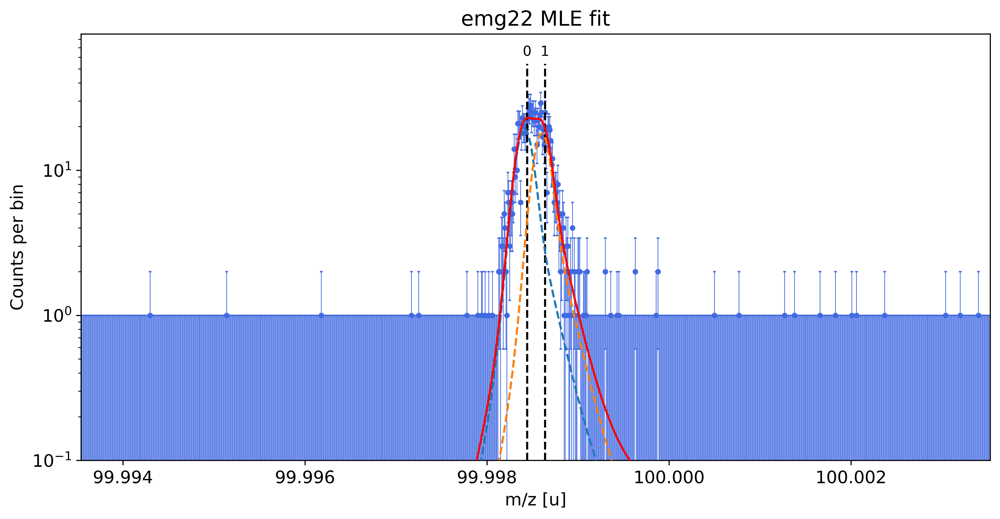

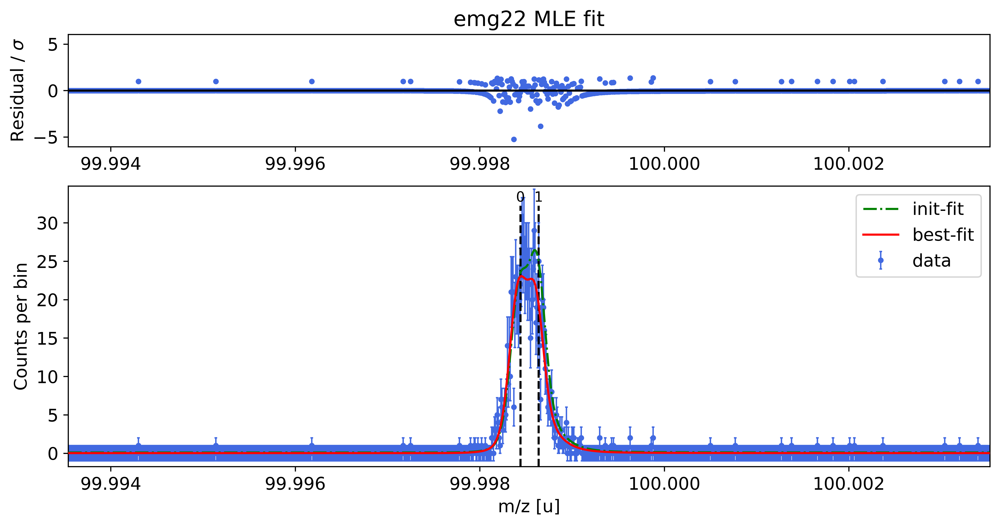

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


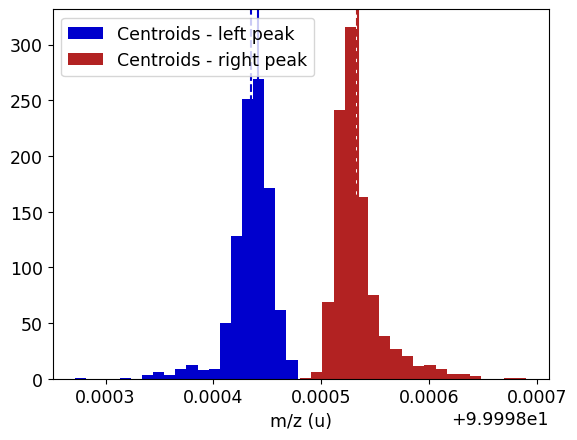

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p1_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)
/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2627: RuntimeWarning: invalid value encountered in sqrt
  ret = sqrt(NLLR)


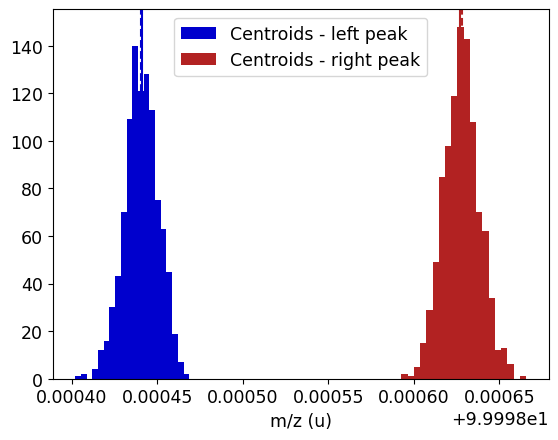

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

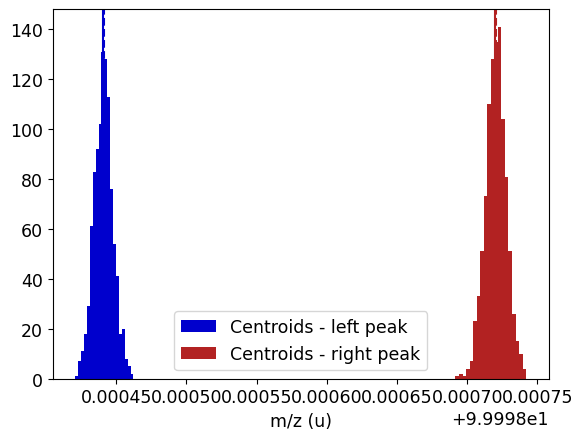

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

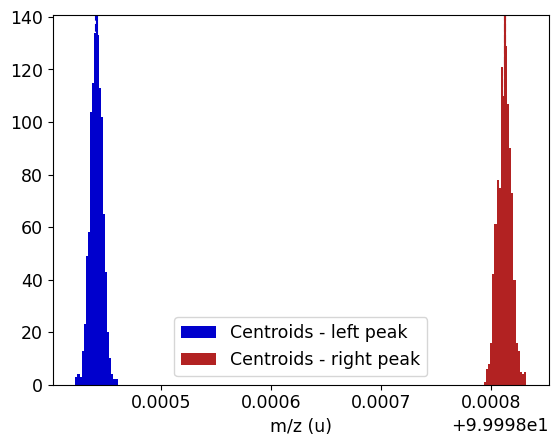

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

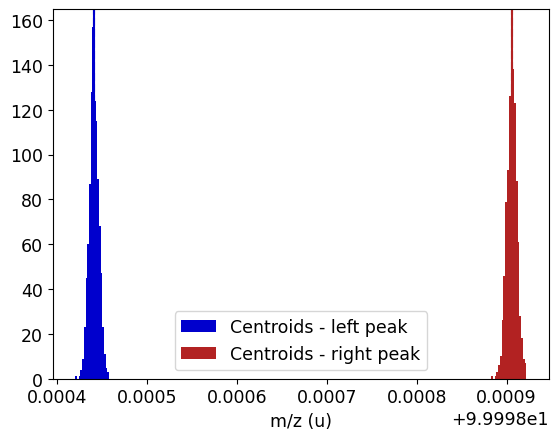

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

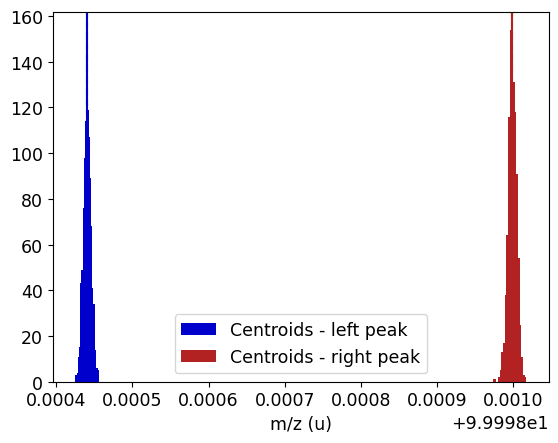

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 2 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


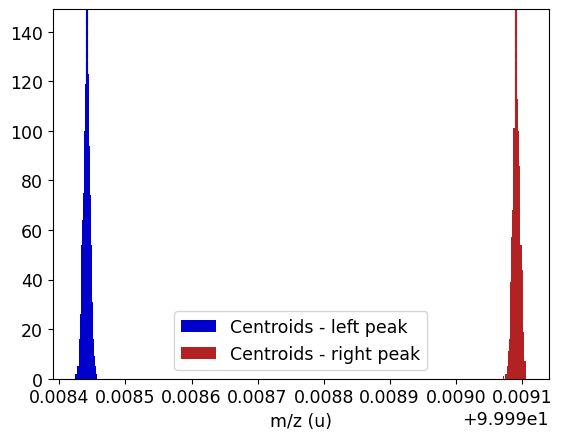

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p0_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


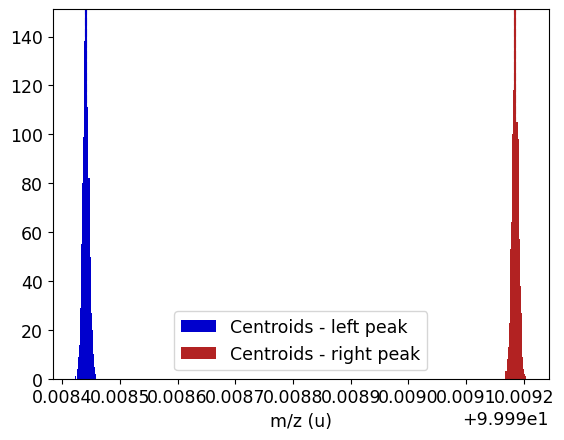

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

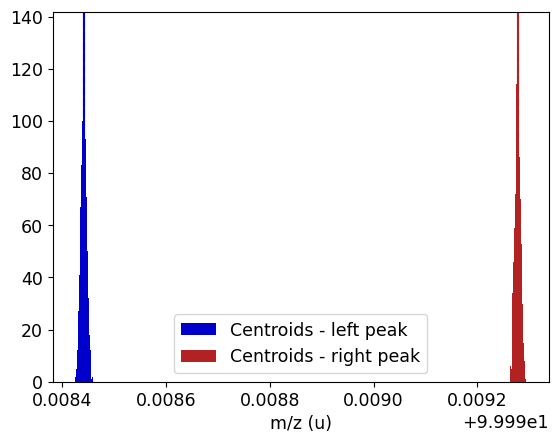

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

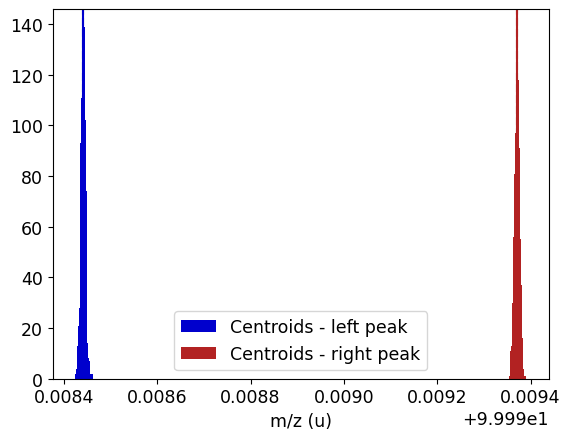

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

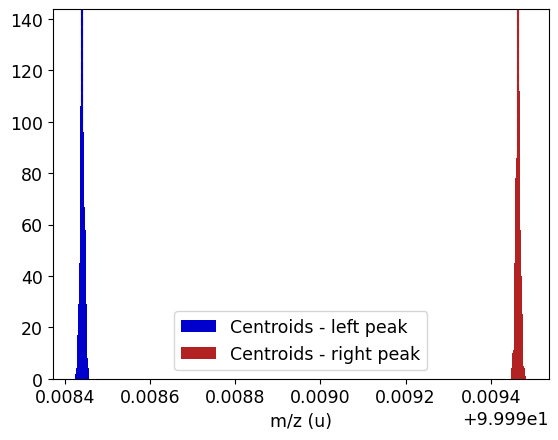

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

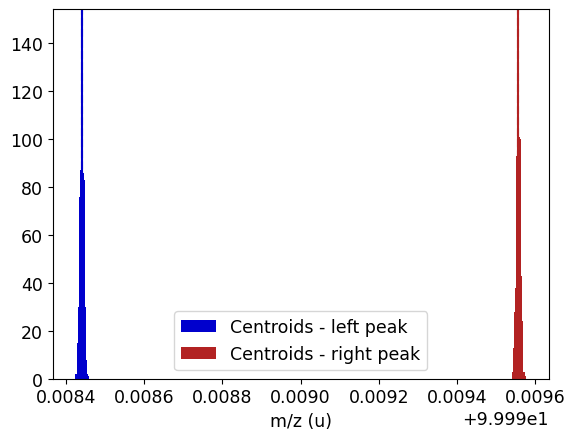

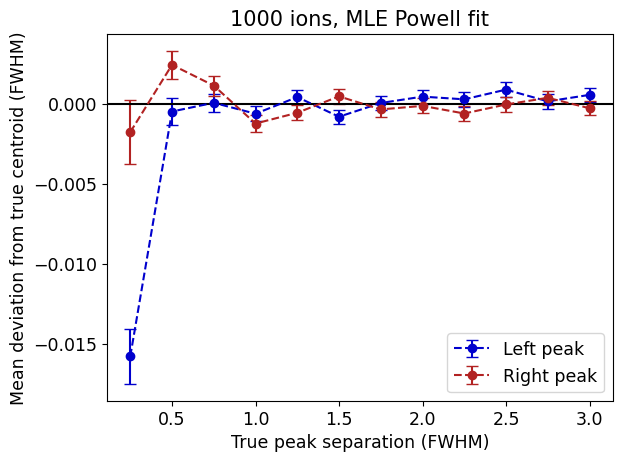

In [44]:
amps = [0.1, 0.1]
N_ions = 1000
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

# Compare different amplitude ratios

#### chi-square, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 9.000000000008189

##### Plot example spectrum and fit #####


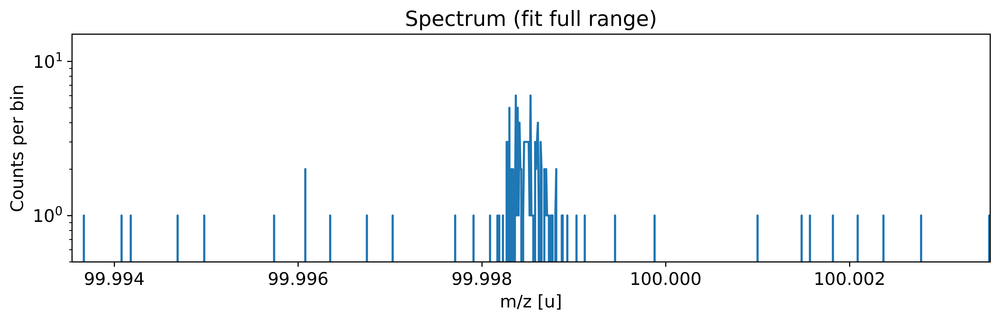

Added peak at 99.99842900281409 u
Added peak at 99.99862861282038 u


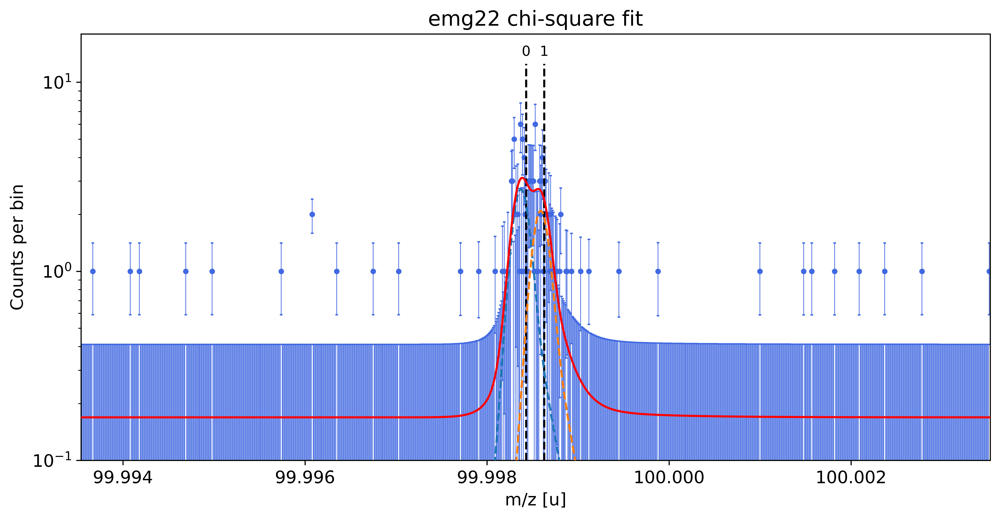

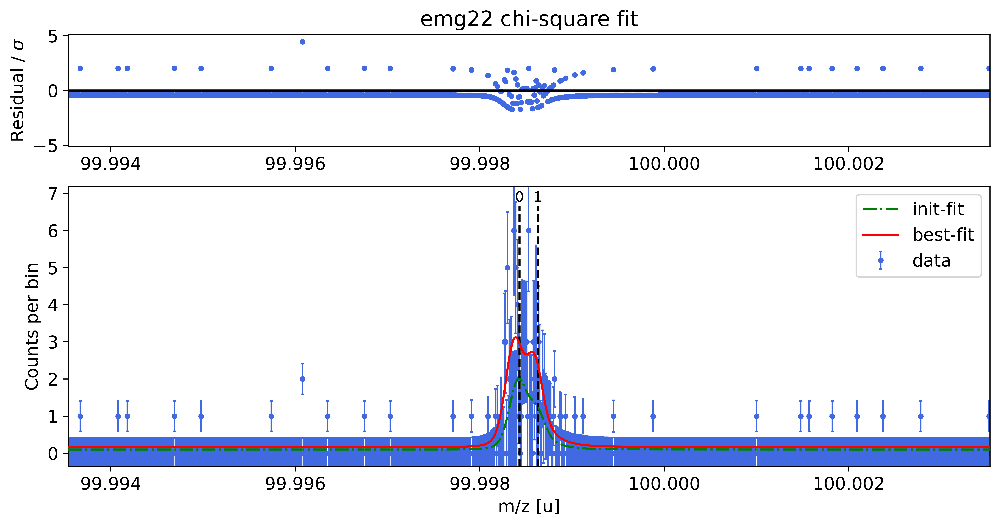

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


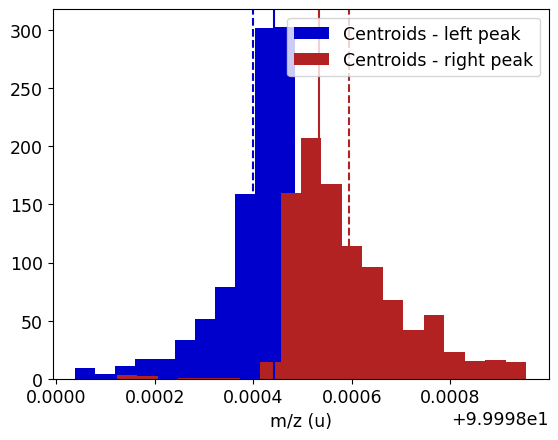

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

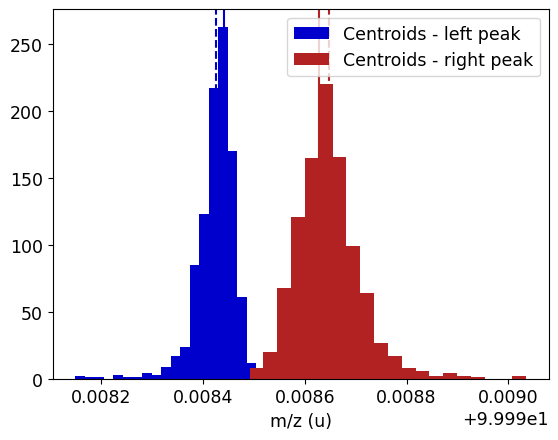

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

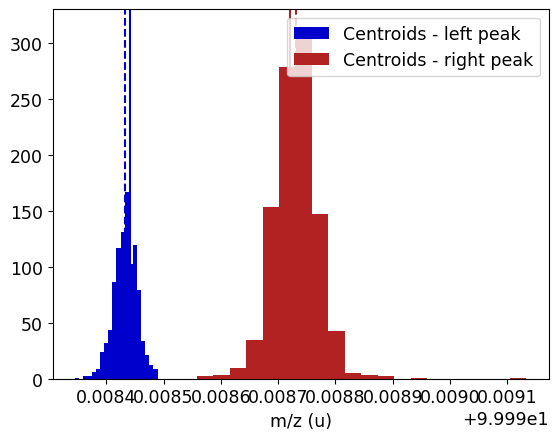

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

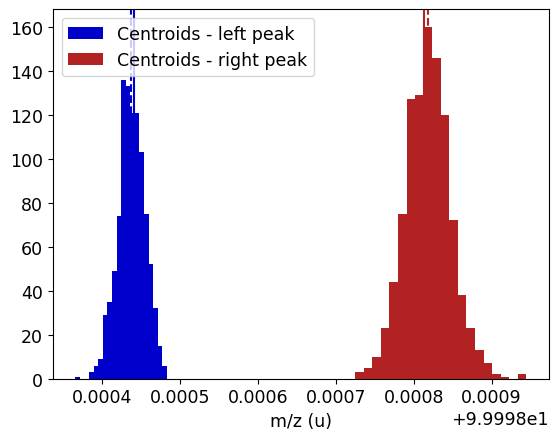

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

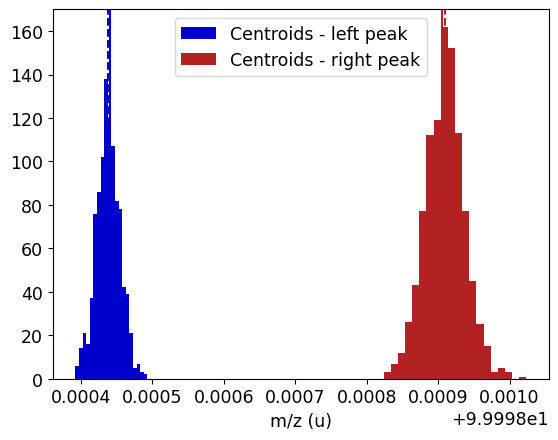

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

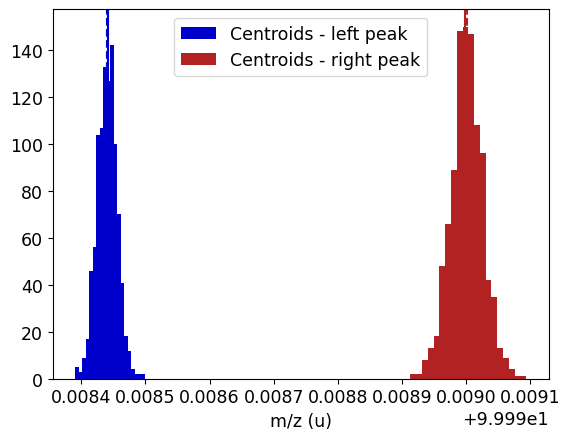

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

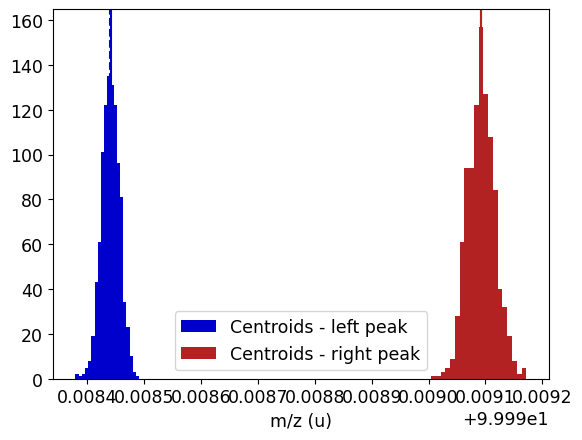

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

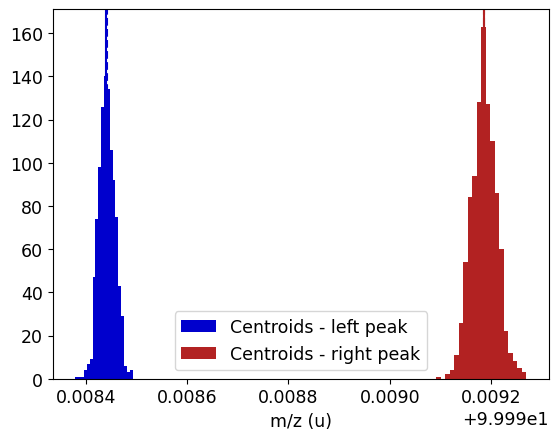

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

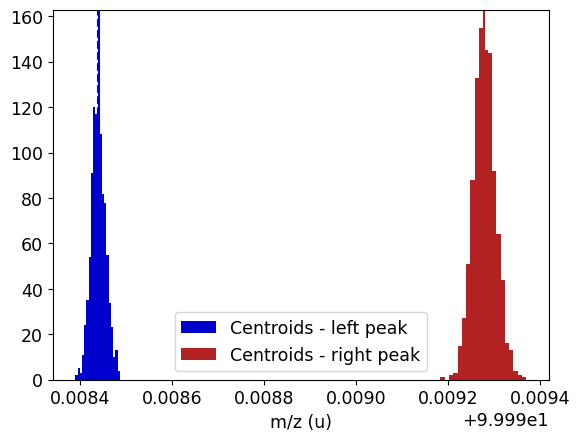

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

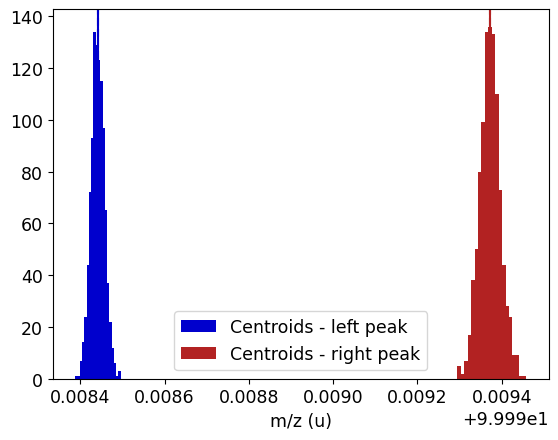

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

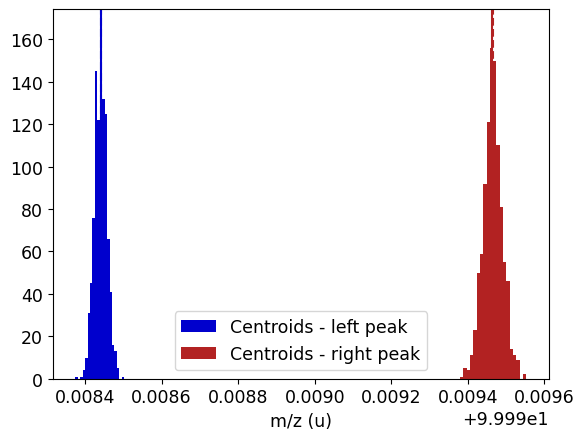

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

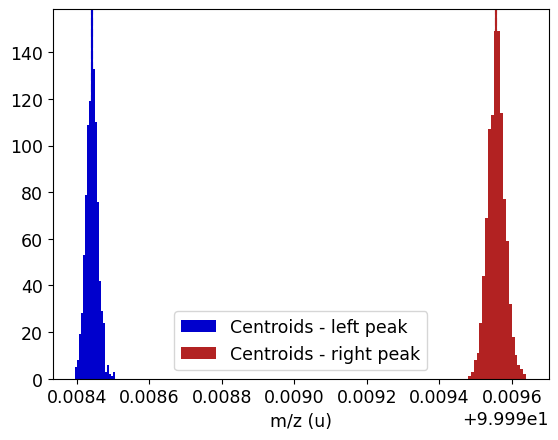

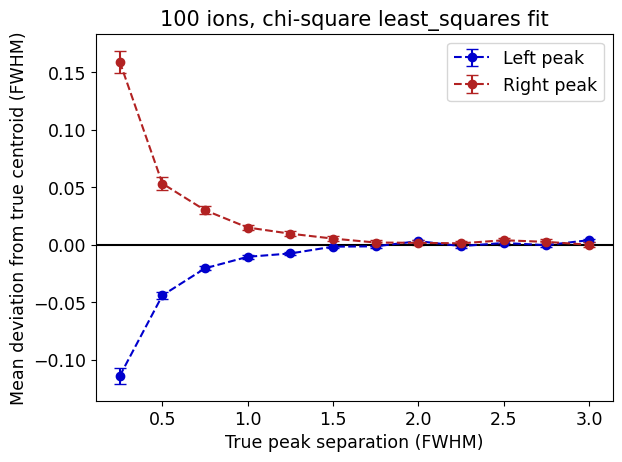

In [45]:
amps = [0.2, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 9.000000000008189

##### Plot example spectrum and fit #####


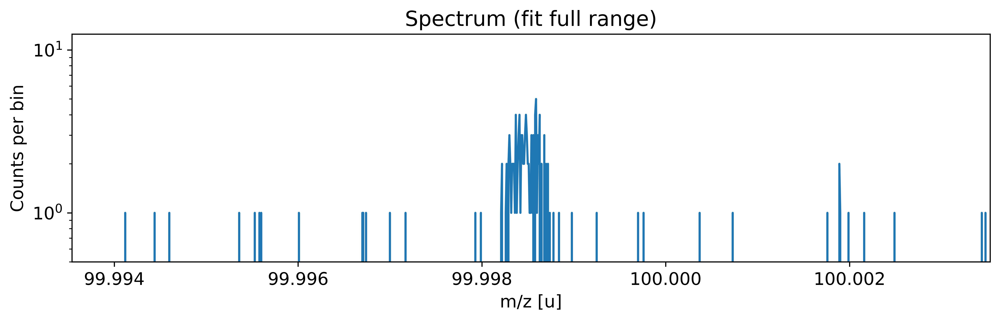

Added peak at 99.9984372781244 u
Added peak at 99.99862155526476 u


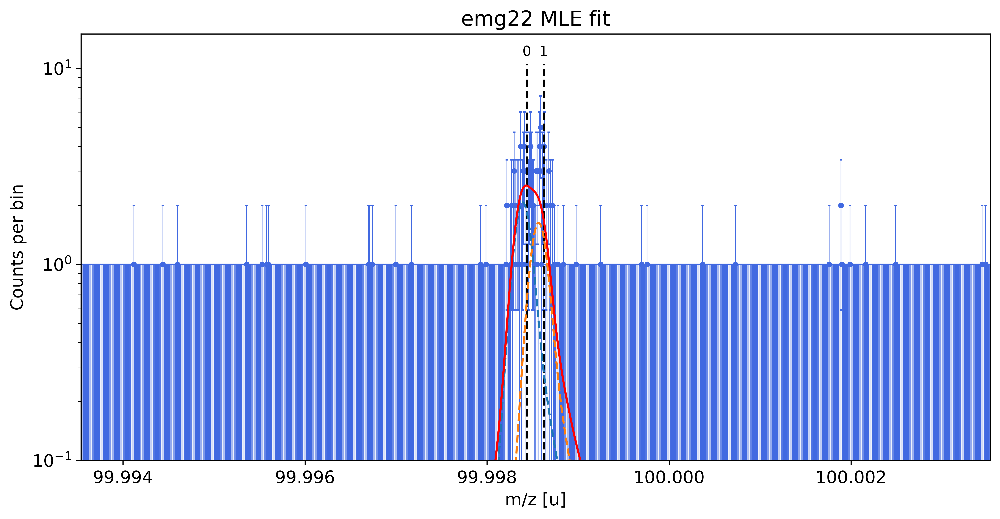

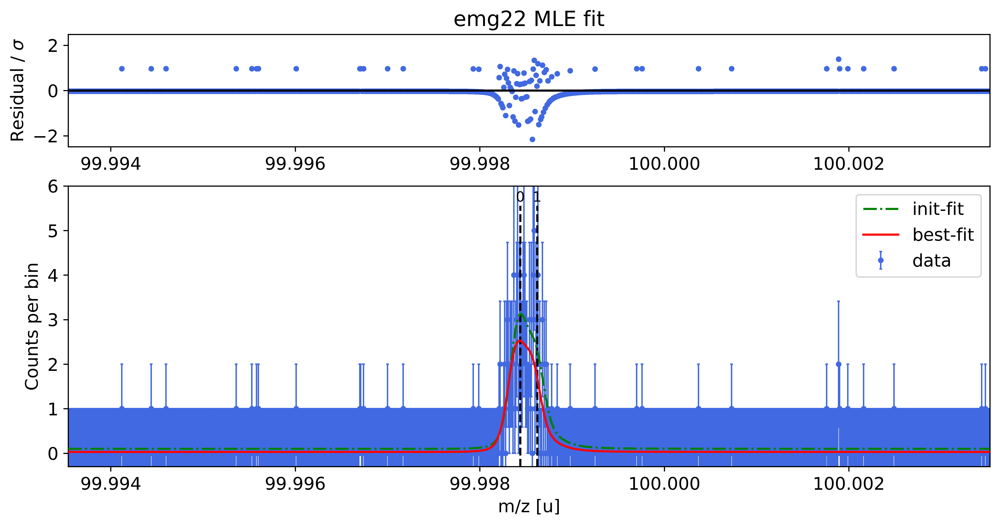

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


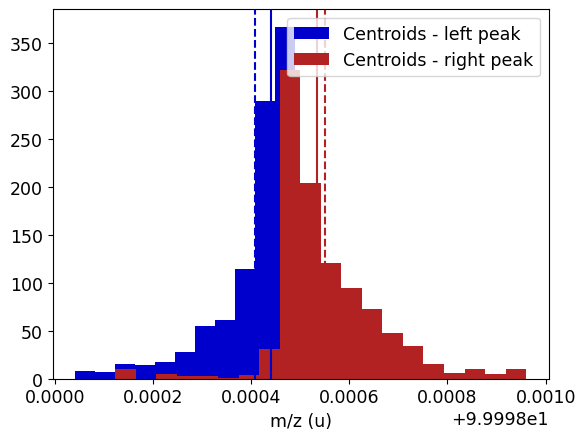

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

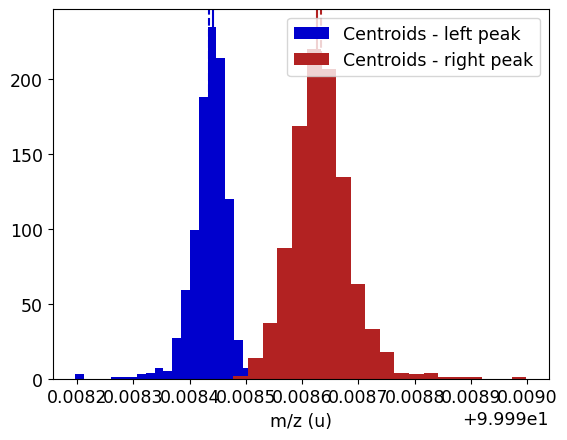

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

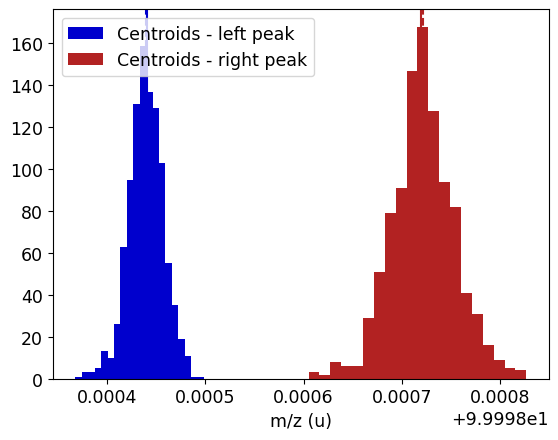

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

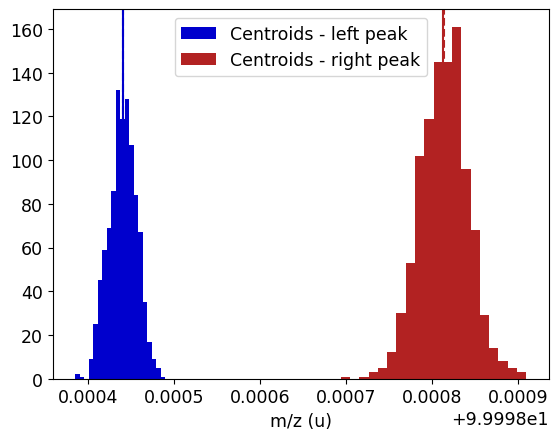

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

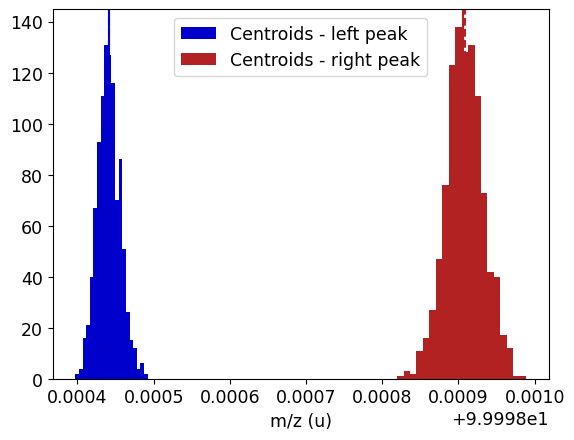

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

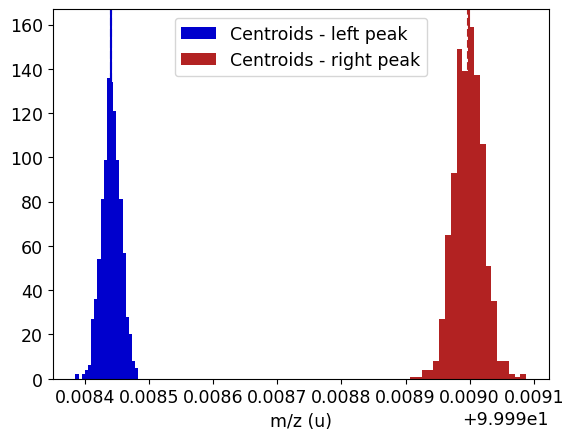

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

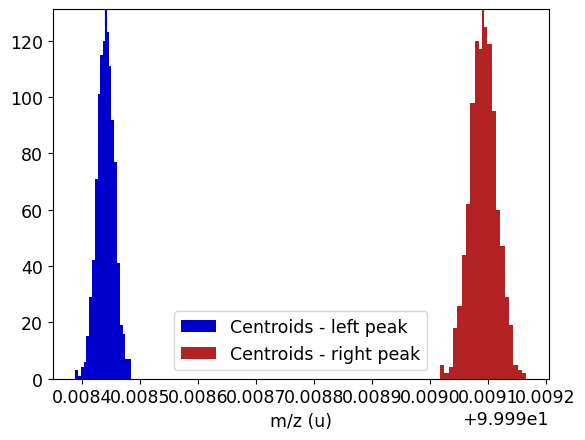

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

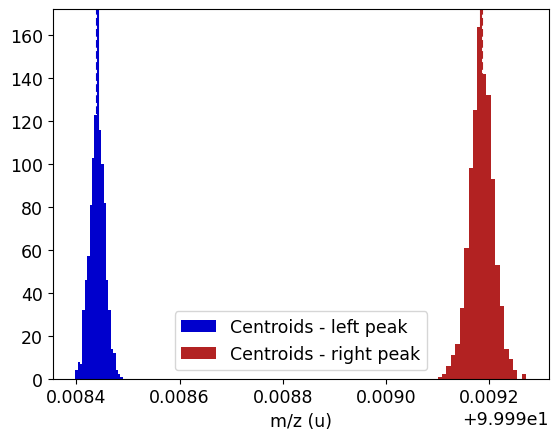

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

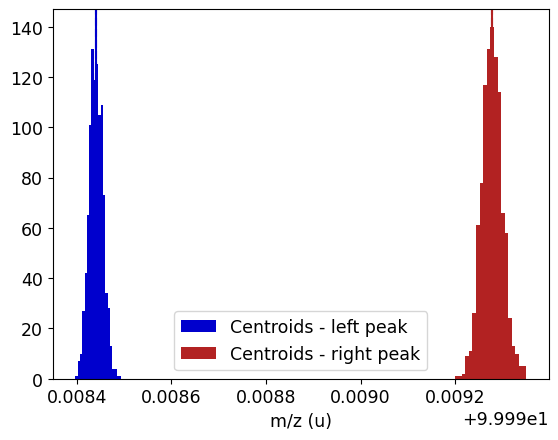

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

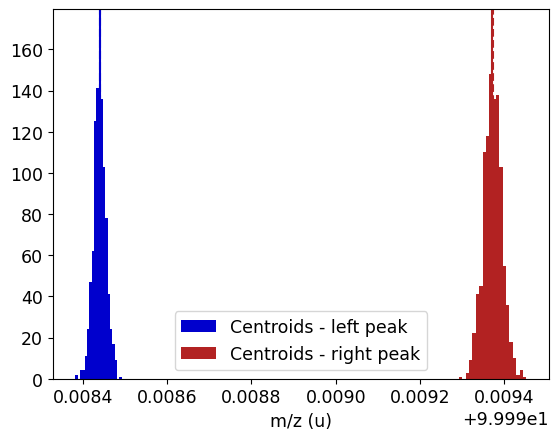

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

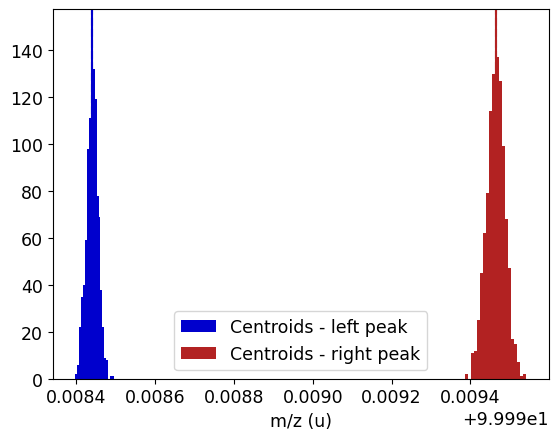

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

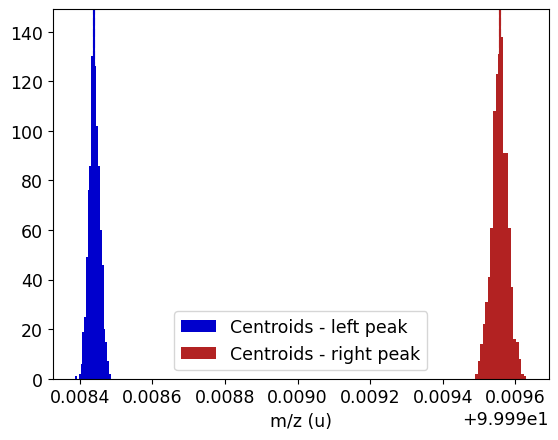

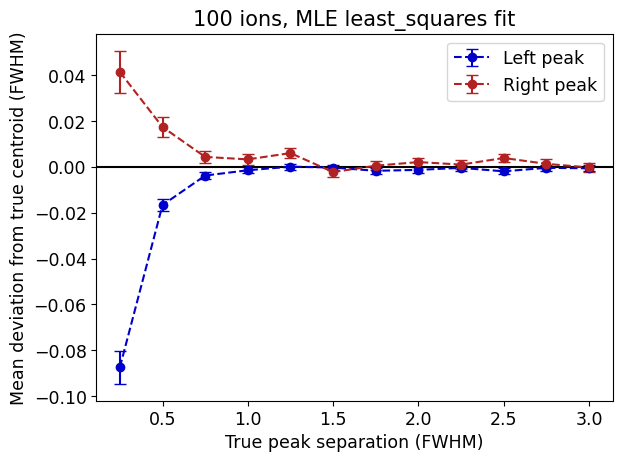

In [46]:
amps = [0.2, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, Powell fit

Total event number: 130
Background amplitude: bkg_c = 9.000000000008189

##### Plot example spectrum and fit #####


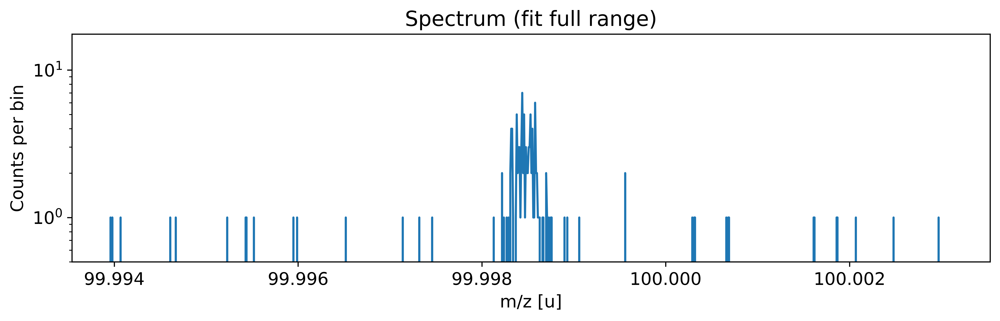

Added peak at 99.99845175166675 u
Added peak at 99.99862932916851 u


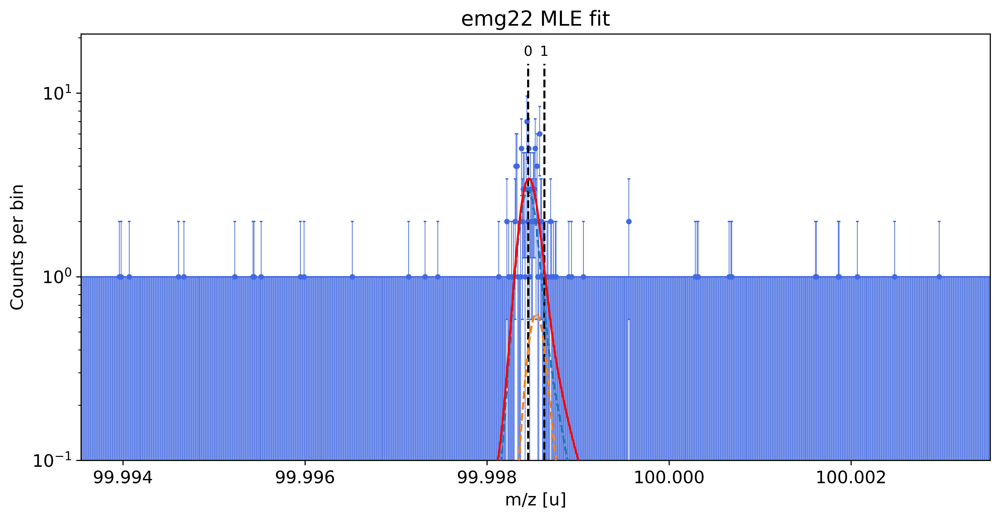

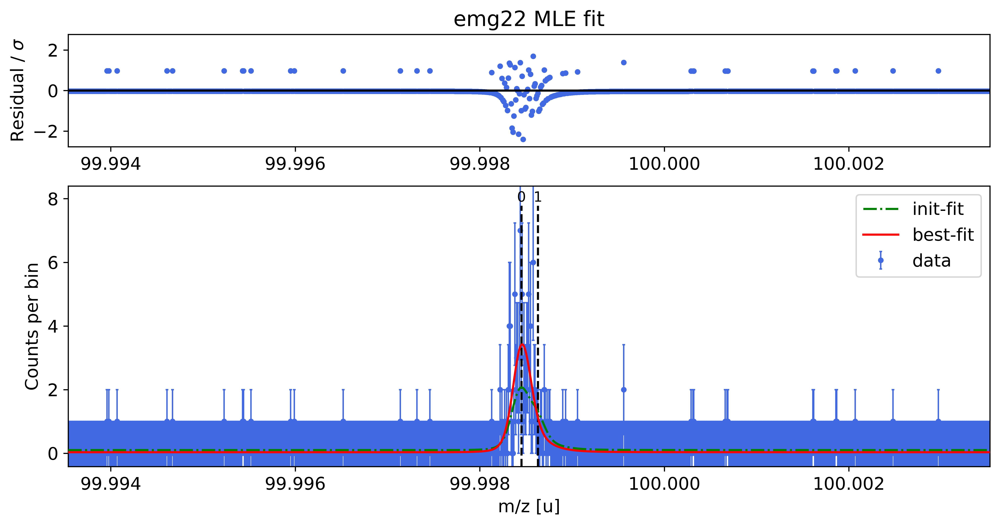

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


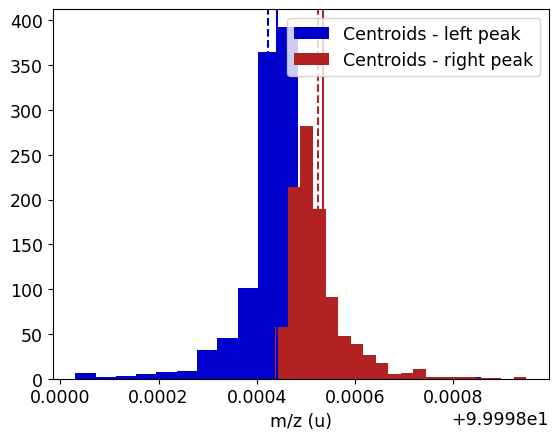

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

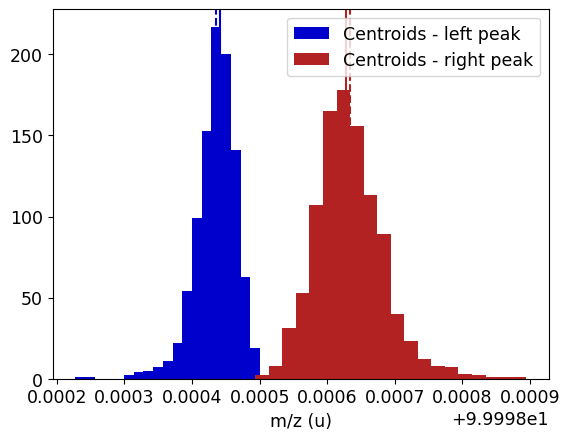

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

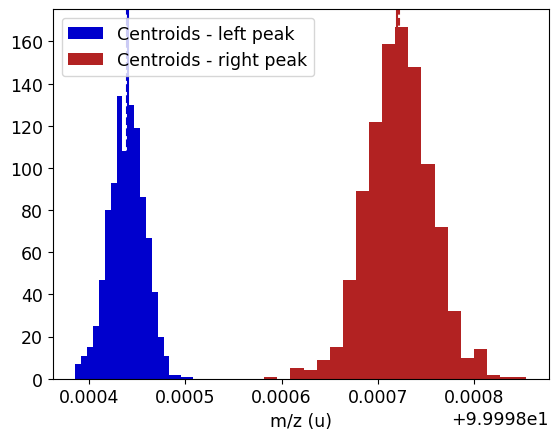

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

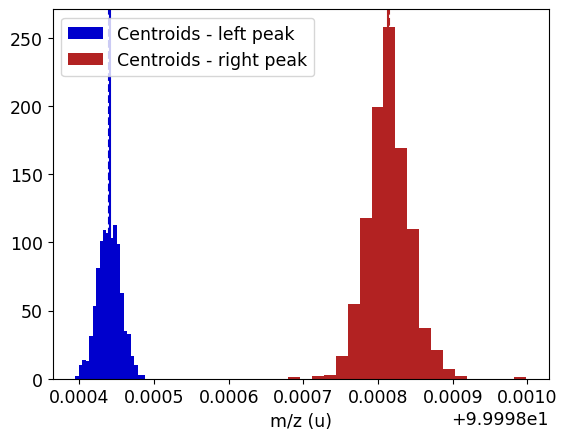

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

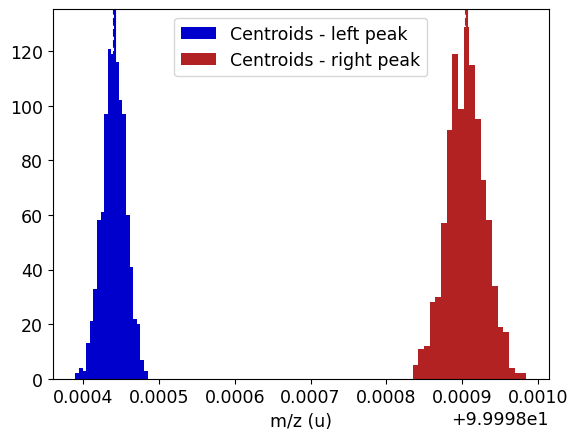

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

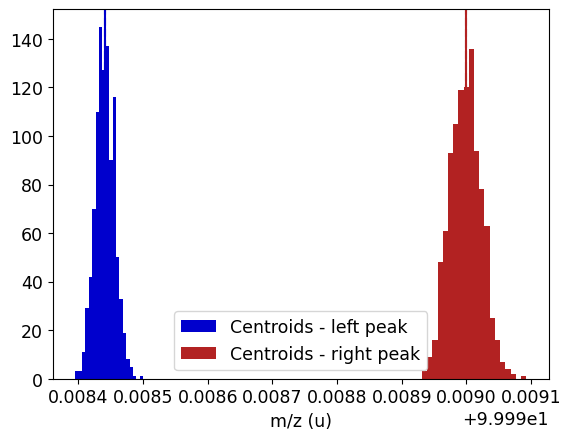

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

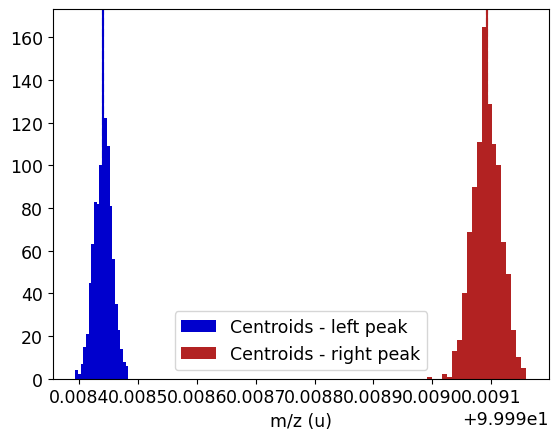

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

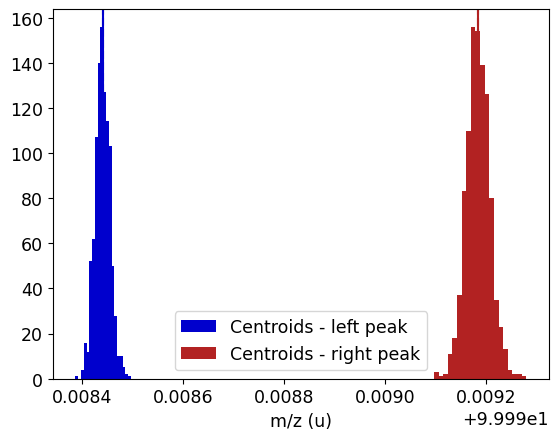

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

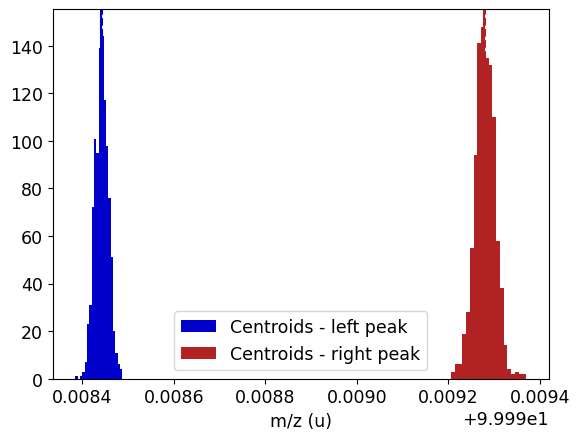

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

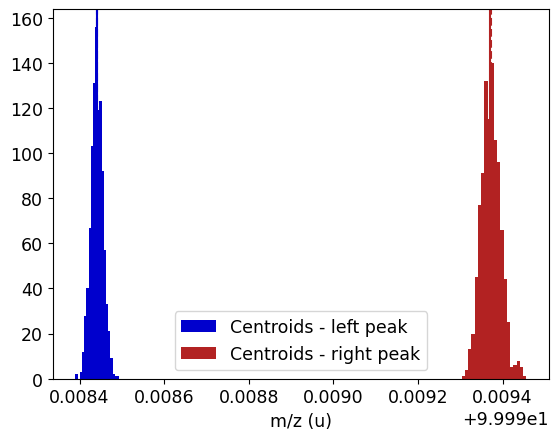

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p1_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


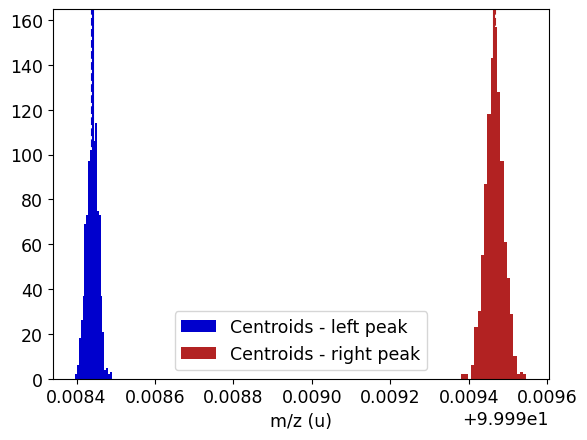

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

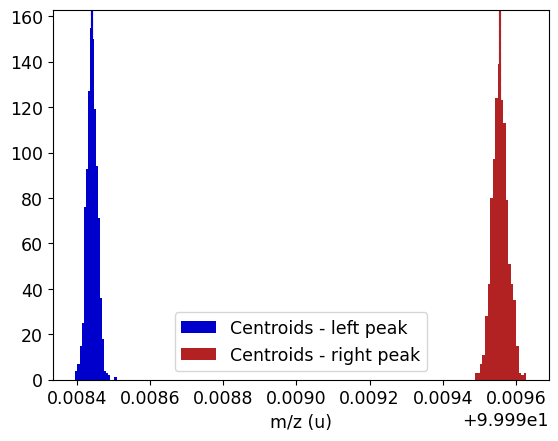

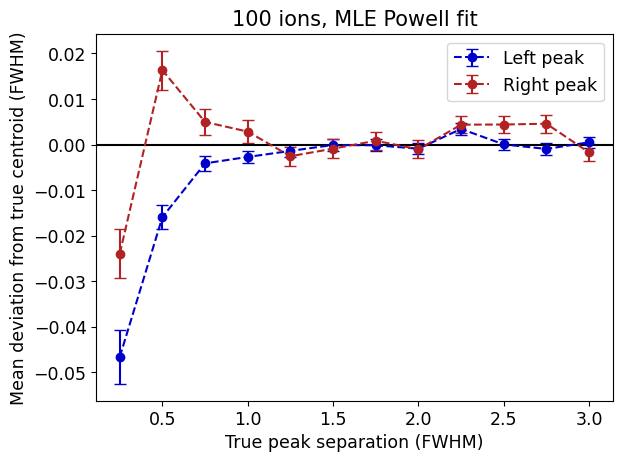

In [47]:
amps = [0.2, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### chi-square, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 12.000000000010907

##### Plot example spectrum and fit #####


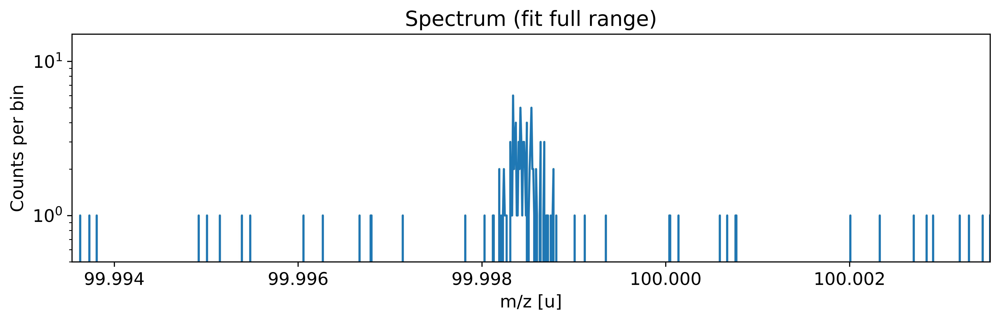

Added peak at 99.99844311179595 u
Added peak at 99.998627871391 u


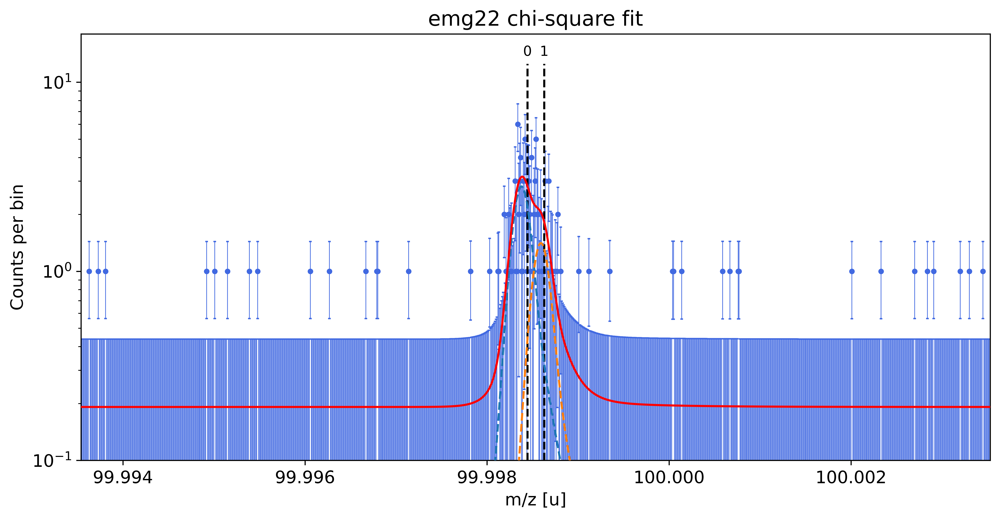

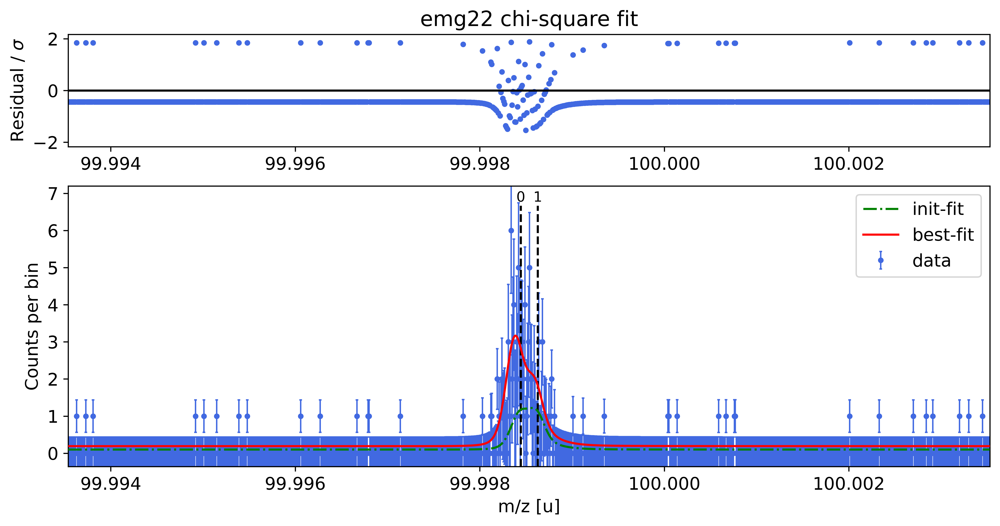

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


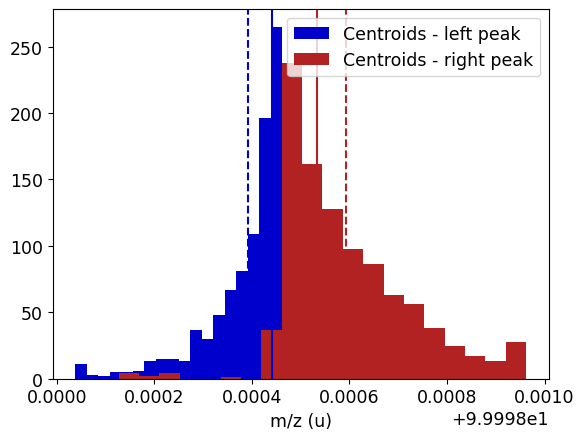

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

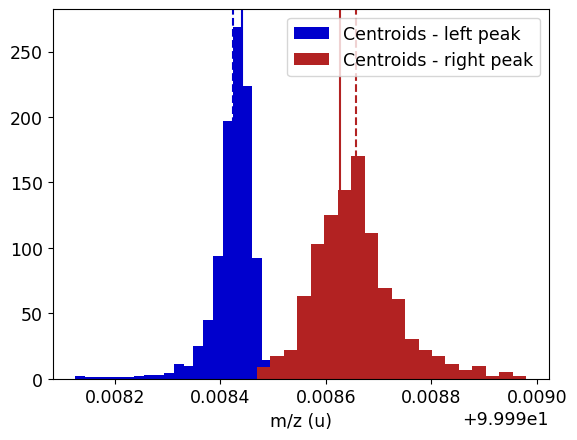

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

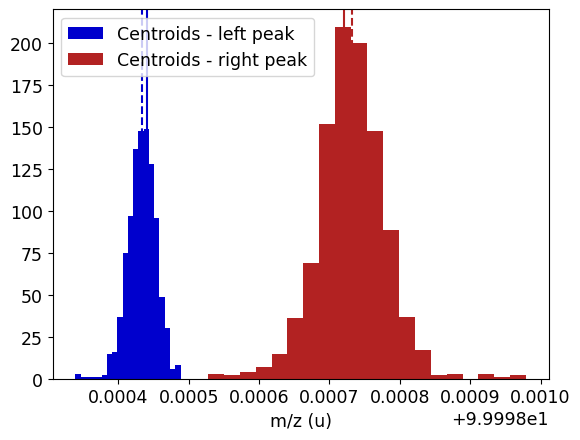

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

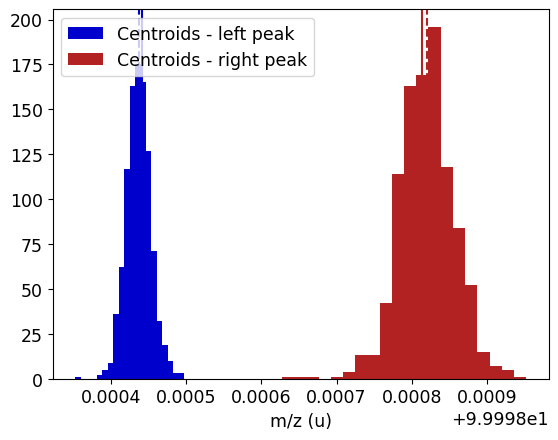

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

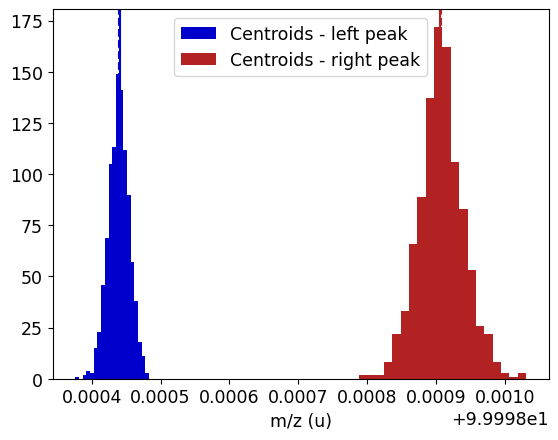

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

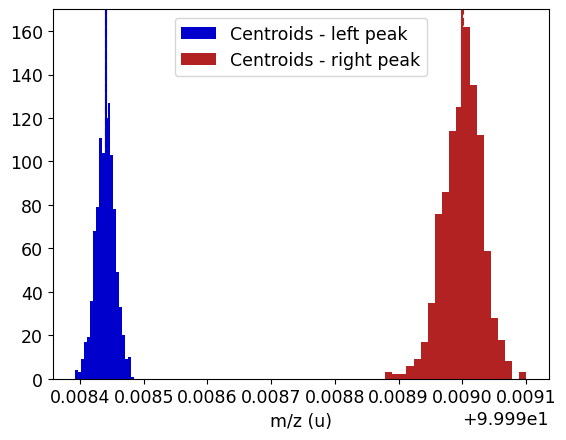

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

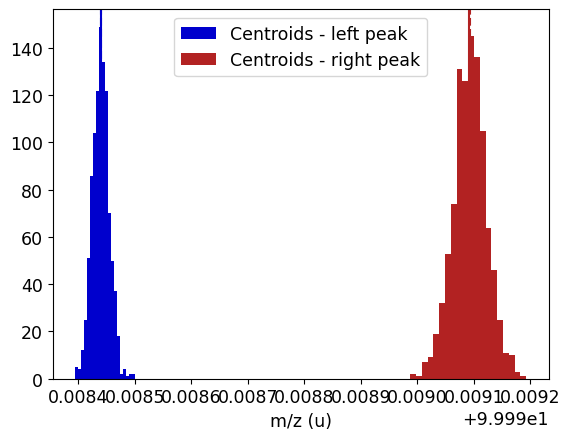

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

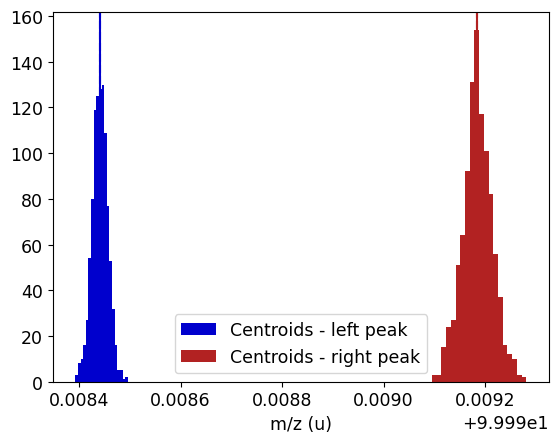

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

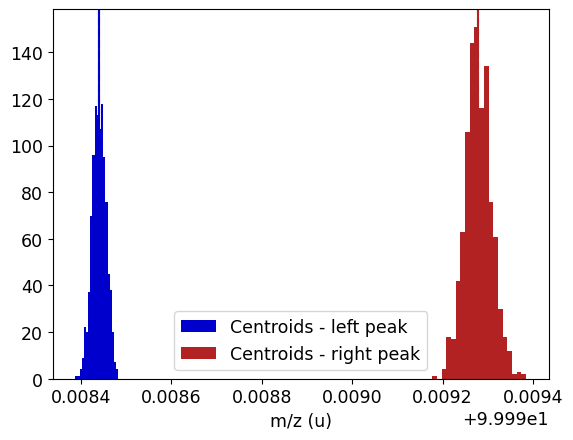

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

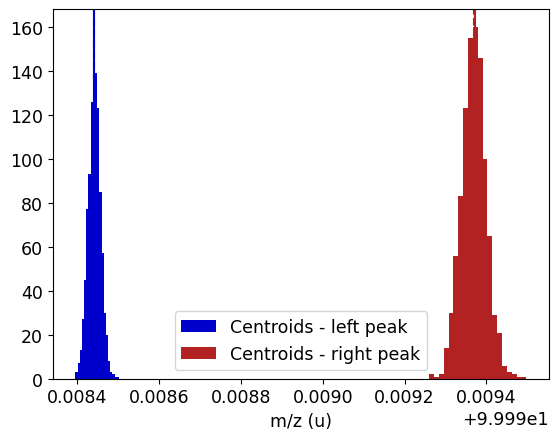

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

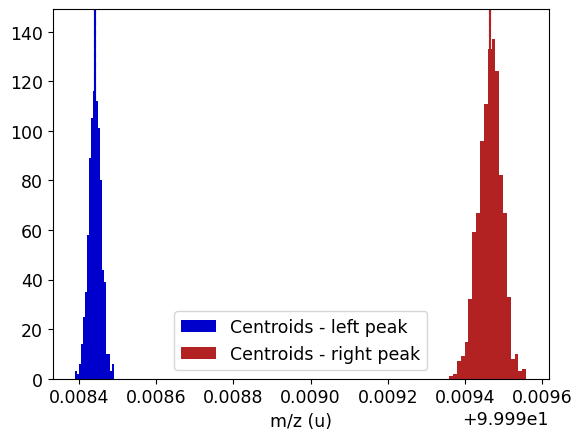

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

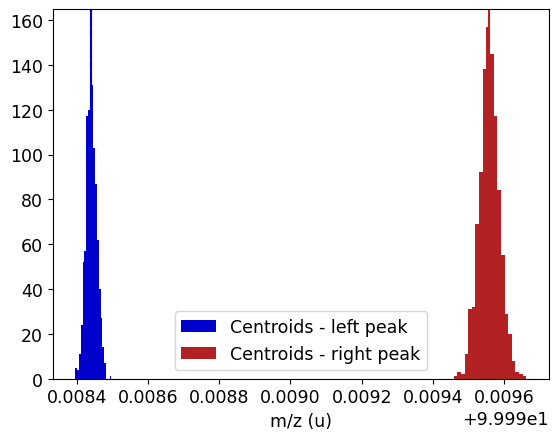

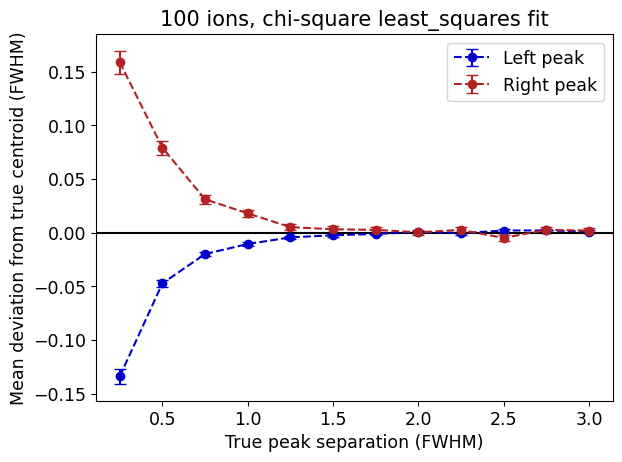

In [48]:
amps = [0.3, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 130
Background amplitude: bkg_c = 12.000000000010907

##### Plot example spectrum and fit #####


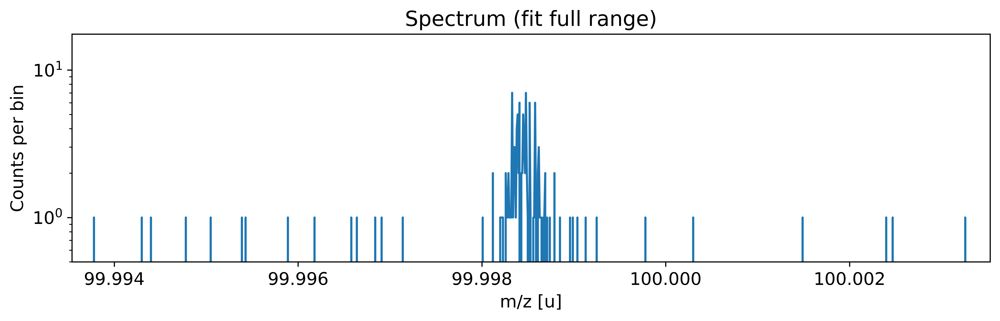

Added peak at 99.99843978350219 u
Added peak at 99.99861126666757 u


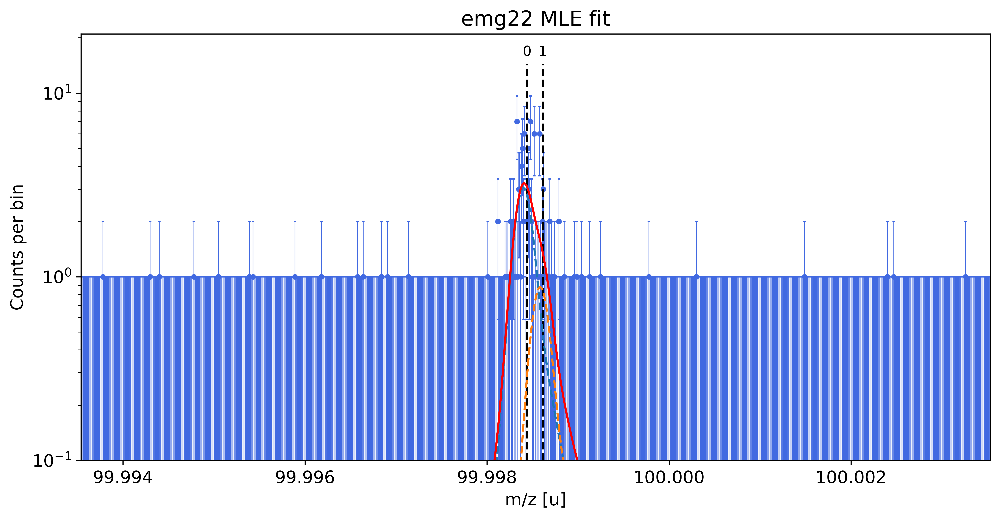

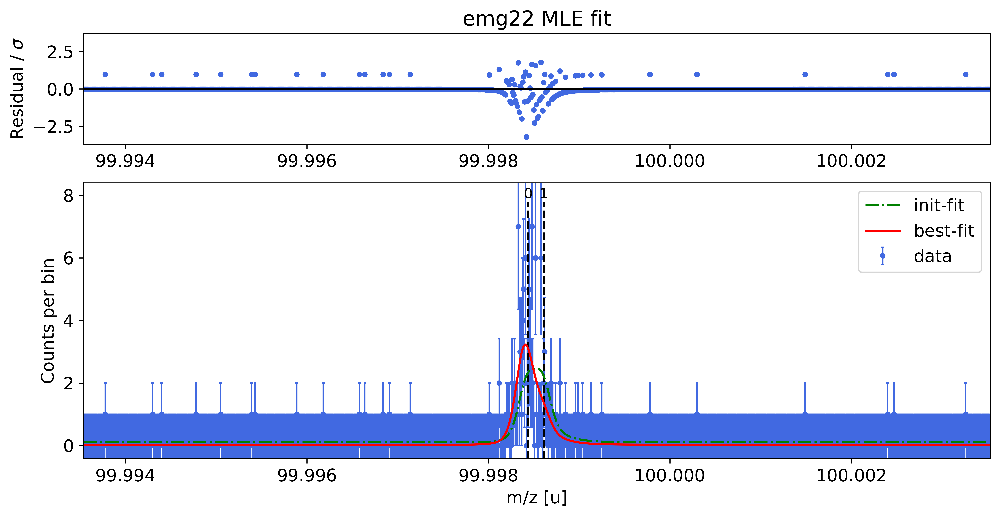

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


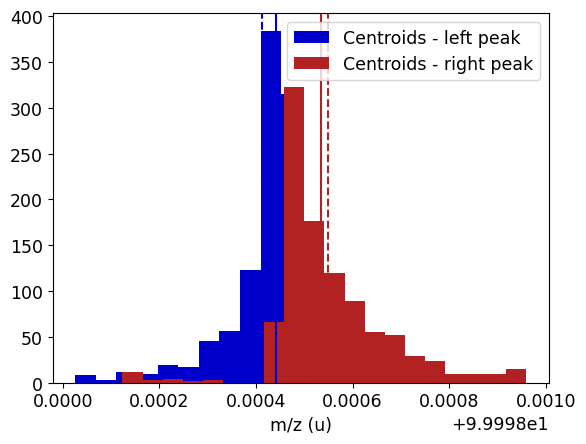

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

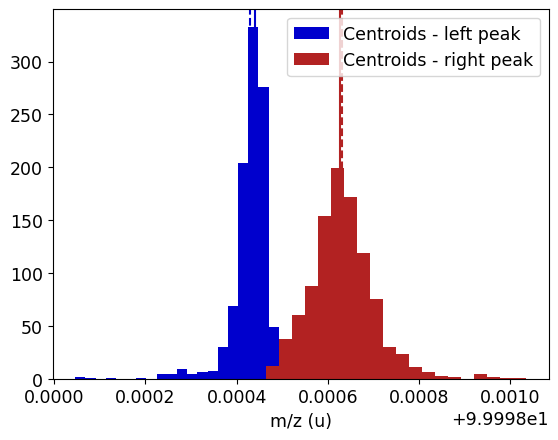

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

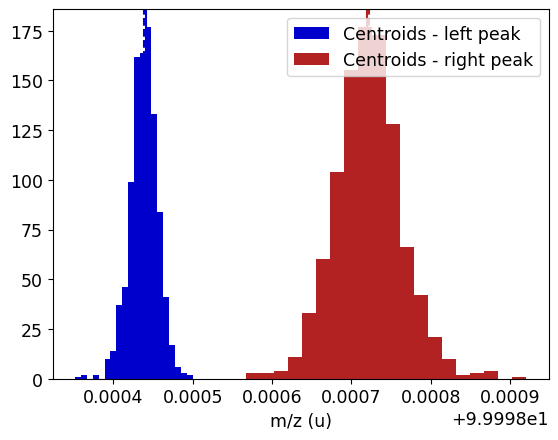

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

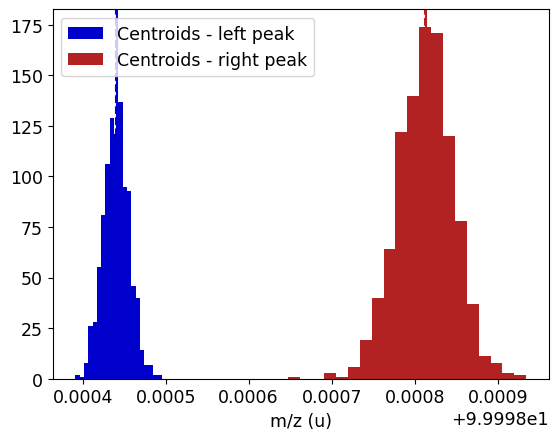

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

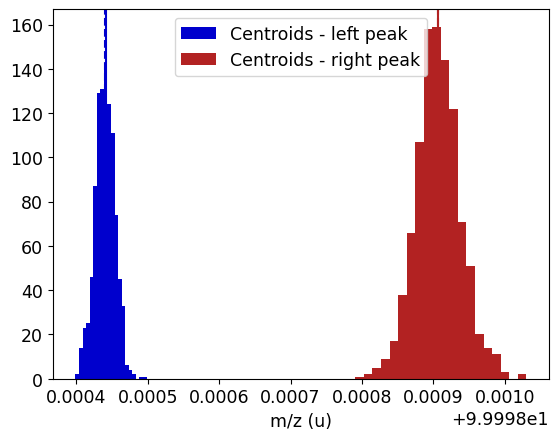

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

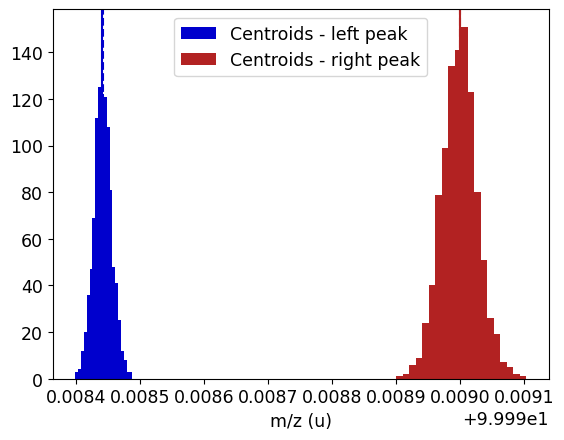

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

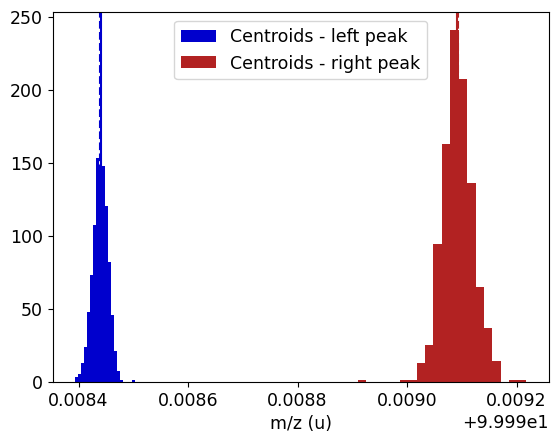

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

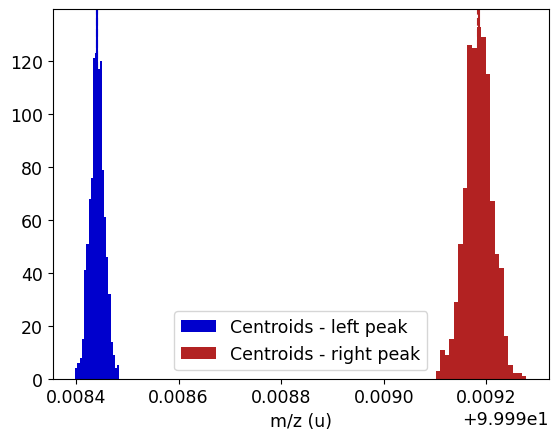

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

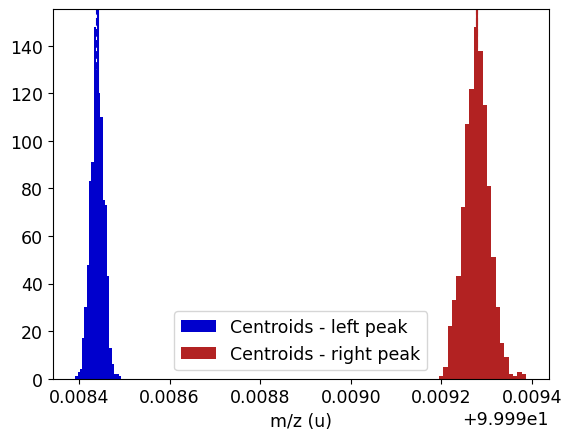

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

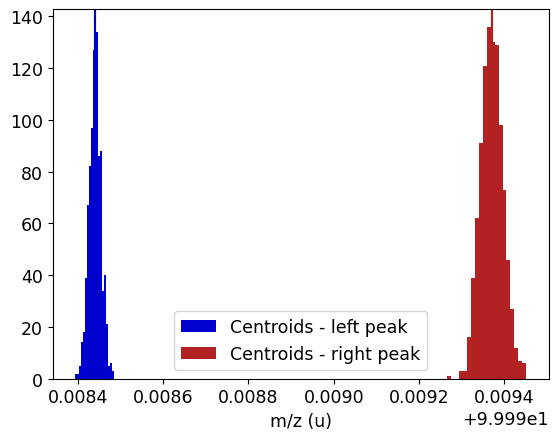

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

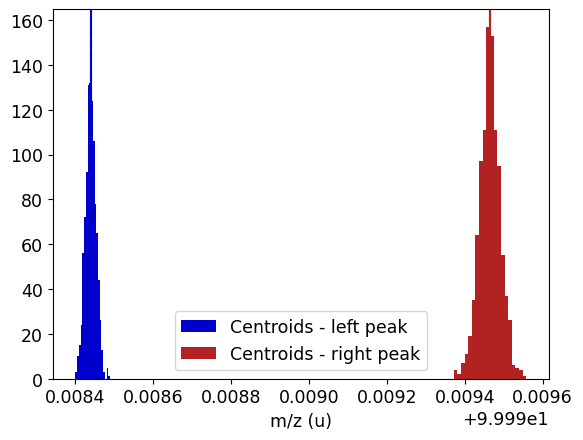

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

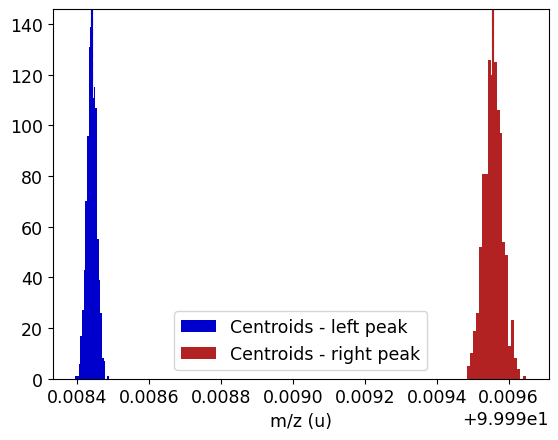

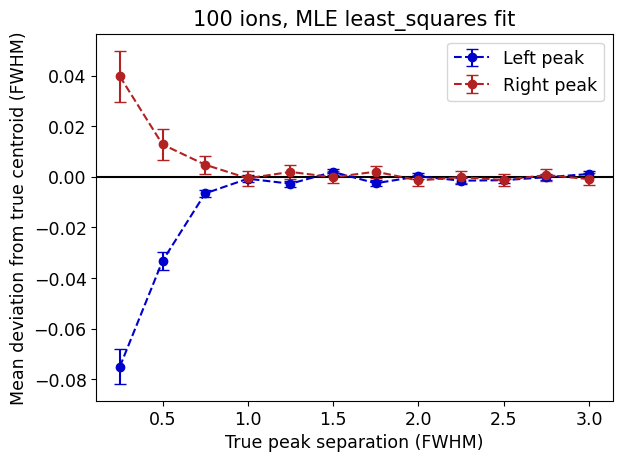

In [9]:
amps = [0.3, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, Powell fit

Total event number: 130
Background amplitude: bkg_c = 12.000000000010907

##### Plot example spectrum and fit #####


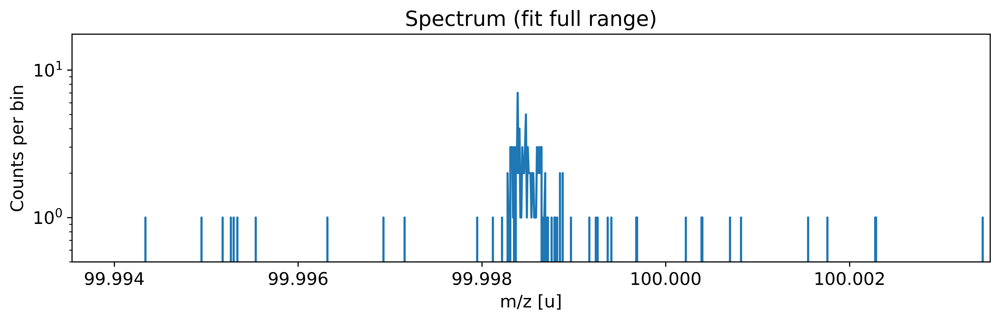

Added peak at 99.99844518014596 u
Added peak at 99.99862248057772 u


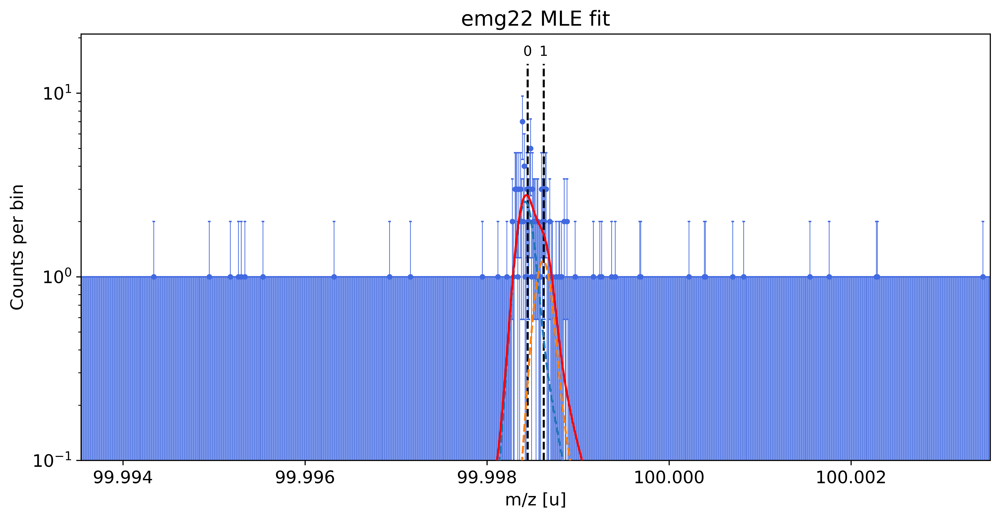

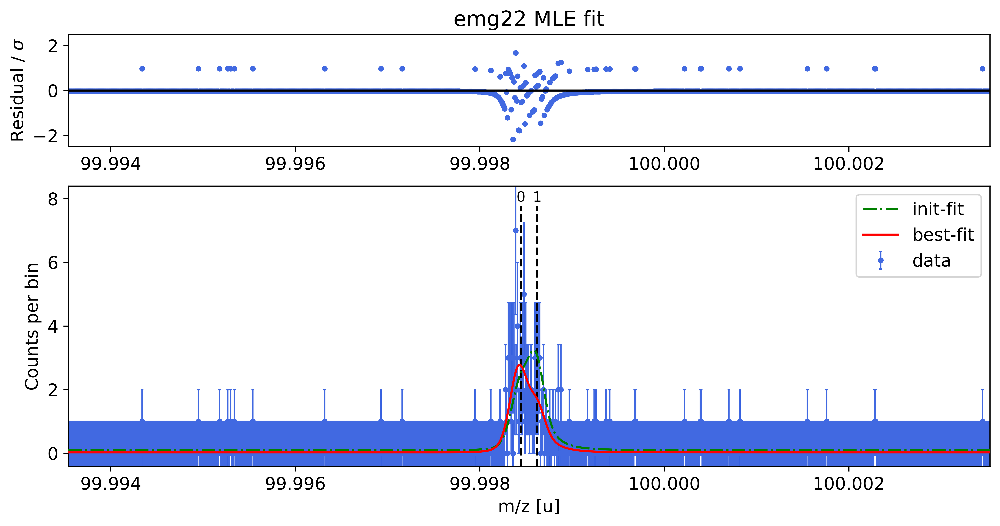

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

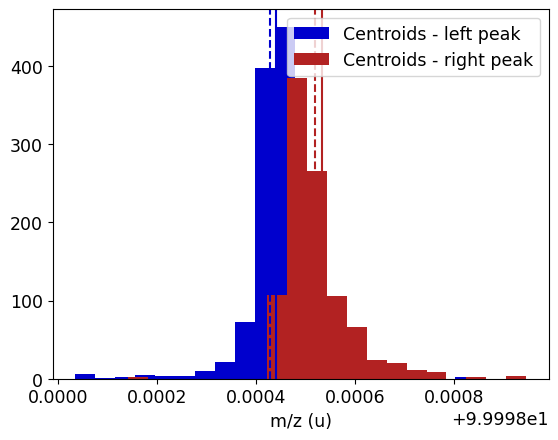

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

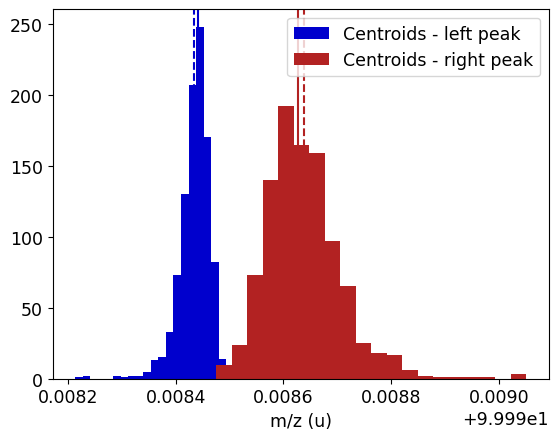

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


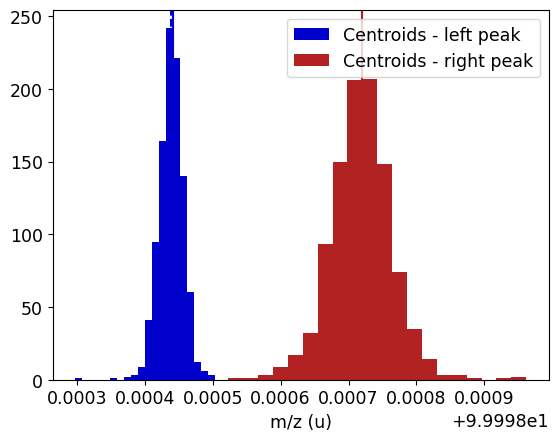

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

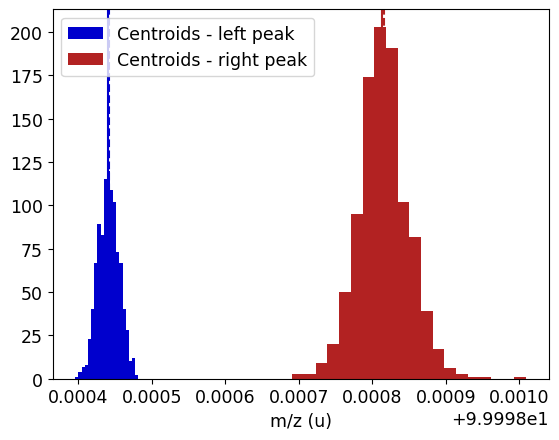

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

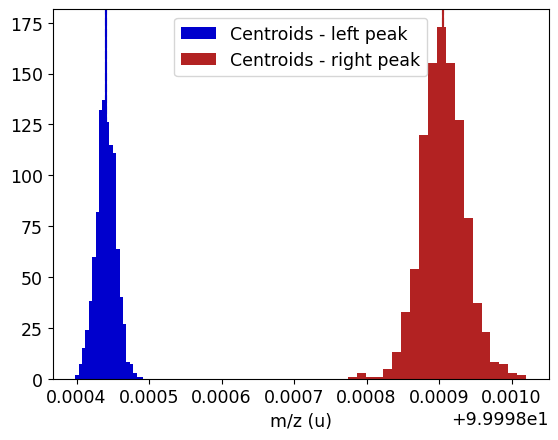

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

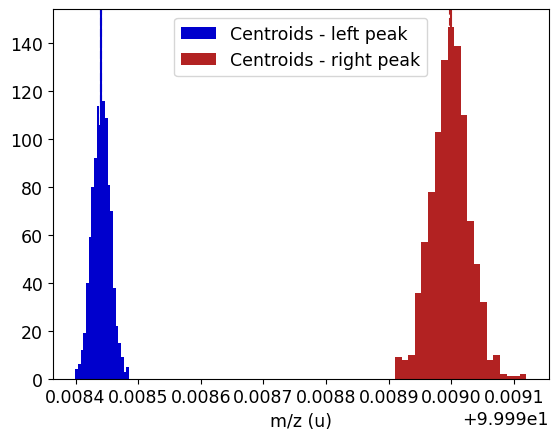

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

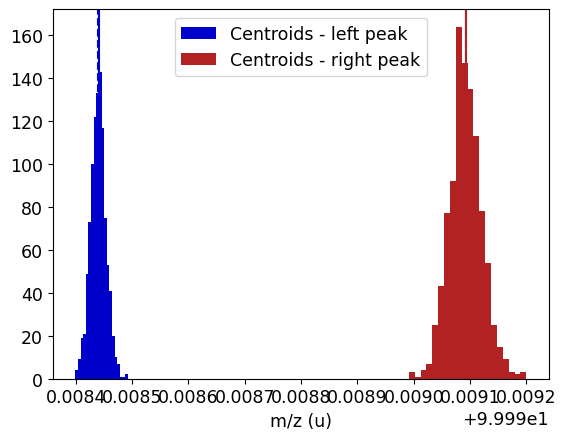

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

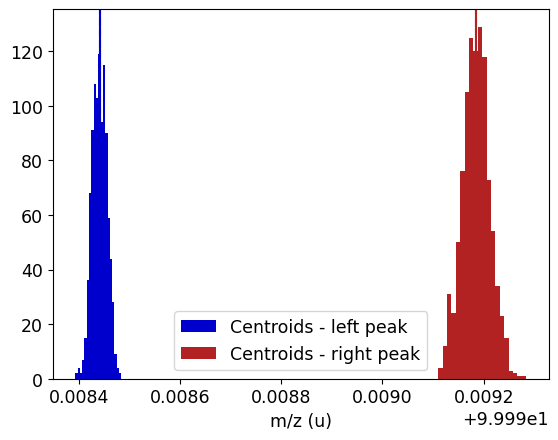

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

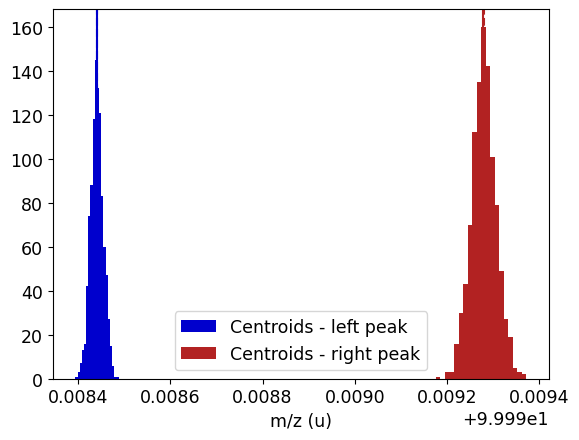

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

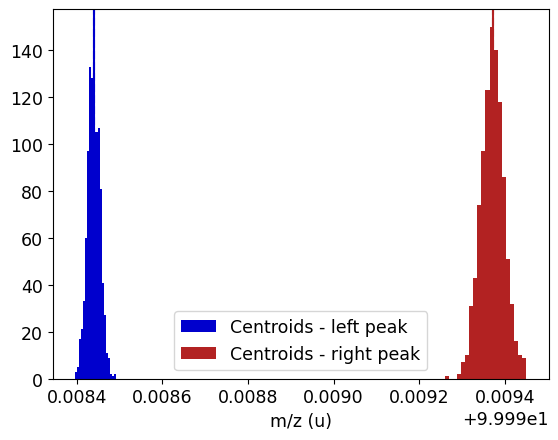

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

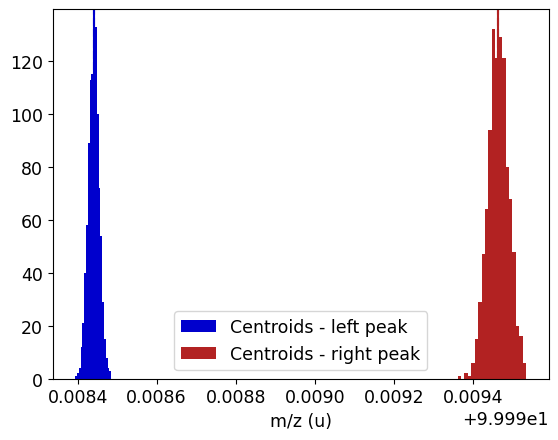

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

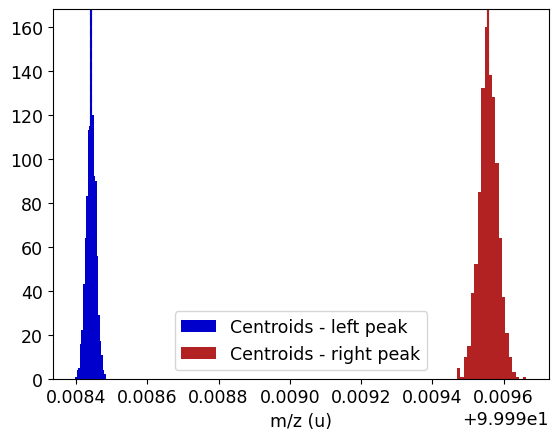

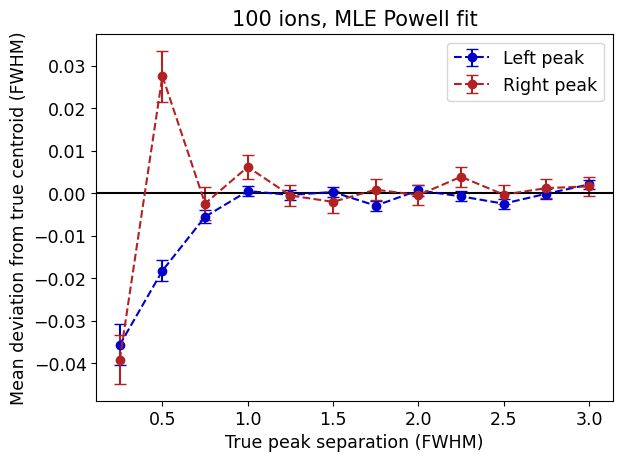

In [10]:
amps = [0.3, 0.1]
N_ions = 100
N_bkg = 30
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

# Compare different background levels

### Scan background level at fixed peak spacing

In [9]:
def scan_bkg_amplitude(N_bkgs, peak_separation, amps, N_ions=100, N_spectra=1000, 
                       cost_func="MLE", method="least_squares"):
    true_mu0 = 99.998441
    true_mu1 = true_mu0 + peak_separation
    true_mus = [true_mu0, true_mu1]
    
    mean_mu0s = []
    mean_mu1s = []
    stderr_mu0s = []
    stderr_mu1s = []
    true_mu0s = []
    true_mu1s = []
    for N_bkg in N_bkgs:
        print("Background event number: N_bkg =", N_bkg)
        N_events = N_ions + N_bkg
        print(f"Total event number: {N_events}")
        mu0s = []
        mu1s = []
        for _ in range(N_spectra):
            fit_result = fit_doublet(shape_pars, true_mus, amps, N_ions, N_bkg, cost_func=cost_func, 
                                     method=method, N_bins=1000, par_hint_args={}, show_outputs=False)
            mu0 = fit_result.params["p0_mu"].value
            mu1 = fit_result.params["p1_mu"].value
            mu0s.append(mu0)
            mu1s.append(mu1)
            
        mean_mu0s.append(np.mean(mu0s))
        mean_mu1s.append(np.mean(mu1s))
        stderr_mu0s.append(np.std(mu0s, ddof=1)/np.sqrt(N_spectra))
        stderr_mu1s.append(np.std(mu1s, ddof=1)/np.sqrt(N_spectra))
        
        plt.hist(mu0s, color="mediumblue", label="Left peak", bins=20)
        plt.gca().axvline(mean_mu0s[-1], linestyle="dashed", color="mediumblue")
        plt.gca().axvline(true_mu0, color="mediumblue")
        plt.hist(mu1s, color="firebrick", label="Right peak", bins=20)
        plt.gca().axvline(mean_mu1s[-1], linestyle="dashed", color="firebrick")
        plt.gca().axvline(true_mu1, color="firebrick")
        plt.xlabel("m/z (u)")
        plt.legend()
        plt.show()
        
    
    return N_bkgs, true_mu0, true_mu1, np.array(mean_mu0s), np.array(mean_mu1s), np.array(stderr_mu0s), np.array(stderr_mu1s)

#### chi-square, least_squares fit

Background event number: N_bkg = 0
Total event number: 100


/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


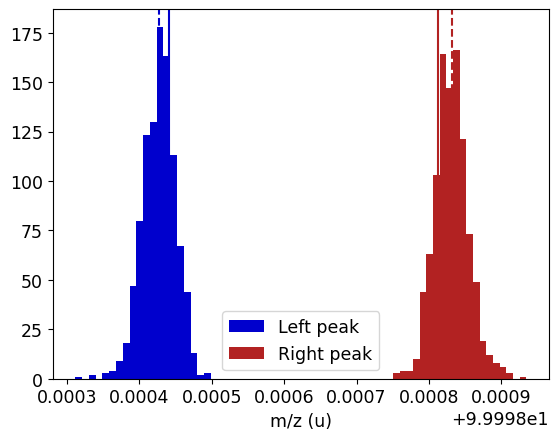

Background event number: N_bkg = 10
Total event number: 110


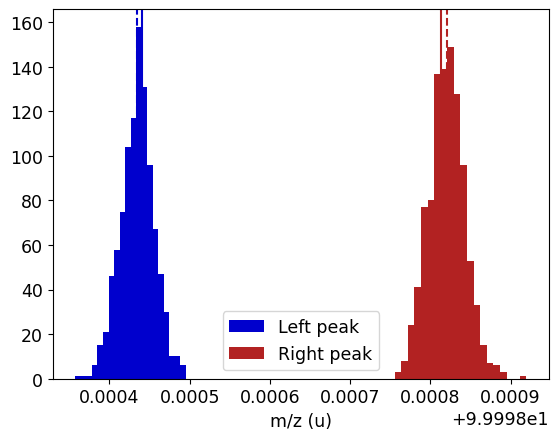

Background event number: N_bkg = 20
Total event number: 120


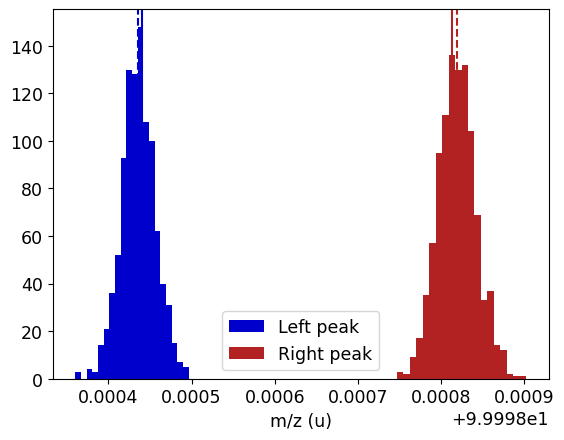

Background event number: N_bkg = 30
Total event number: 130


/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p0_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


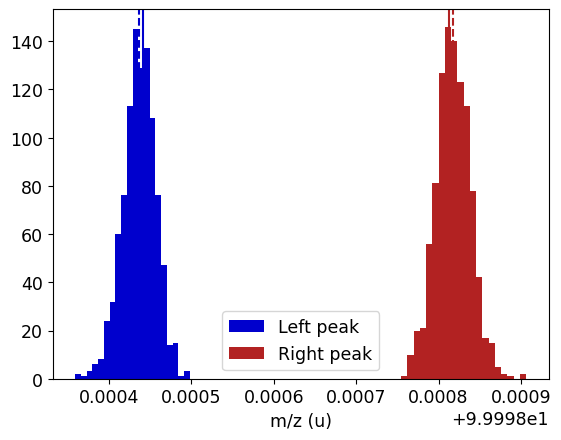

Background event number: N_bkg = 40
Total event number: 140


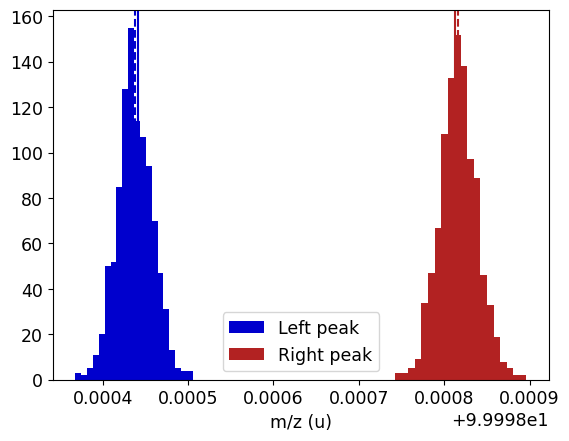

Background event number: N_bkg = 50
Total event number: 150


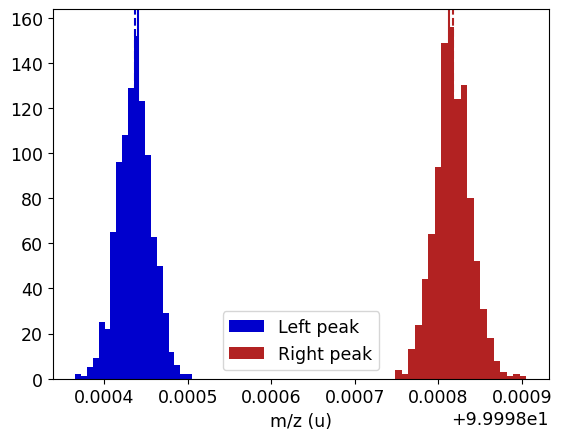

Background event number: N_bkg = 60
Total event number: 160


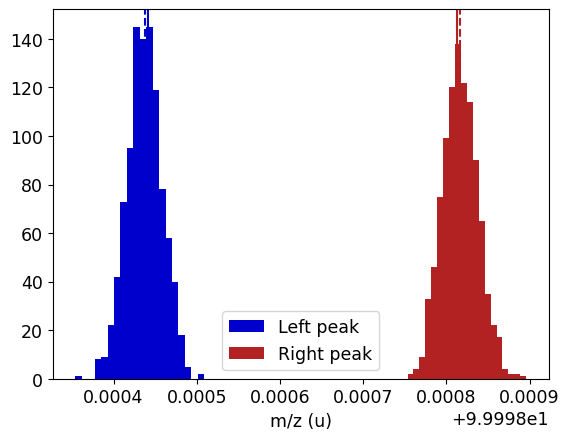

Background event number: N_bkg = 70
Total event number: 170


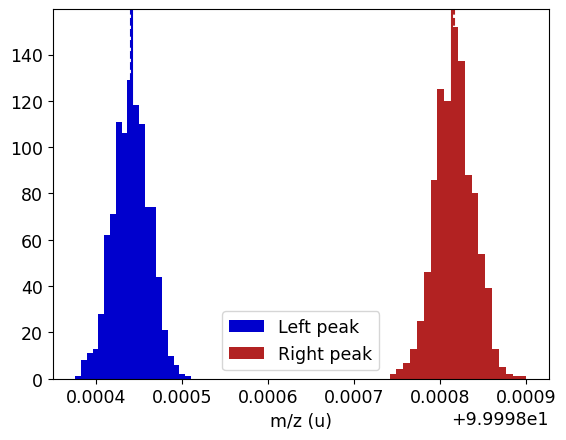

Background event number: N_bkg = 80
Total event number: 180


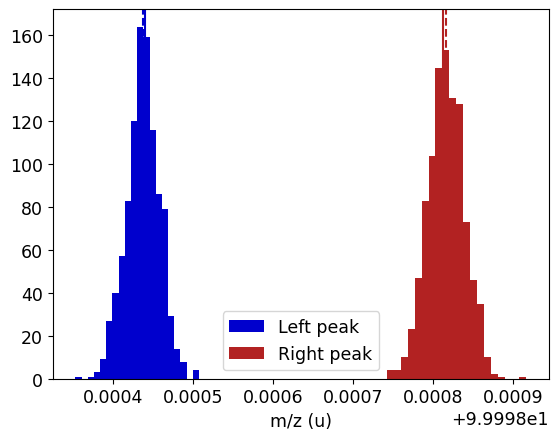

Background event number: N_bkg = 90
Total event number: 190


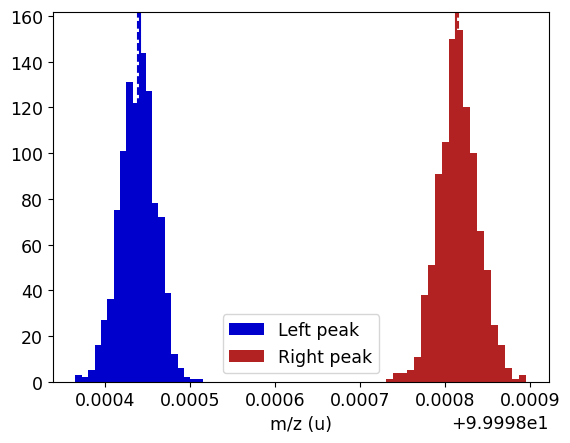

Background event number: N_bkg = 100
Total event number: 200


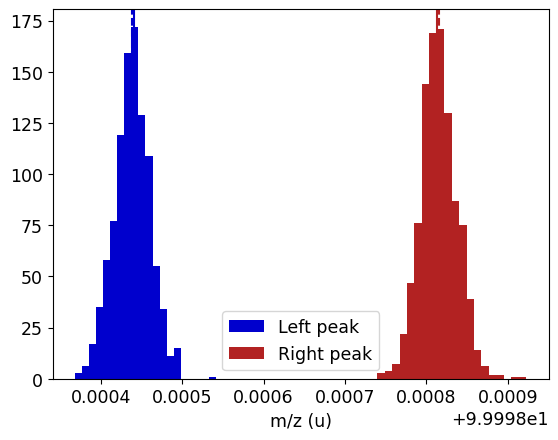

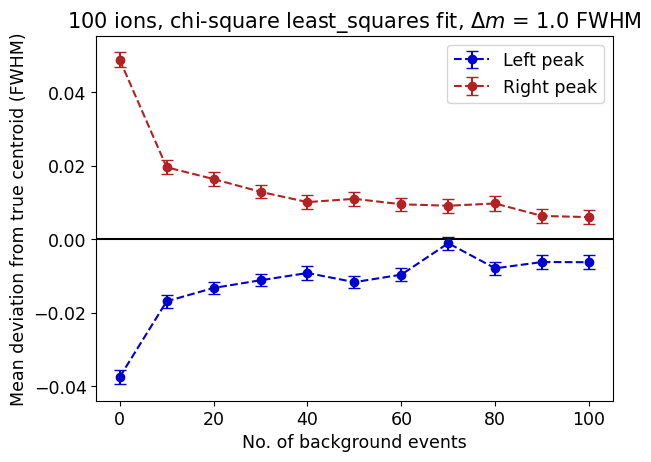

In [14]:
amps = [0.1, 0.1]
N_ions = 100
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separation = 1*FWHM
N_bkgs = np.arange(0, 101, 10)     

results = scan_bkg_amplitude(N_bkgs, peak_separation, amps, N_ions=N_ions, N_spectra=N_spectra, 
                             cost_func=cost_func, method=method)
    
N_bkgs, true_mu0, true_mu1, mean_mu0s, mean_mu1s, stderr_mu0s, stderr_mu1s = results 

plt.title(str(N_ions)+" ions, "+str(cost_func)+" "+str(method)+f" fit, $\Delta m$ = {FWHM/FWHM} FWHM")
plt.errorbar(N_bkgs, (mean_mu0s-true_mu0)/FWHM, stderr_mu0s/FWHM, 
             fmt="o--", capsize=4, color="mediumblue", label="Left peak")
plt.errorbar(N_bkgs, (mean_mu1s-true_mu1)/FWHM, stderr_mu1s/FWHM, 
             fmt="o--", capsize=4, color="firebrick", label="Right peak")
plt.gca().axhline(0, color="black")
plt.xlabel("No. of background events")
plt.ylabel("Mean deviation from true centroid (FWHM)")
plt.legend()
plt.tight_layout()
plt.savefig("Peak_overlap_bias_background_amplitude_scan"+str(N_ions)+"_ions_amps_"+str(amps)+"_"+str(cost_func)+"_"+str(method)+"_fit.png", dpi=600)
plt.show()

#### MLE, least_squares fit

Background event number: N_bkg = 0
Total event number: 100


/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


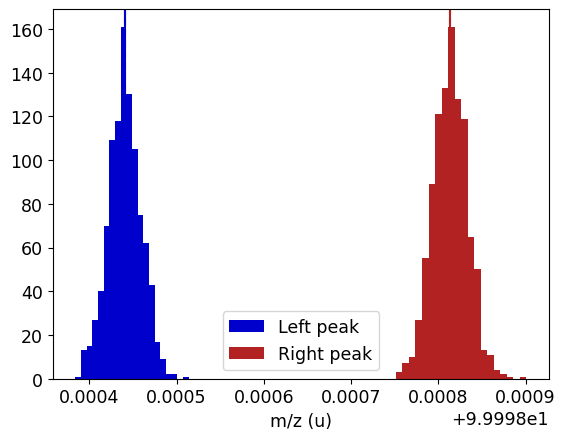

Background event number: N_bkg = 10
Total event number: 110


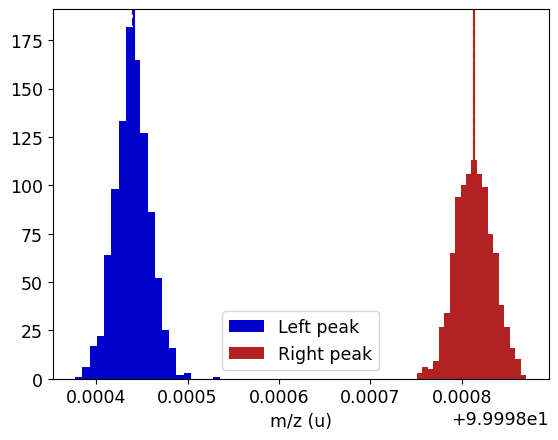

Background event number: N_bkg = 20
Total event number: 120


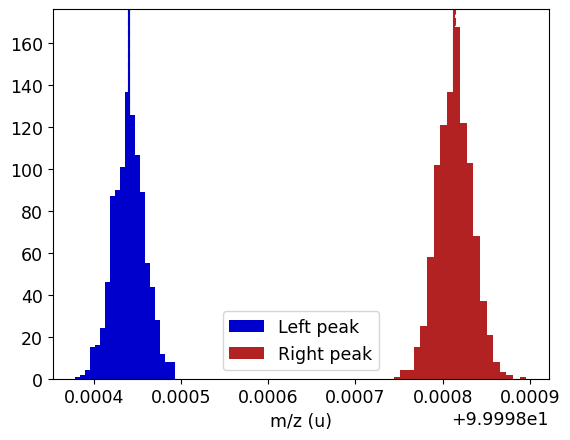

Background event number: N_bkg = 30
Total event number: 130


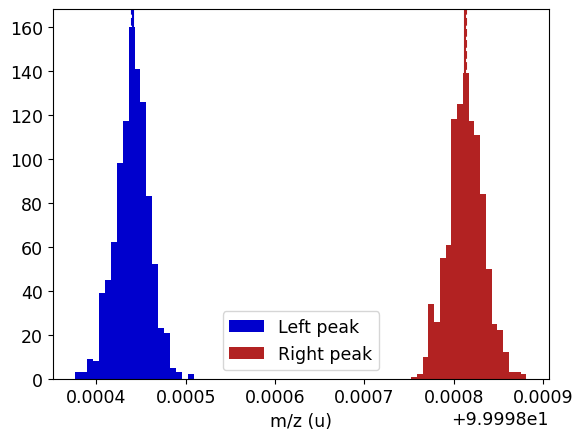

Background event number: N_bkg = 40
Total event number: 140


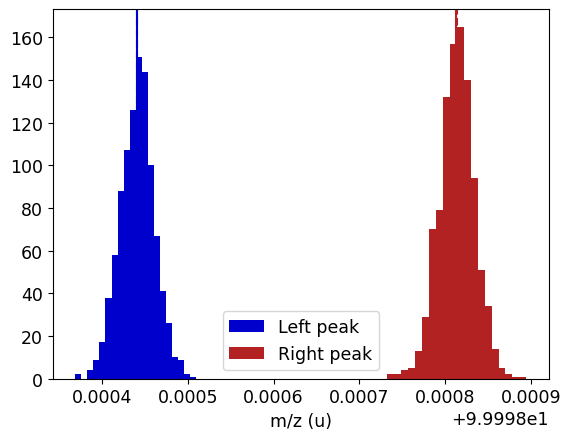

Background event number: N_bkg = 50
Total event number: 150


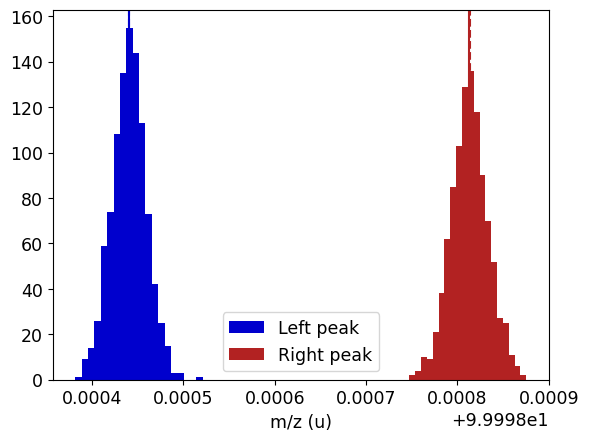

Background event number: N_bkg = 60
Total event number: 160


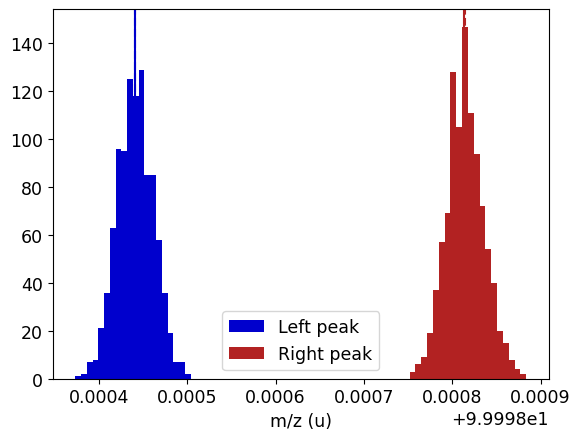

Background event number: N_bkg = 70
Total event number: 170


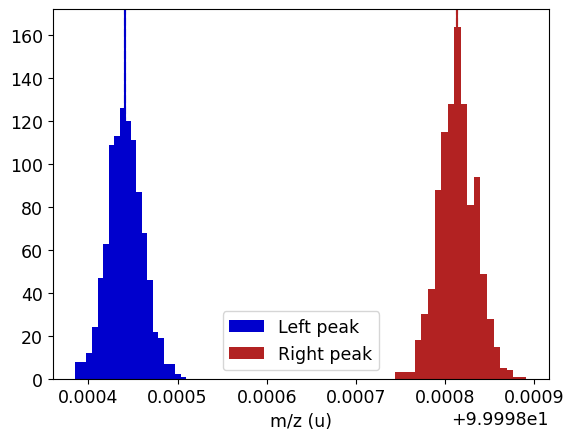

Background event number: N_bkg = 80
Total event number: 180


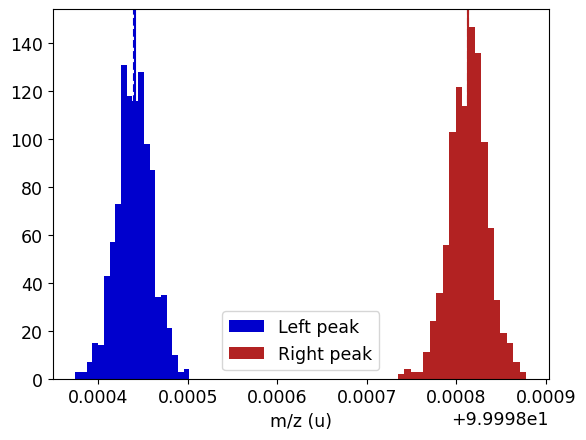

Background event number: N_bkg = 90
Total event number: 190


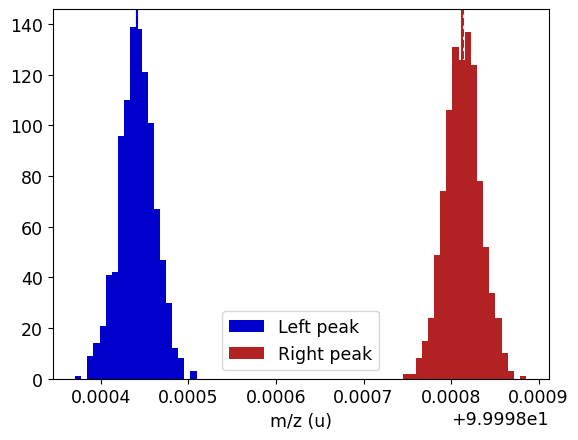

Background event number: N_bkg = 100
Total event number: 200


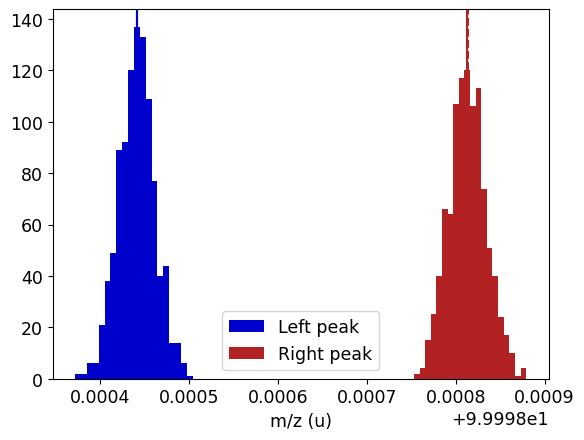

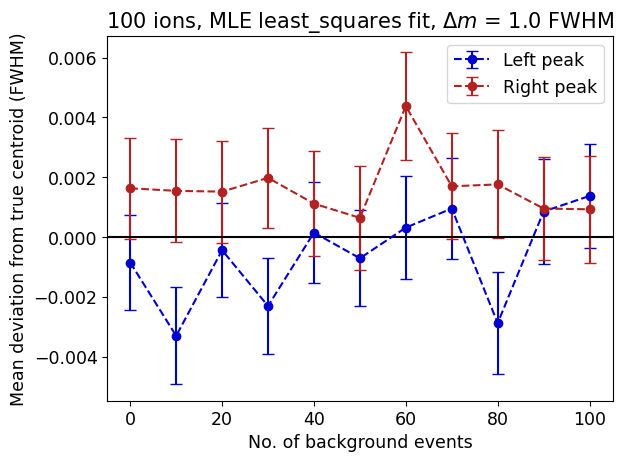

In [10]:
amps = [0.1, 0.1]
N_ions = 100
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separation = 1*FWHM
N_bkgs = np.arange(0, 101, 10)     

results = scan_bkg_amplitude(N_bkgs, peak_separation, amps, N_ions=N_ions, N_spectra=N_spectra, 
                             cost_func=cost_func, method=method)
    
N_bkgs, true_mu0, true_mu1, mean_mu0s, mean_mu1s, stderr_mu0s, stderr_mu1s = results 

plt.title(str(N_ions)+" ions, "+str(cost_func)+" "+str(method)+f" fit, $\Delta m$ = {FWHM/FWHM} FWHM")
plt.errorbar(N_bkgs, (mean_mu0s-true_mu0)/FWHM, stderr_mu0s/FWHM, 
             fmt="o--", capsize=4, color="mediumblue", label="Left peak")
plt.errorbar(N_bkgs, (mean_mu1s-true_mu1)/FWHM, stderr_mu1s/FWHM, 
             fmt="o--", capsize=4, color="firebrick", label="Right peak")
plt.gca().axhline(0, color="black")
plt.xlabel("No. of background events")
plt.ylabel("Mean deviation from true centroid (FWHM)")
plt.legend()
plt.tight_layout()
plt.savefig("Peak_overlap_bias_background_amplitude_scan"+str(N_ions)+"_ions_amps_"+str(amps)+"_"+str(cost_func)+"_"+str(method)+"_fit.png", dpi=600)
plt.show()

#### chi-square, Powell fit

Background event number: N_bkg = 0
Total event number: 100


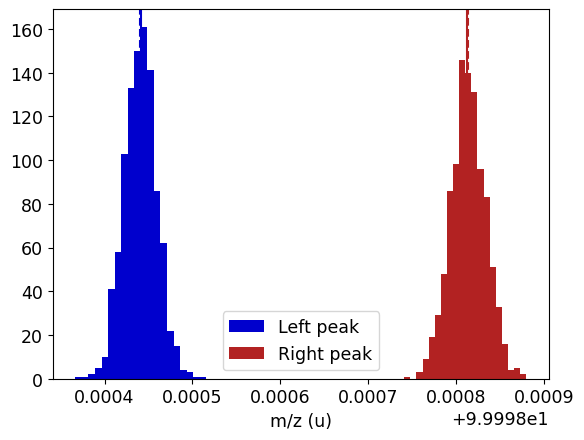

Background event number: N_bkg = 10
Total event number: 110


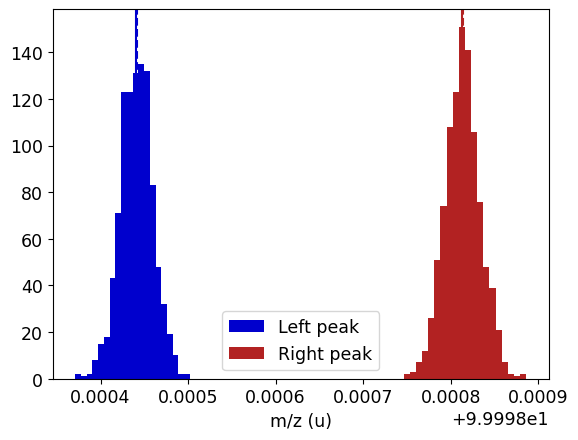

Background event number: N_bkg = 20
Total event number: 120


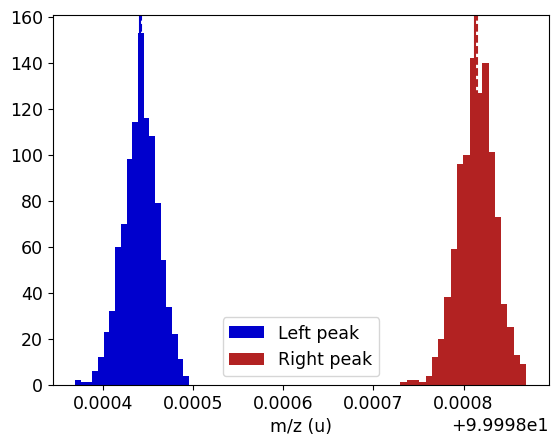

Background event number: N_bkg = 30
Total event number: 130


/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p0_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


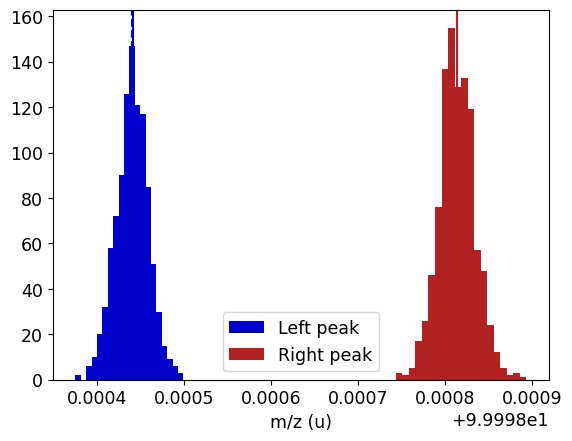

Background event number: N_bkg = 40
Total event number: 140


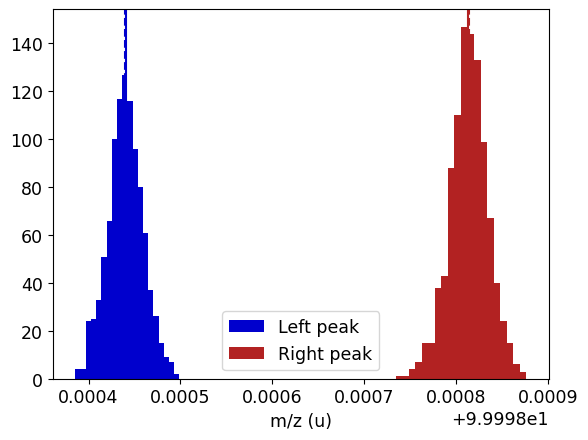

Background event number: N_bkg = 50
Total event number: 150


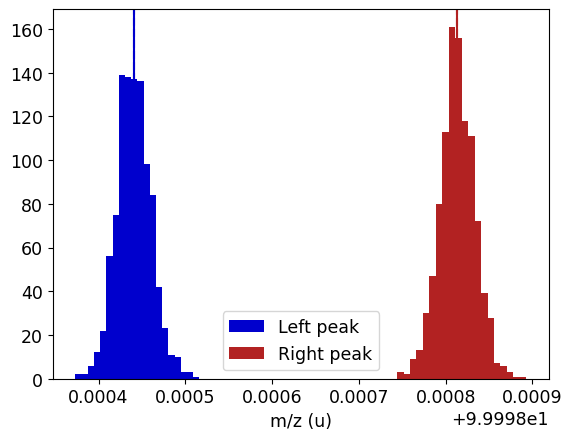

Background event number: N_bkg = 60
Total event number: 160


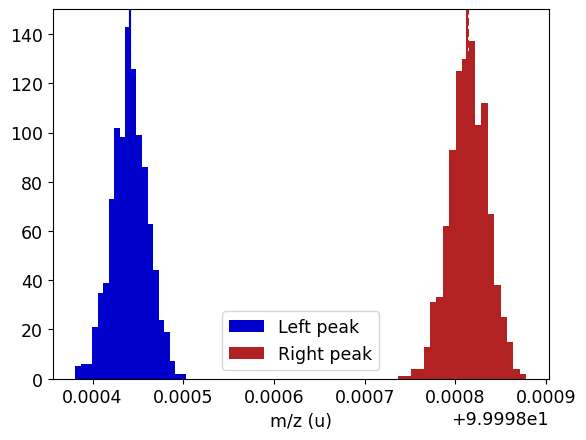

Background event number: N_bkg = 70
Total event number: 170


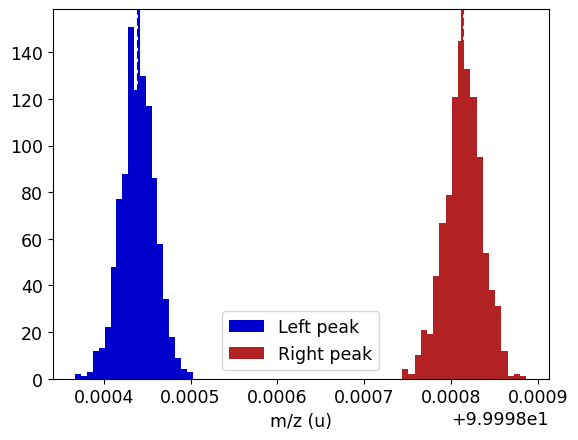

Background event number: N_bkg = 80
Total event number: 180


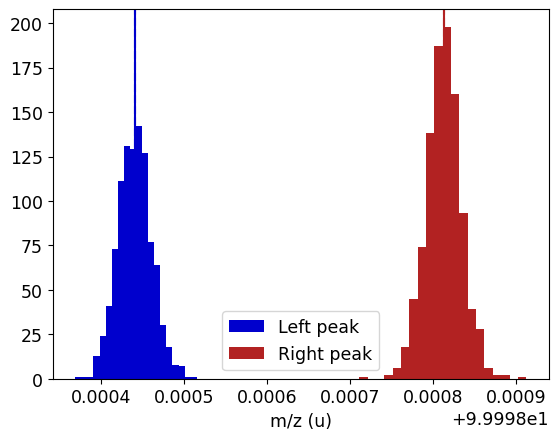

Background event number: N_bkg = 90
Total event number: 190


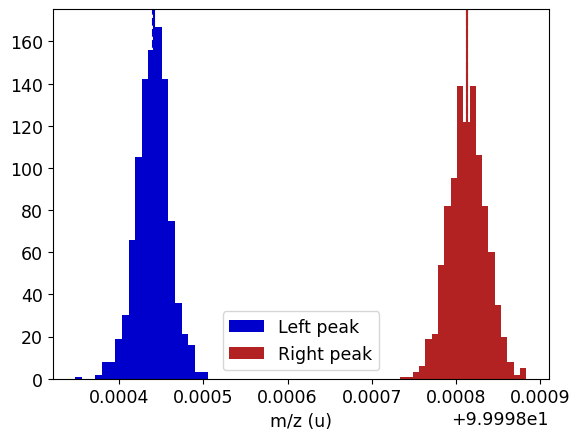

Background event number: N_bkg = 100
Total event number: 200


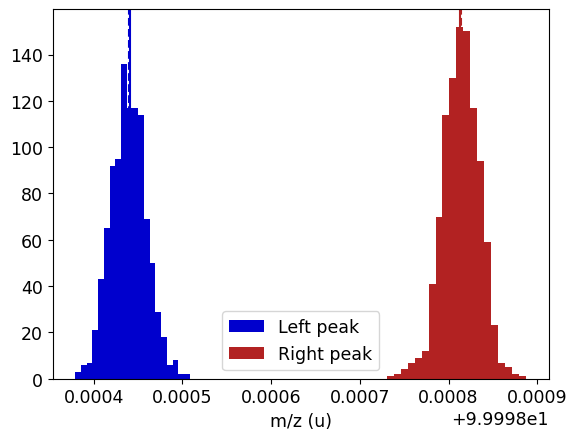

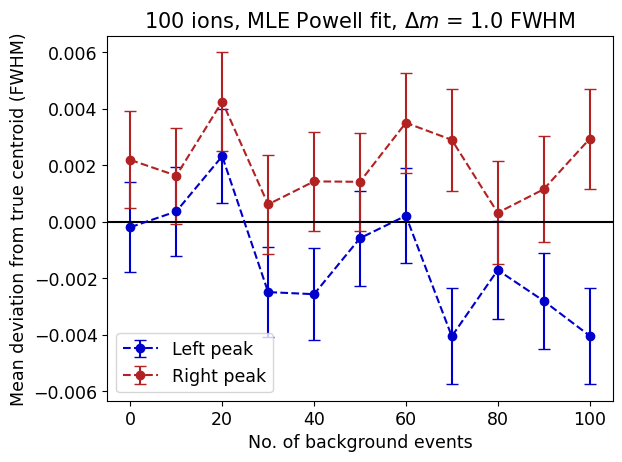

In [11]:
amps = [0.1, 0.1]
N_ions = 100
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separation = 1*FWHM
N_bkgs = np.arange(0, 101, 10)     

results = scan_bkg_amplitude(N_bkgs, peak_separation, amps, N_ions=N_ions, N_spectra=N_spectra, 
                             cost_func=cost_func, method=method)
    
N_bkgs, true_mu0, true_mu1, mean_mu0s, mean_mu1s, stderr_mu0s, stderr_mu1s = results 

plt.title(str(N_ions)+" ions, "+str(cost_func)+" "+str(method)+f" fit, $\Delta m$ = {FWHM/FWHM} FWHM")
plt.errorbar(N_bkgs, (mean_mu0s-true_mu0)/FWHM, stderr_mu0s/FWHM, 
             fmt="o--", capsize=4, color="mediumblue", label="Left peak")
plt.errorbar(N_bkgs, (mean_mu1s-true_mu1)/FWHM, stderr_mu1s/FWHM, 
             fmt="o--", capsize=4, color="firebrick", label="Right peak")
plt.gca().axhline(0, color="black")
plt.xlabel("No. of background events")
plt.ylabel("Mean deviation from true centroid (FWHM)")
plt.legend()
plt.tight_layout()
plt.savefig("Peak_overlap_bias_background_amplitude_scan"+str(N_ions)+"_ions_amps_"+str(amps)+"_"+str(cost_func)+"_"+str(method)+"_fit.png", dpi=600)
plt.show()

### Vary peak spacing - No background 

#### chi-square, least_squares fit

Total event number: 100
Background amplitude: bkg_c = 0.0

##### Plot example spectrum and fit #####


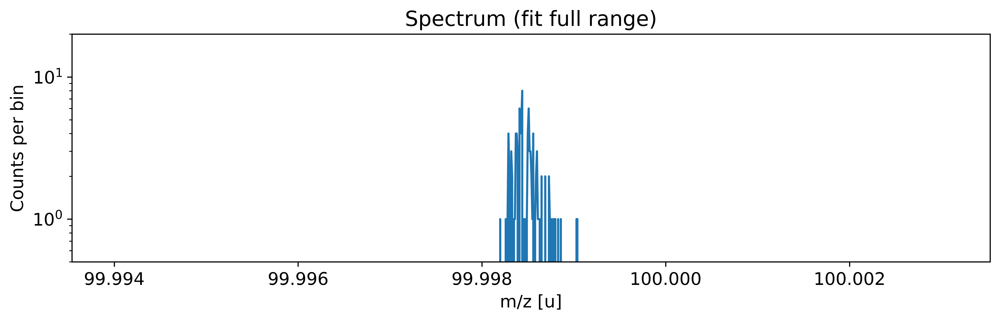

Added peak at 99.99842656957121 u
Added peak at 99.9986153913259 u


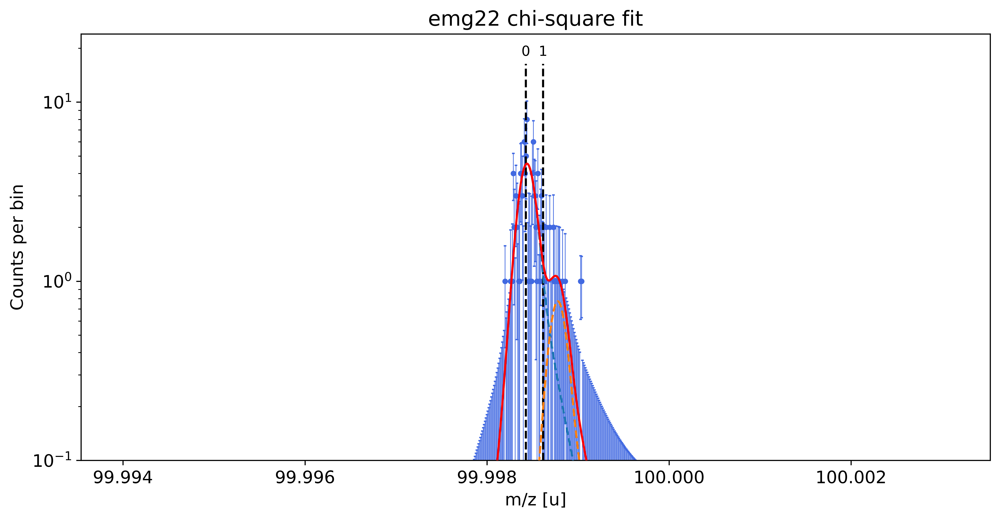

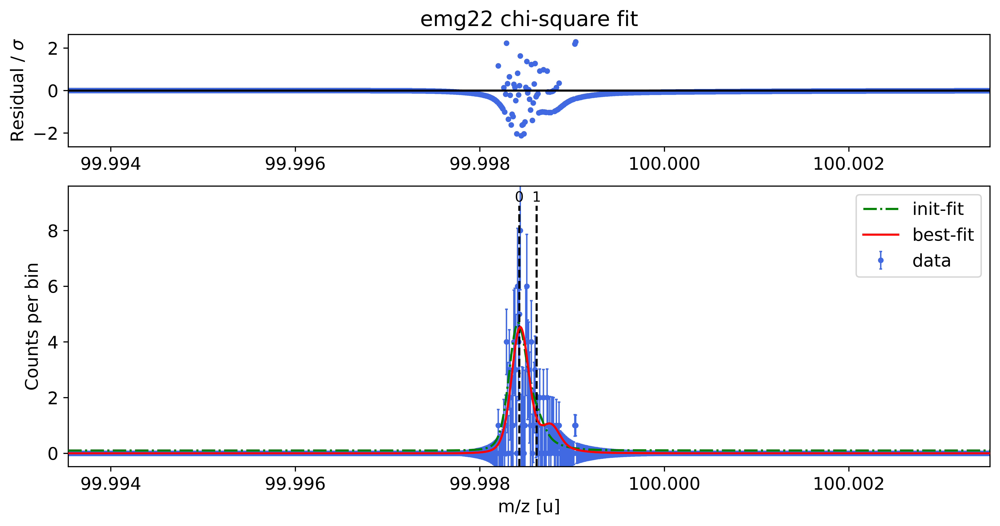

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


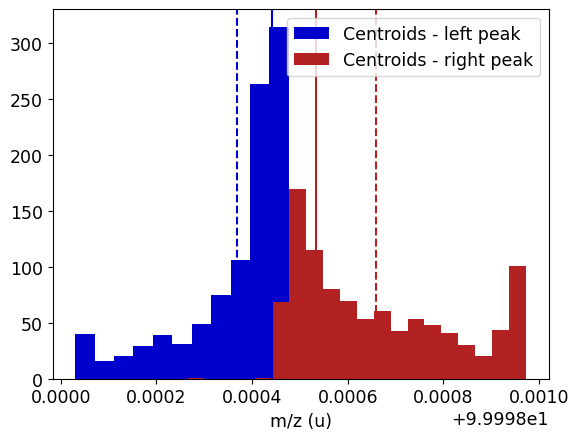

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

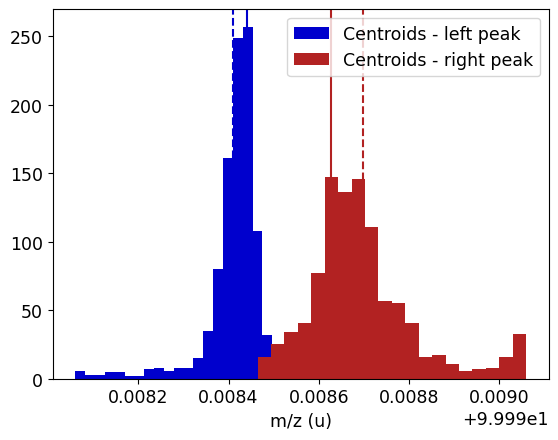

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

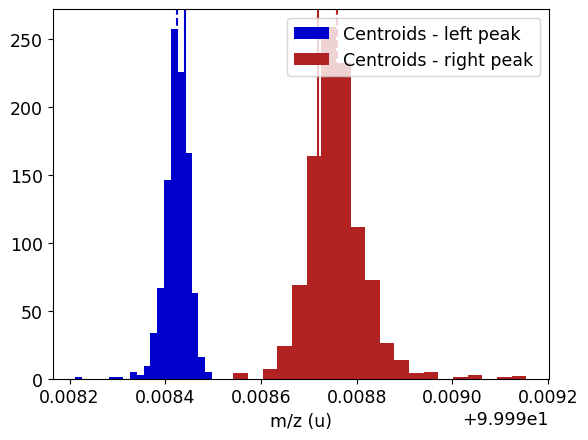

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

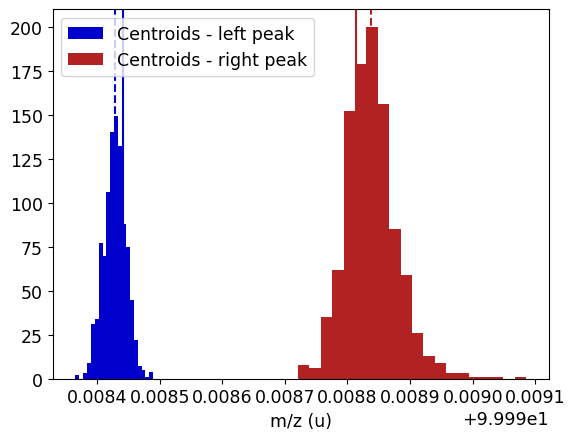

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

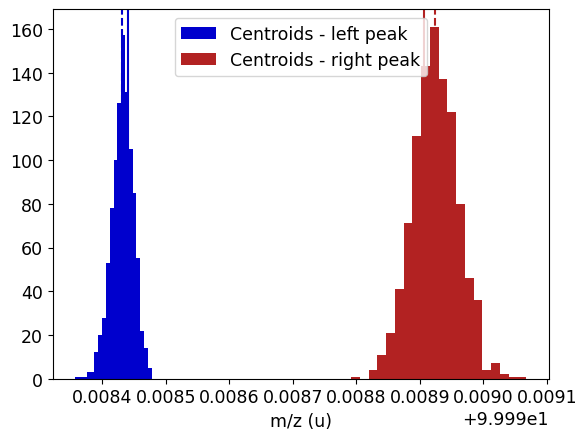

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

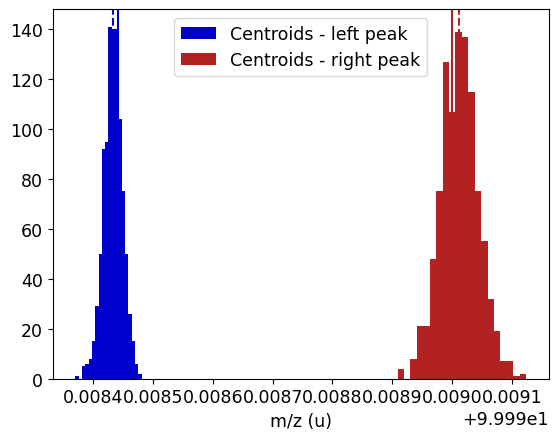

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

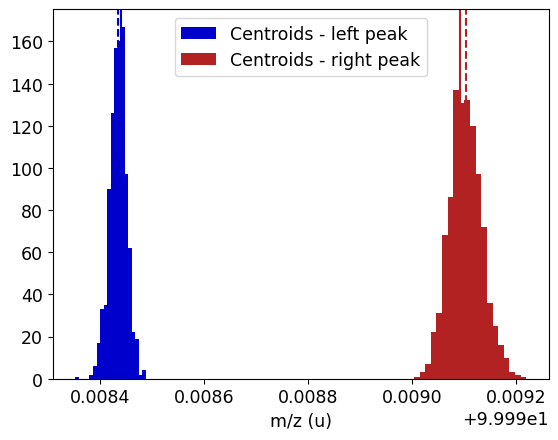

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

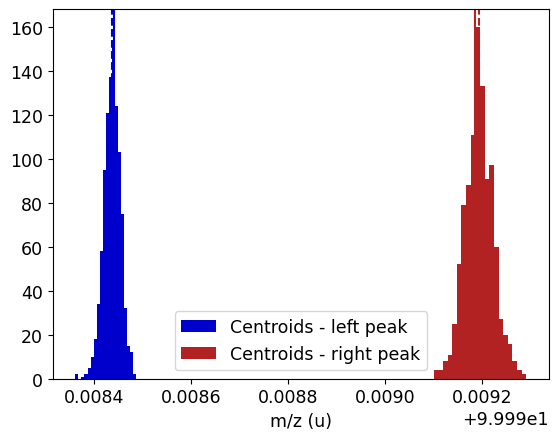

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

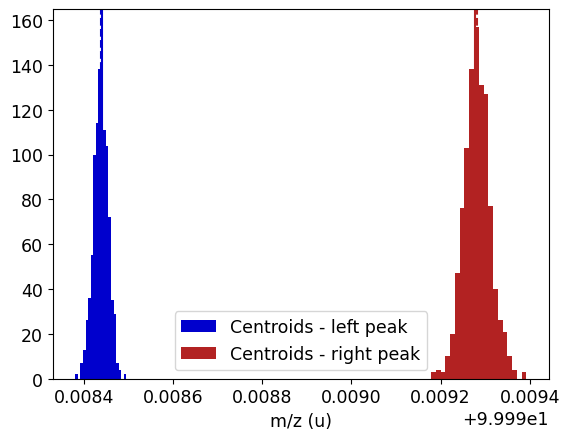

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

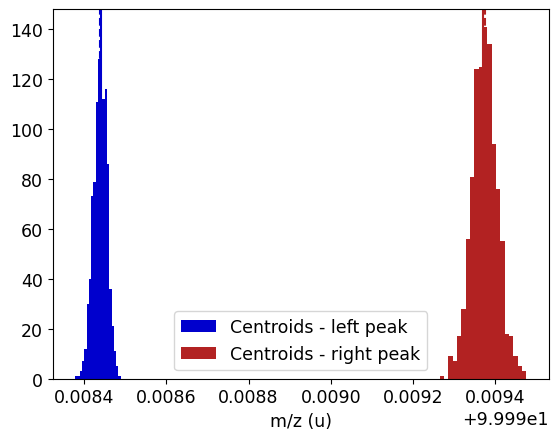

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

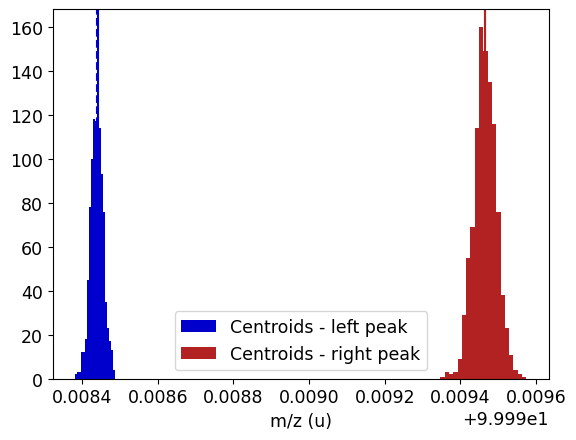

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

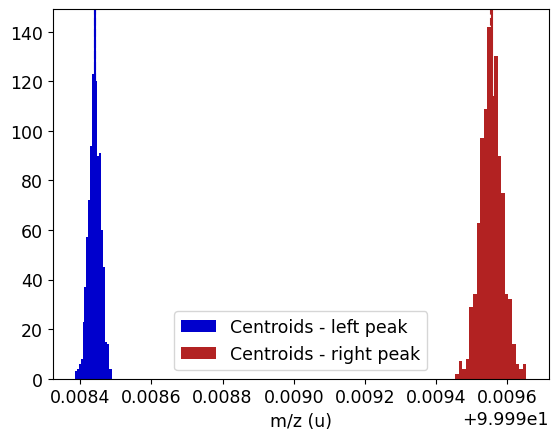

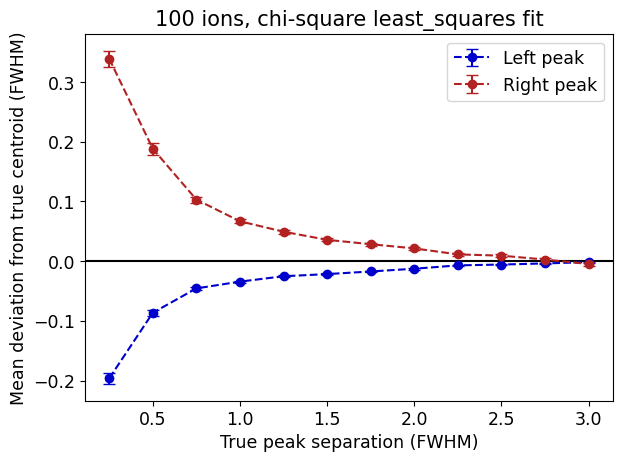

In [12]:
#### amps = [0.1, 0.1]
N_ions = 100
N_bkg = 0
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 100
Background amplitude: bkg_c = 0.0

##### Plot example spectrum and fit #####


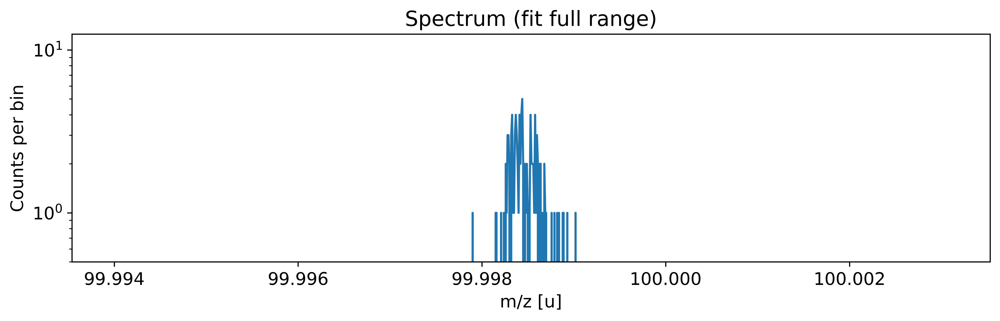

Added peak at 99.99845338444025 u
Added peak at 99.99862143962184 u


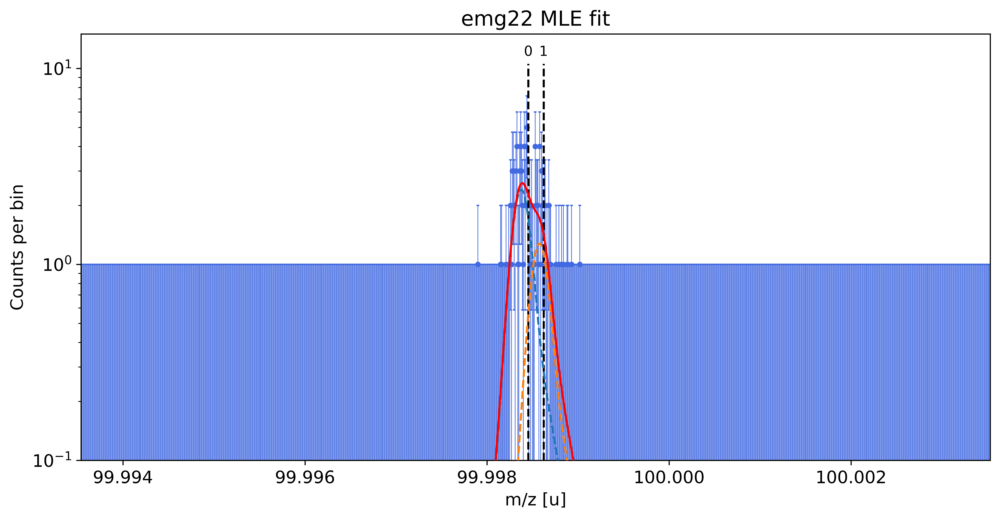

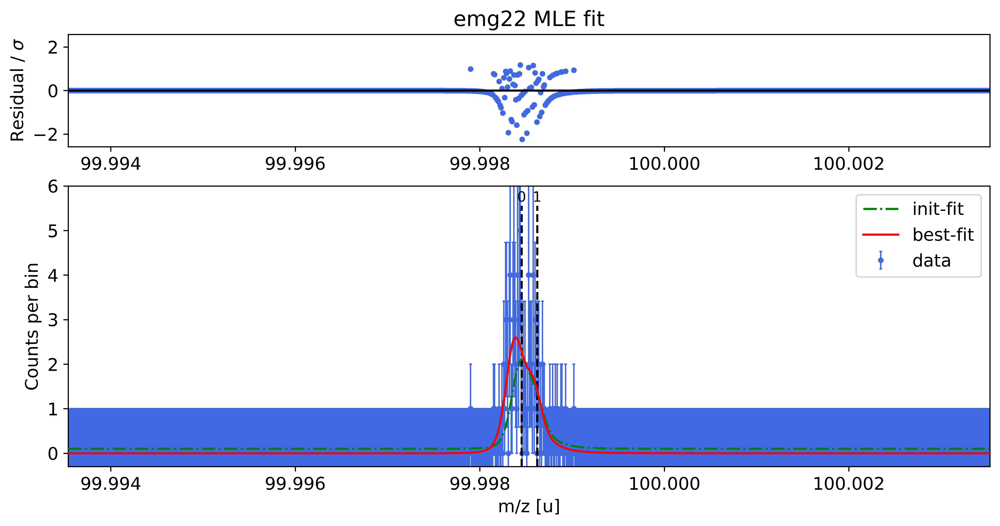

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


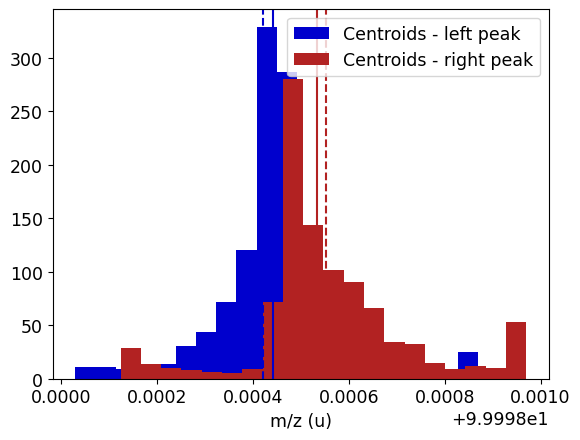

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

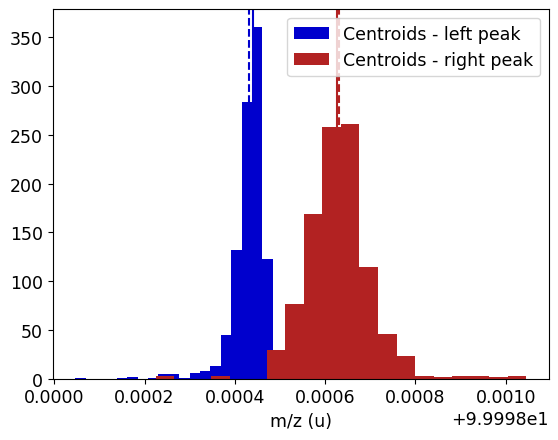

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

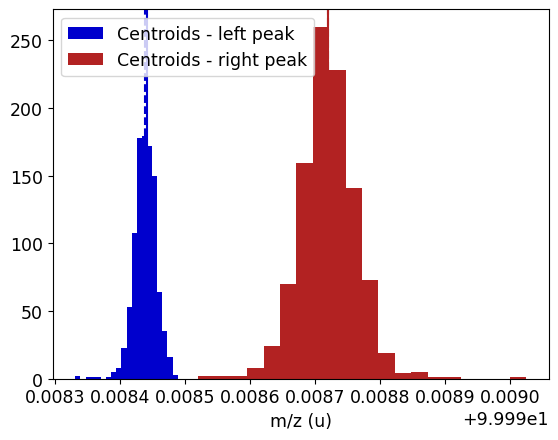

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

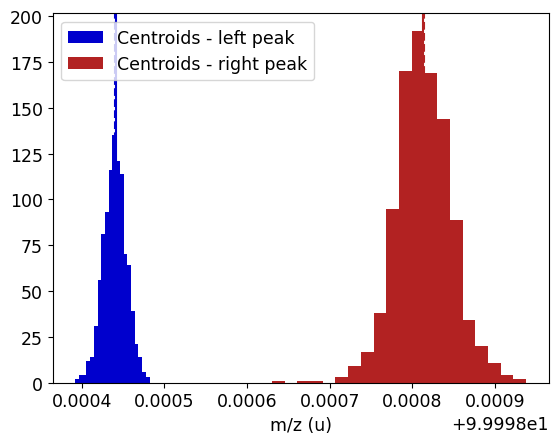

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

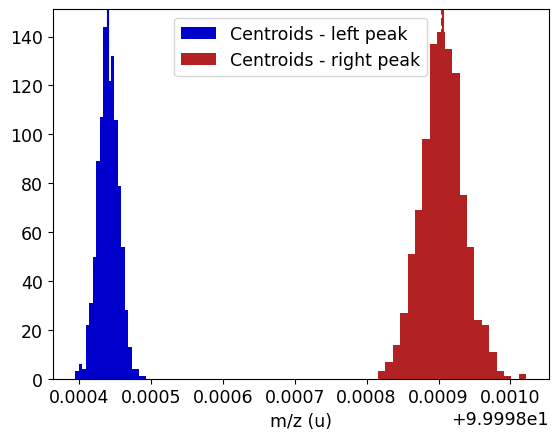

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

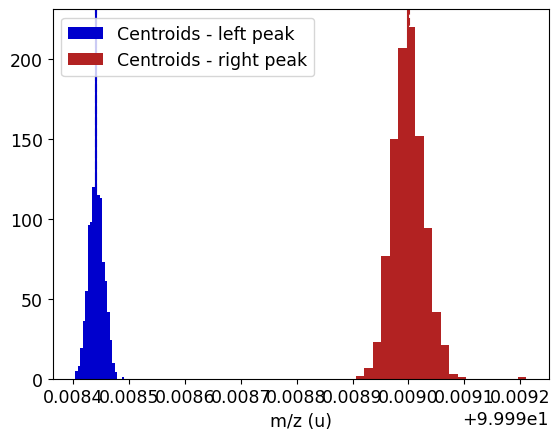

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

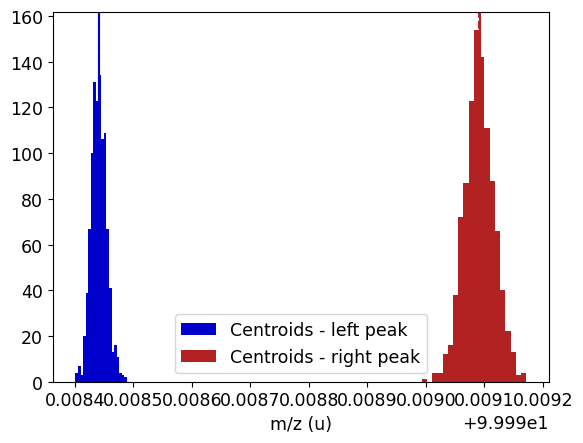

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

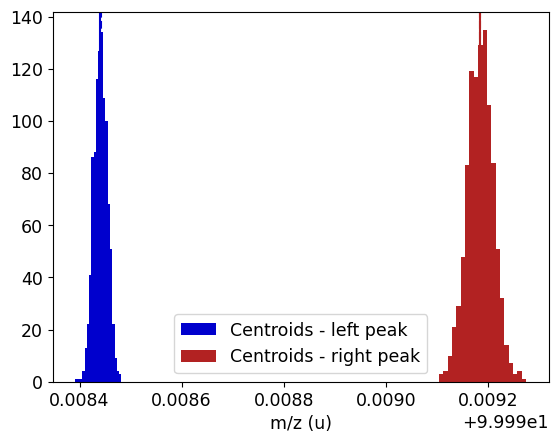

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

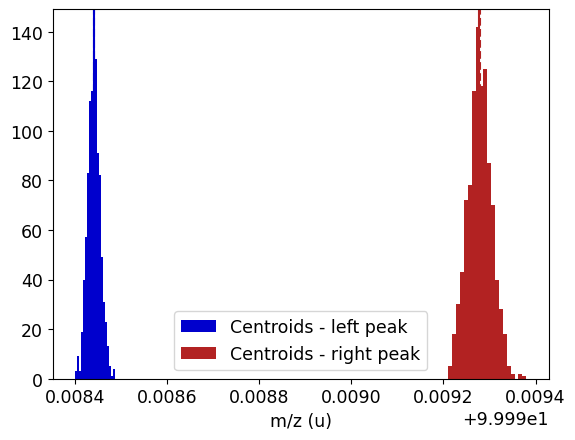

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

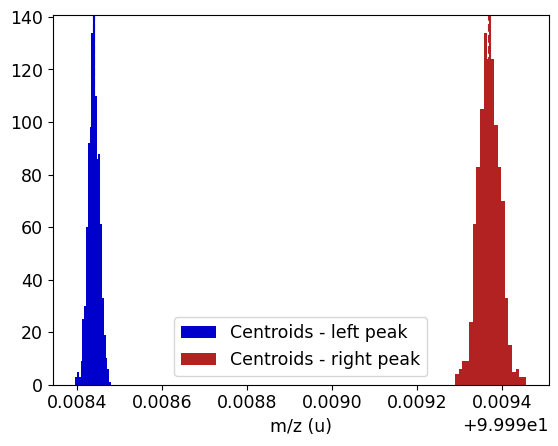

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

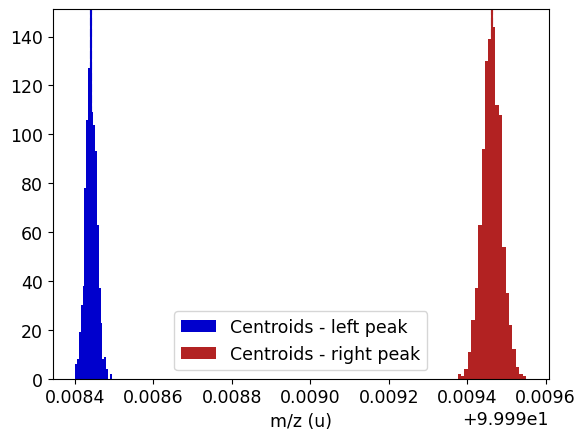

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

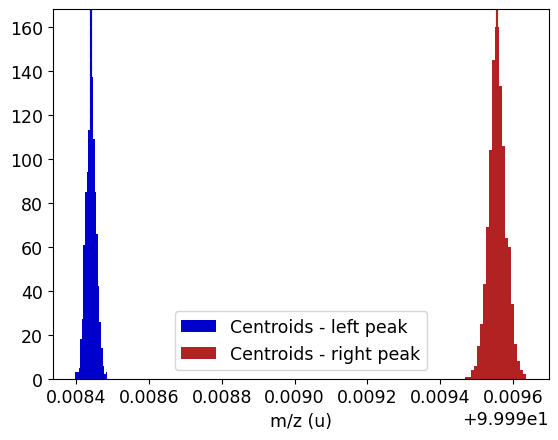

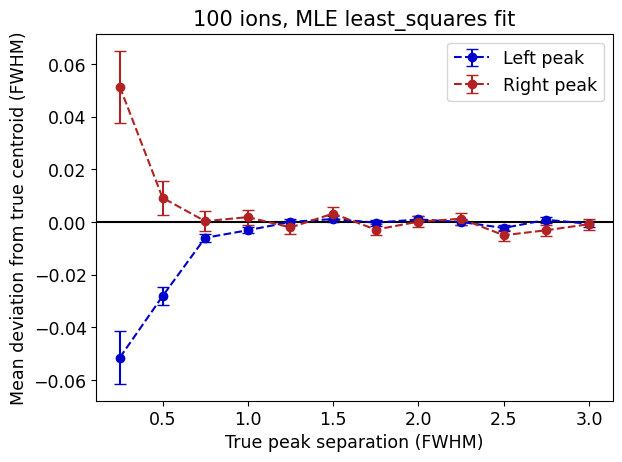

In [13]:
#### amps = [0.1, 0.1]
N_ions = 100
N_bkg = 0
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins,
                           save_figure=True)

#### MLE, Powell fit

Total event number: 100
Background amplitude: bkg_c = 0.0

##### Plot example spectrum and fit #####


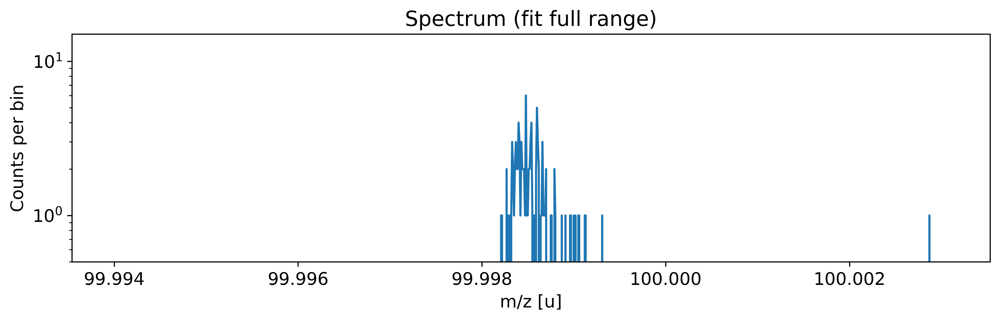

Added peak at 99.99843495486233 u
Added peak at 99.99863128443072 u


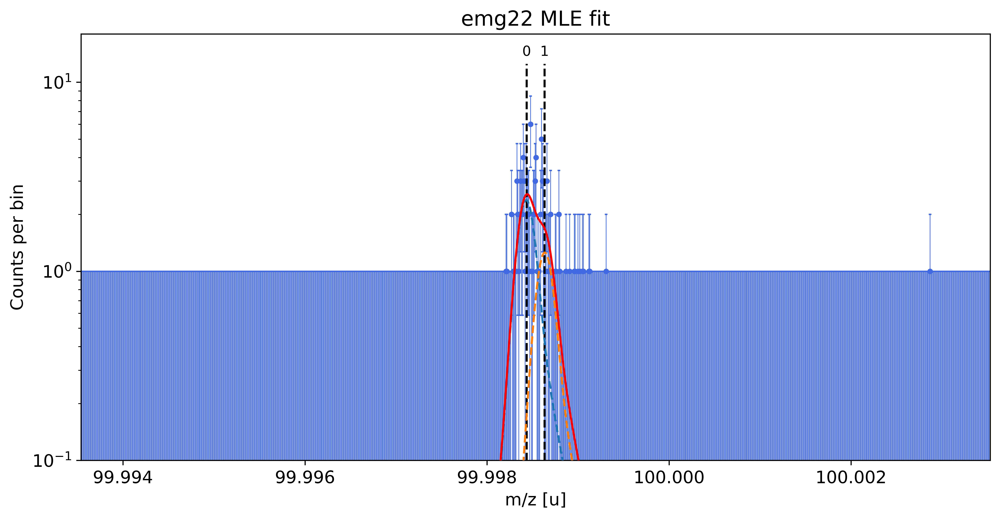

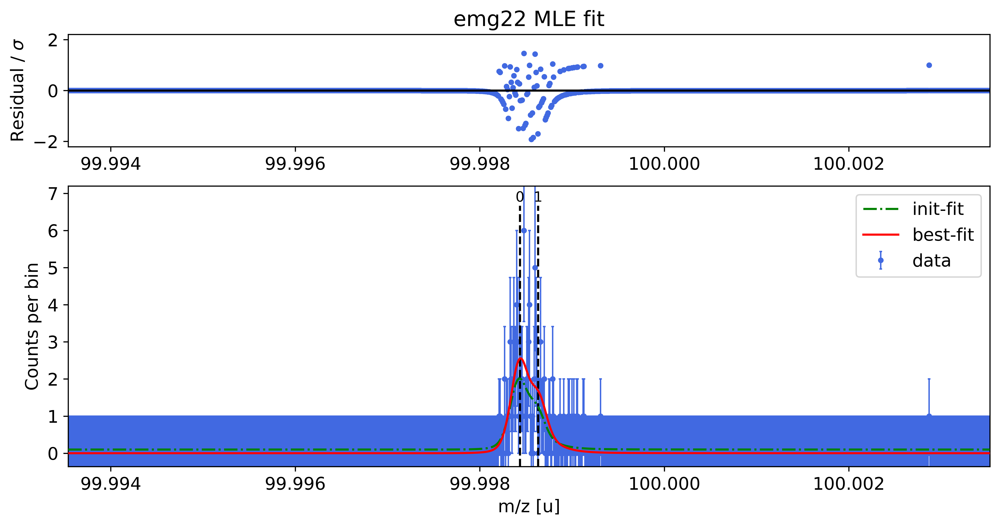

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


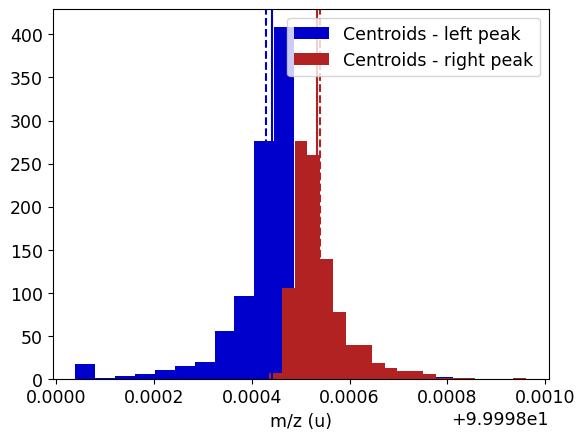

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

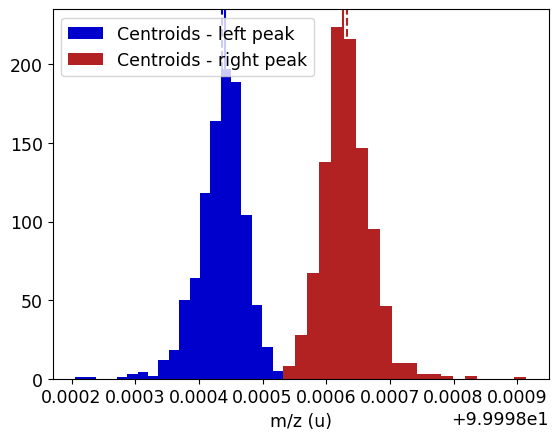

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p0_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


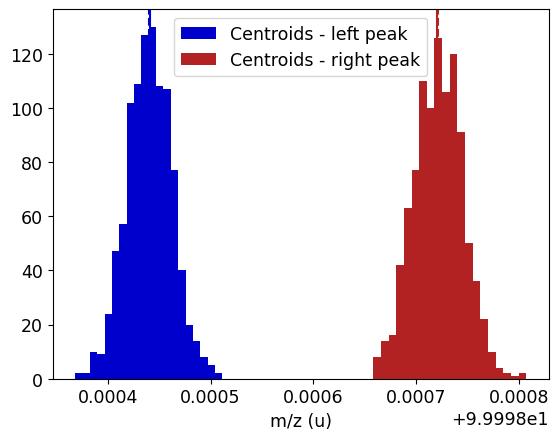

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

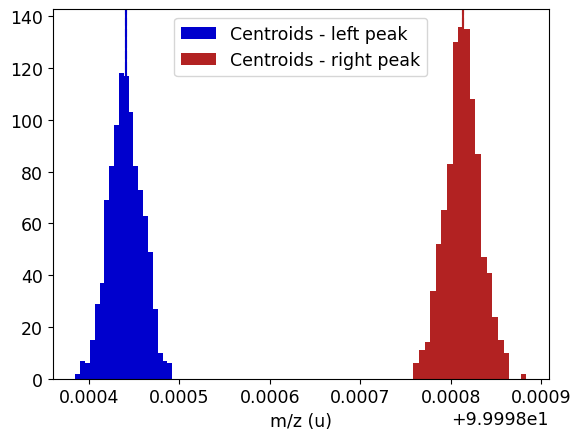

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

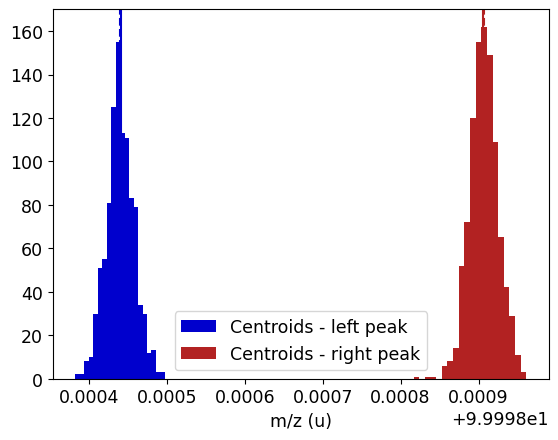

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

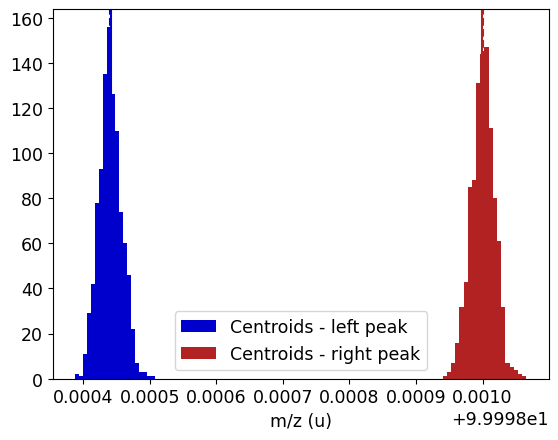

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

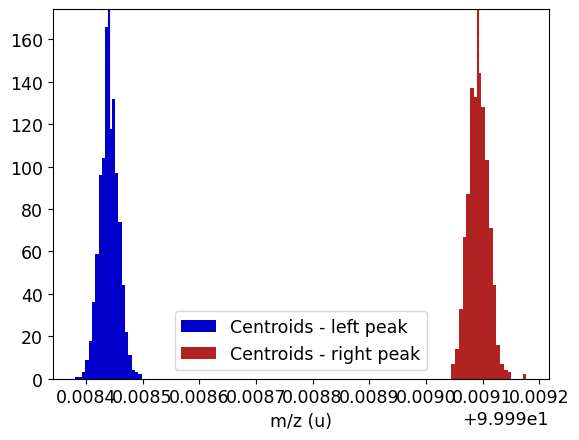

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

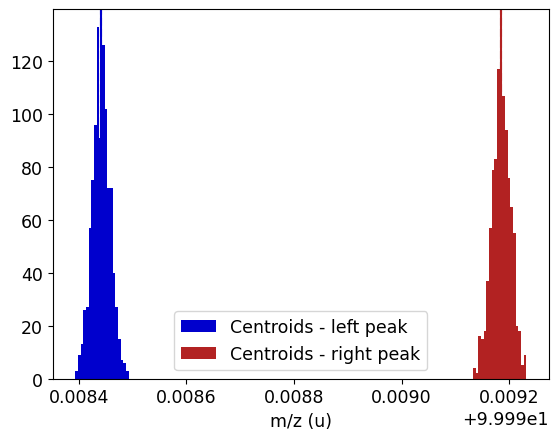

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

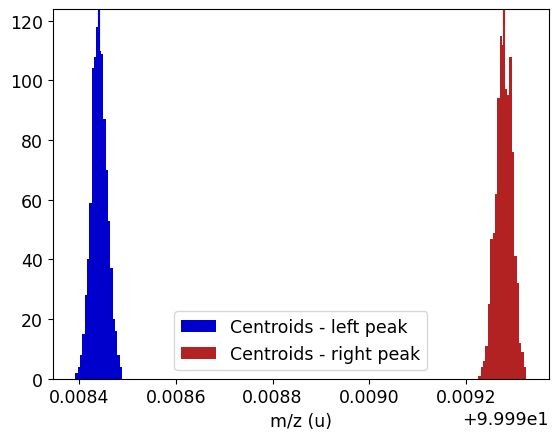

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

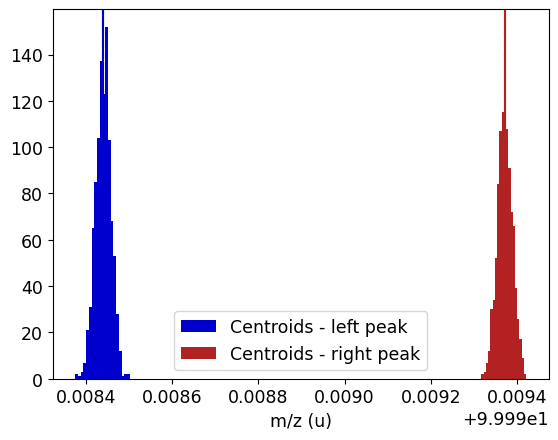

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

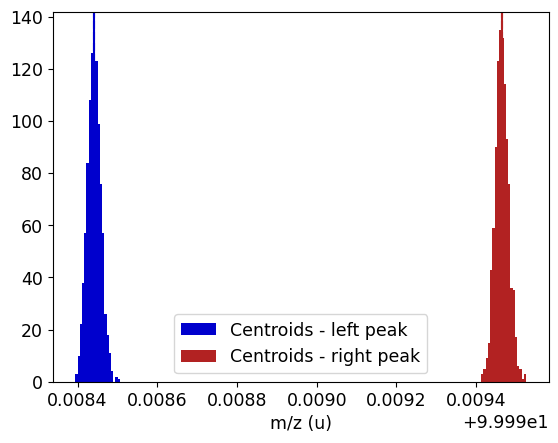

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

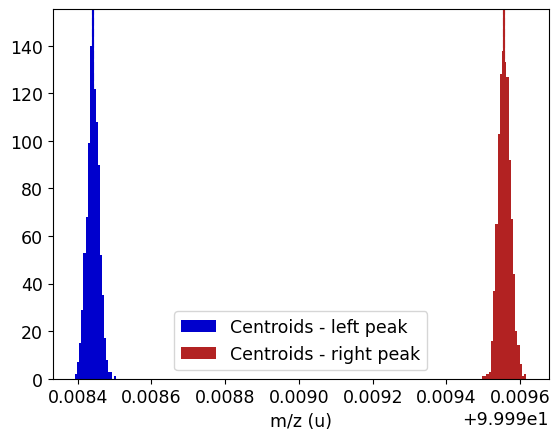

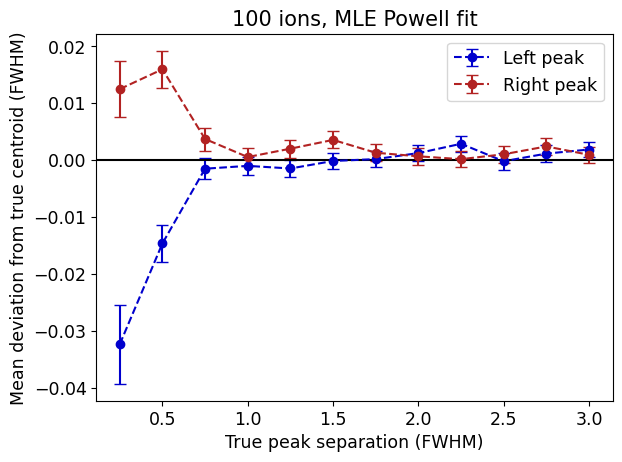

In [14]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 0
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

### Vary peak spacing - 10 background events

#### chi-square, least_squares fit

Total event number: 110
Background amplitude: bkg_c = 2.0000000000018154

##### Plot example spectrum and fit #####


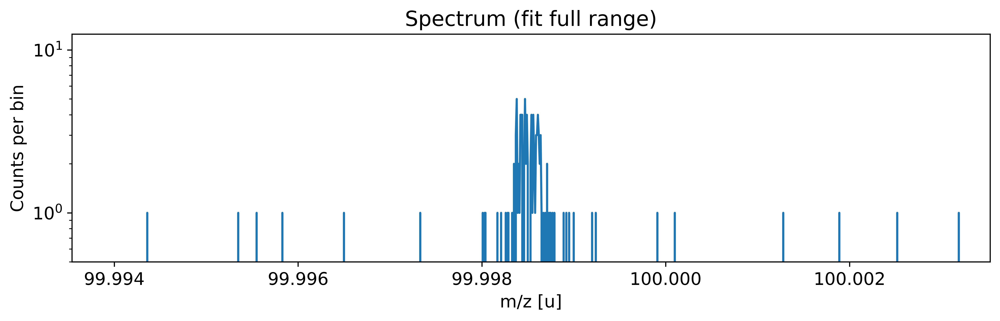

Added peak at 99.99842702824348 u
Added peak at 99.99863456390949 u


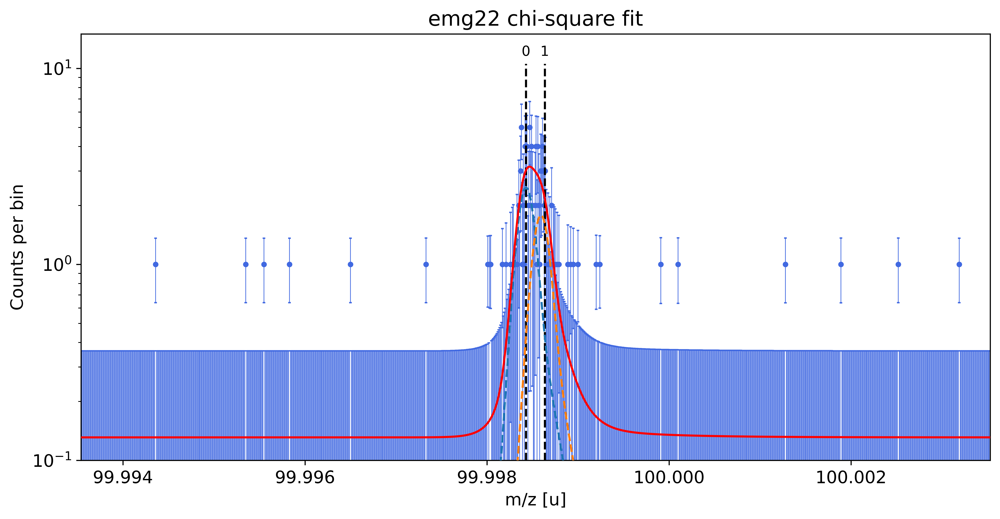

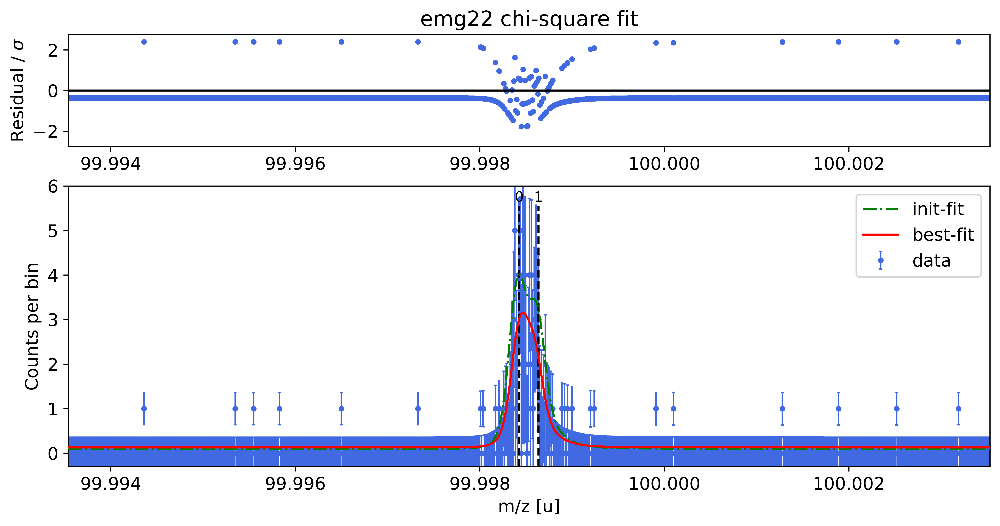

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


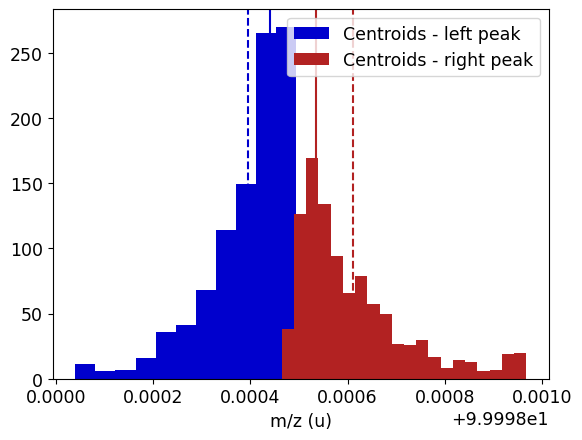

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

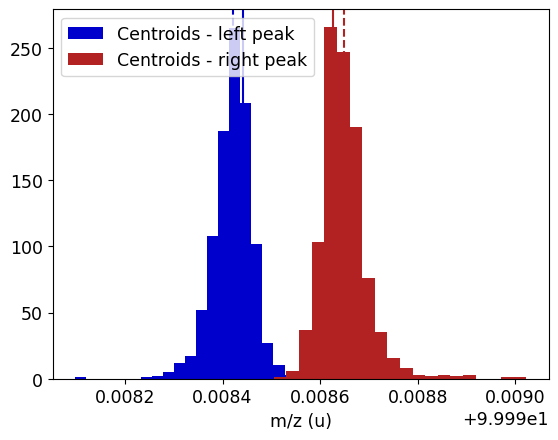

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

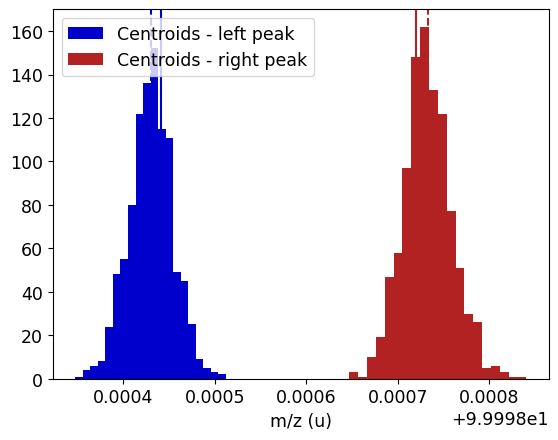

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

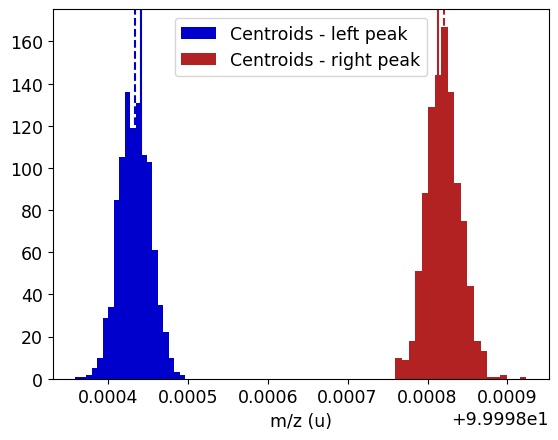

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

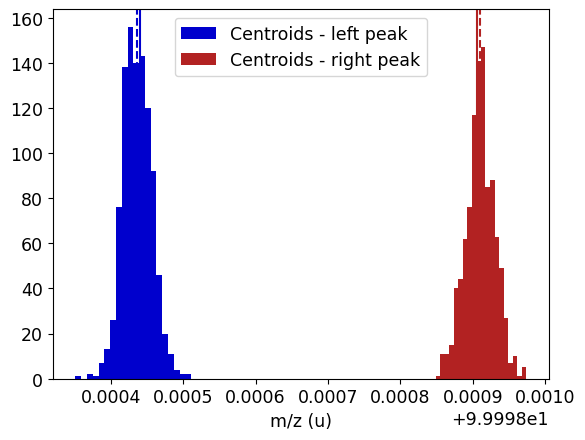

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

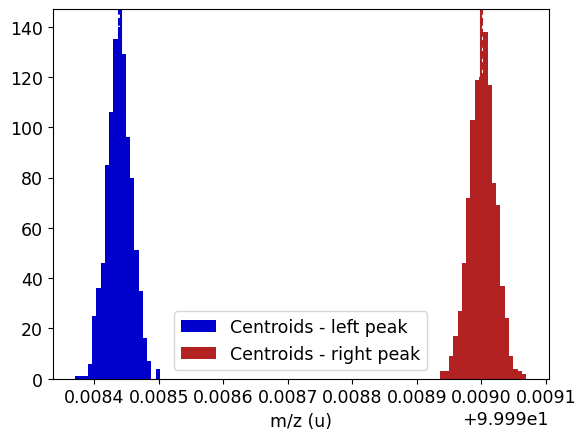

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

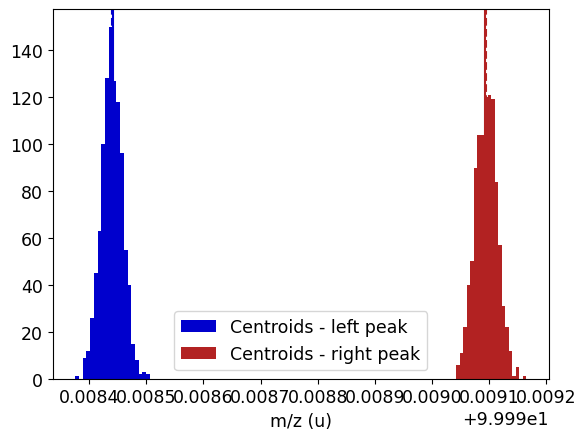

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

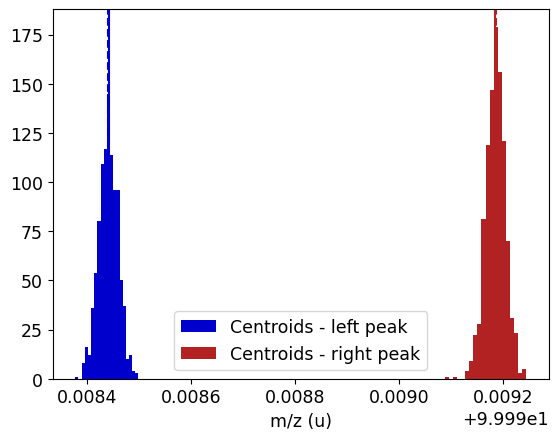

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

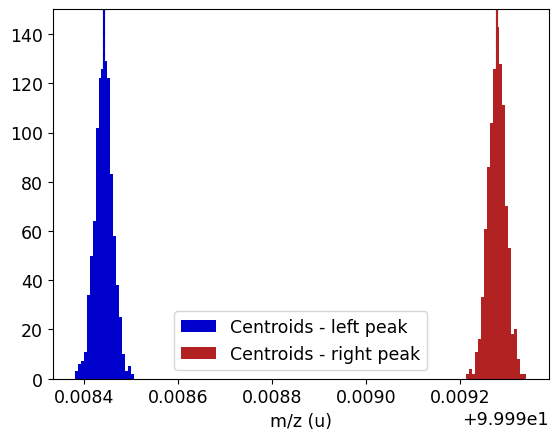

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

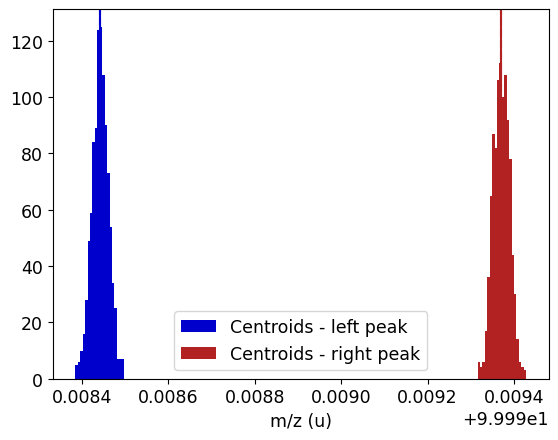

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

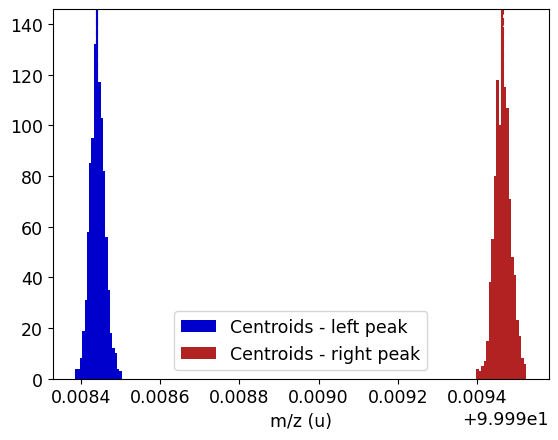

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

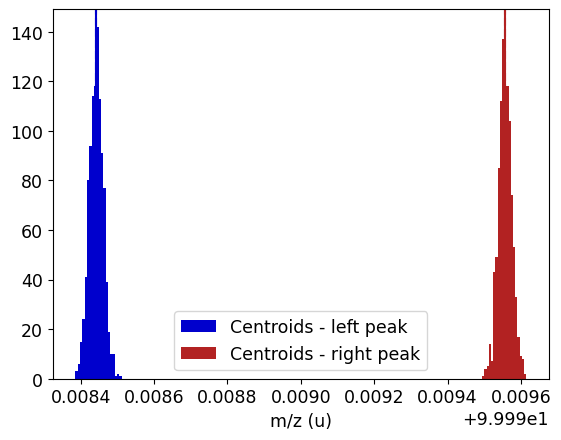

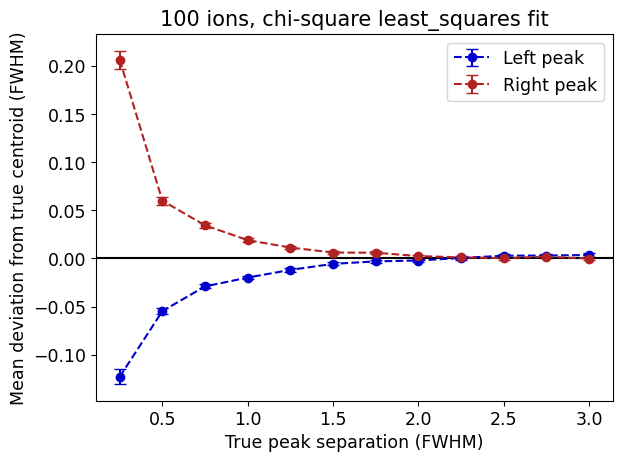

In [15]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 10
N_spectra = 1000
cost_func = "chi-square"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, least_squares fit

Total event number: 110
Background amplitude: bkg_c = 2.0000000000018154

##### Plot example spectrum and fit #####


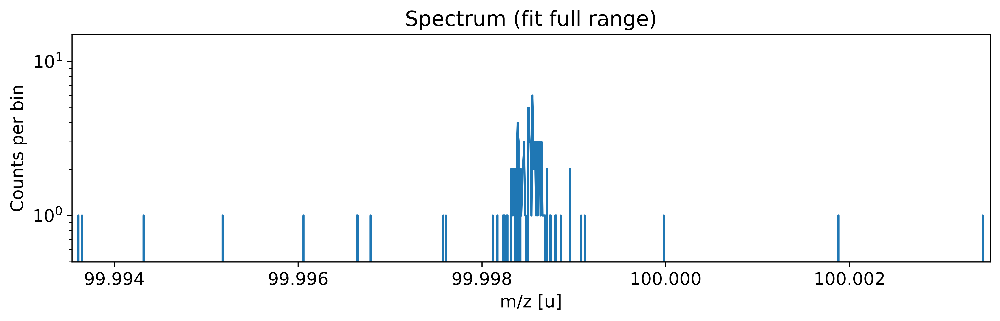

Added peak at 99.99843880607318 u
Added peak at 99.99865457228158 u


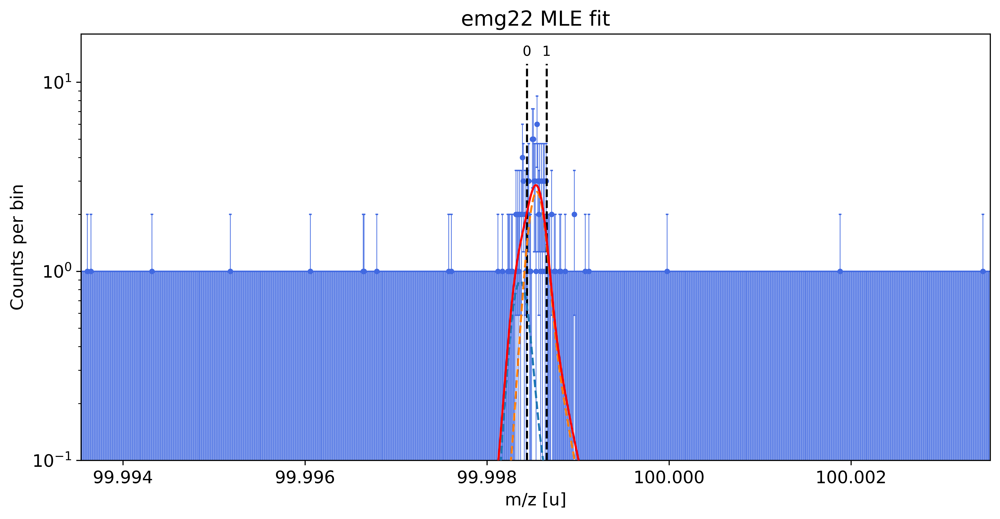

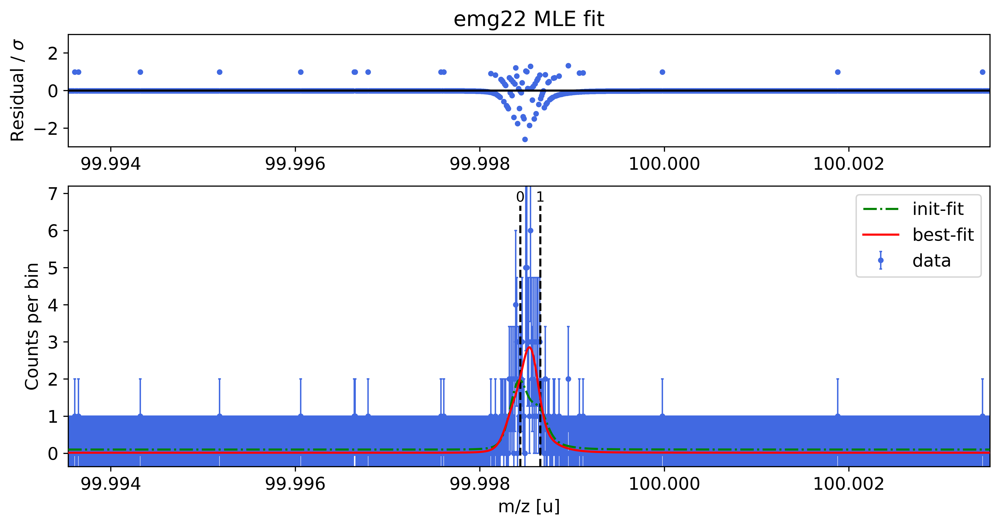

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


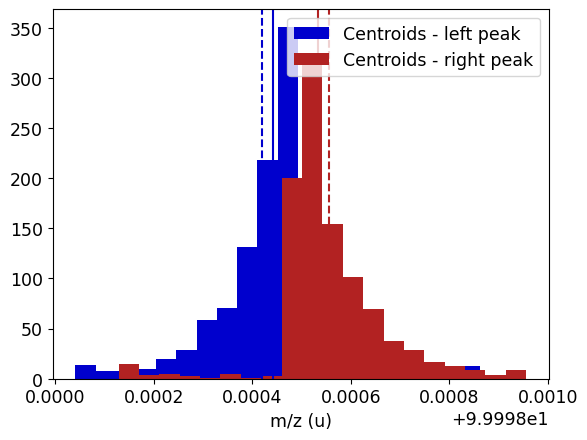

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

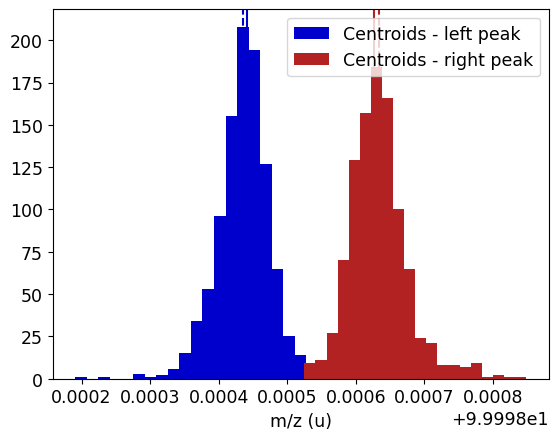

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

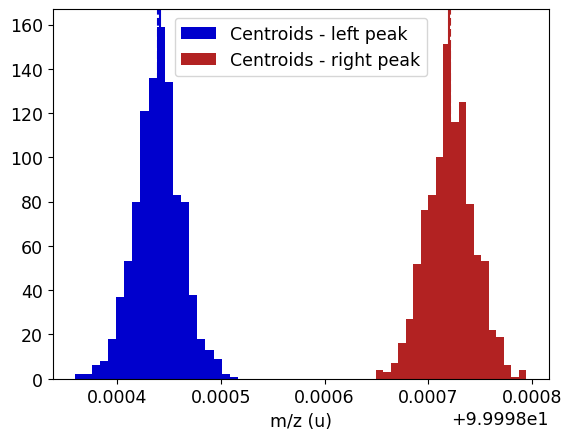

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

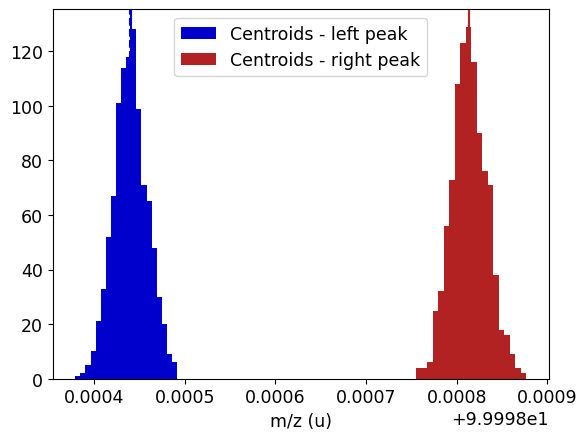

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

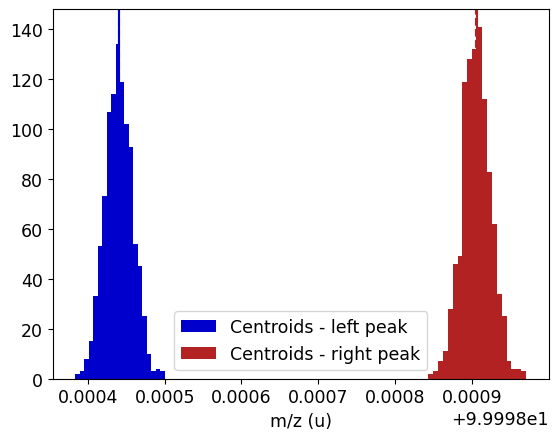

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

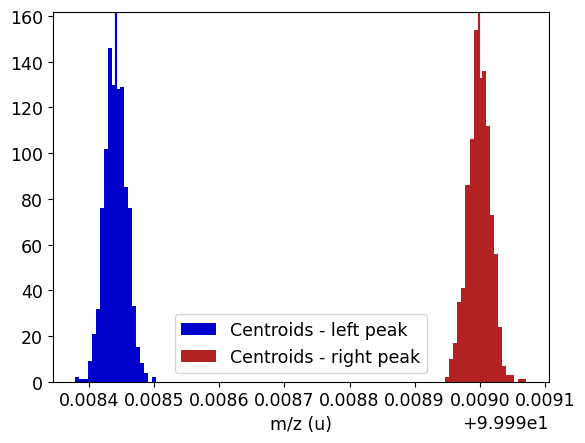

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

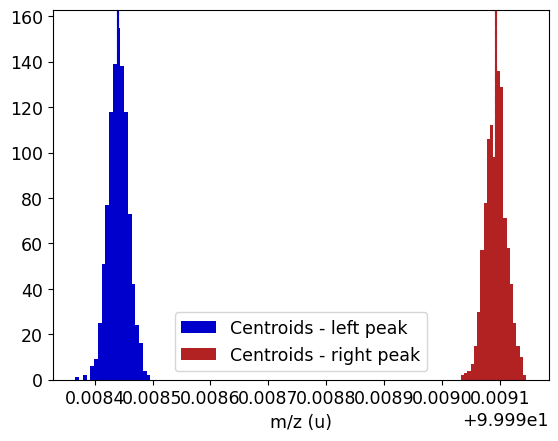

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

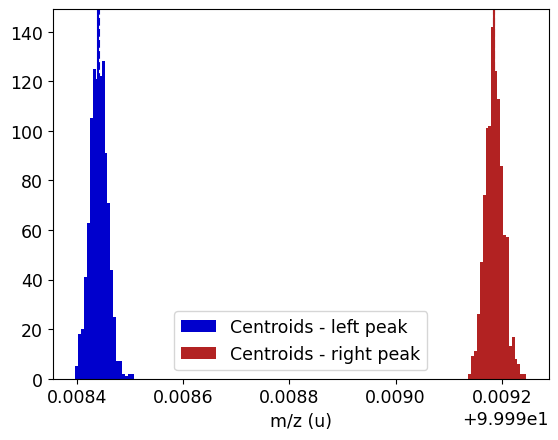

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

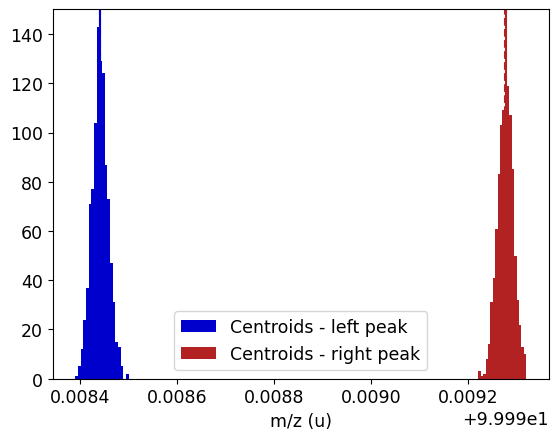

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

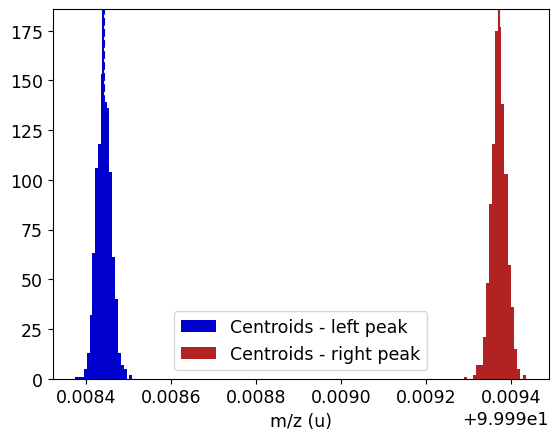

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

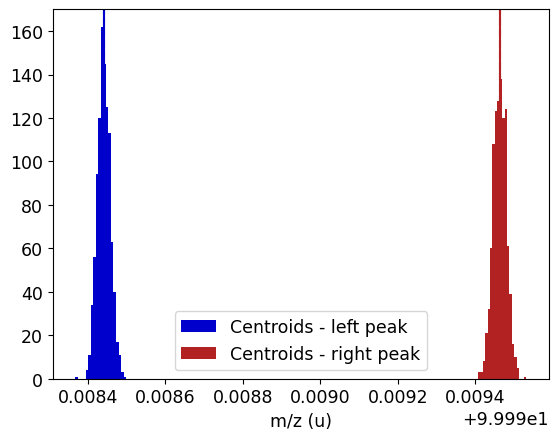

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

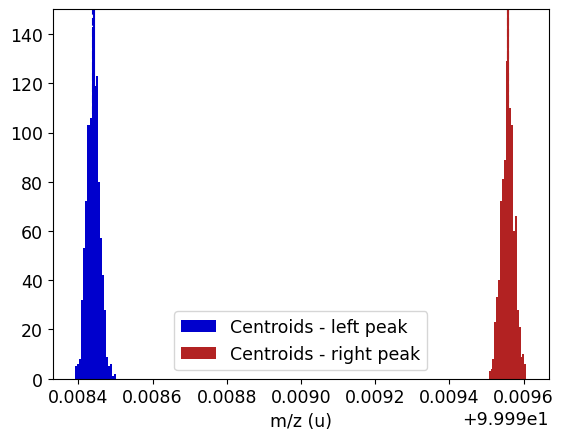

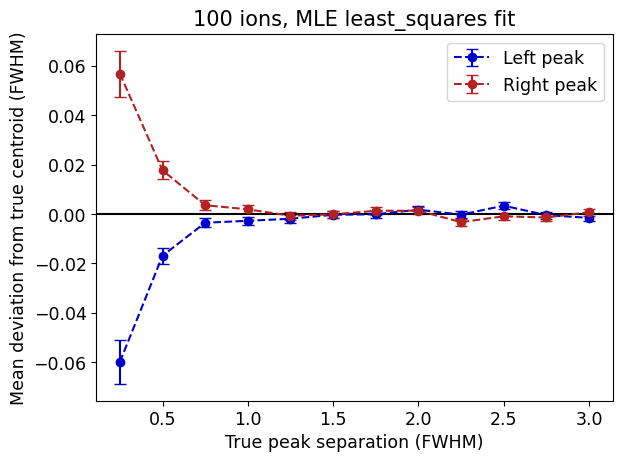

In [16]:
amps = [0.1, 0.1]
N_ions = 100
N_bkg = 10
N_spectra = 1000
cost_func = "MLE"
method = "least_squares"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)

#### MLE, Powell fit

Total event number: 110
Background amplitude: bkg_c = 2.0000000000018154

##### Plot example spectrum and fit #####


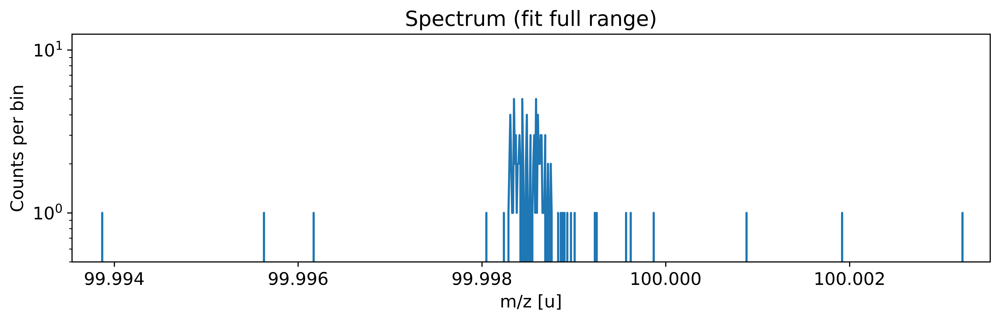

Added peak at 99.99843441330171 u
Added peak at 99.99862433581863 u


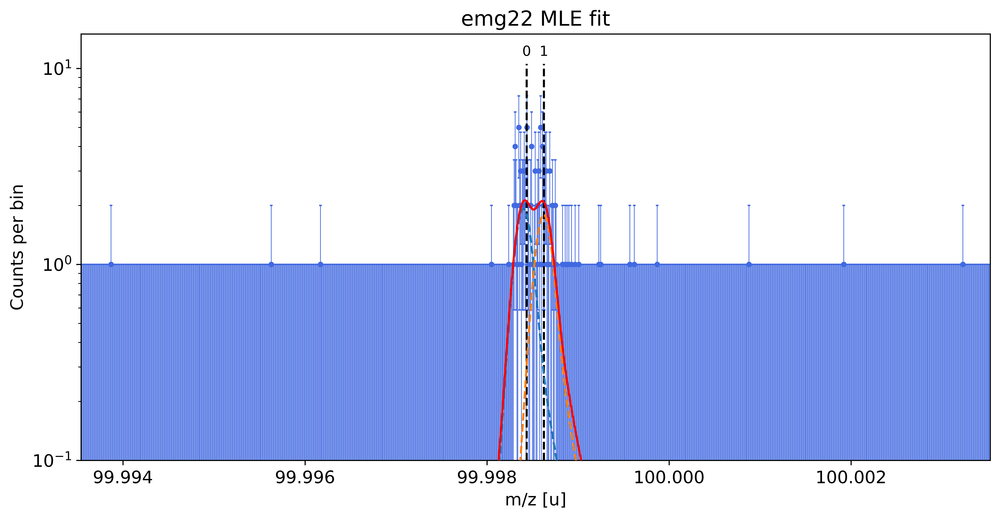

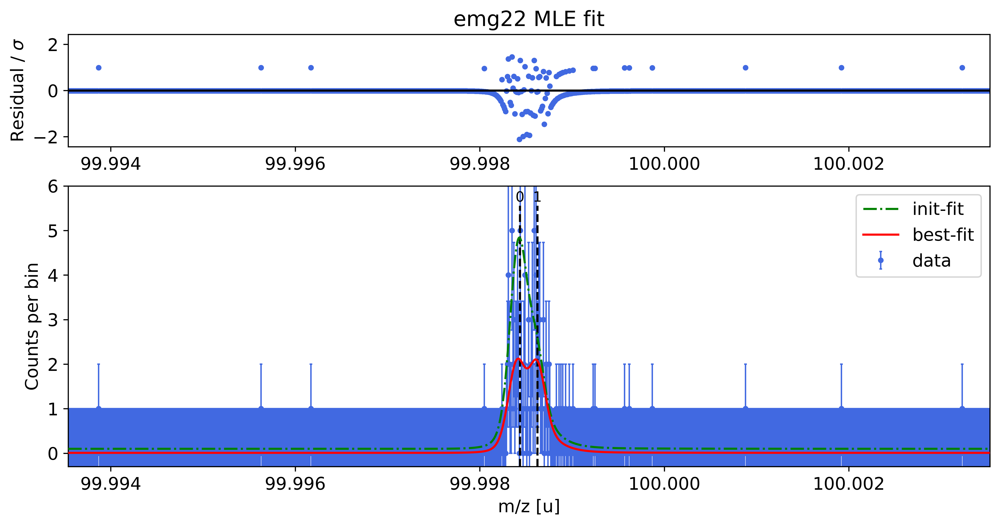

FWHM: 0.00022624276930116594 u

##### Evaluate peak overlap bias #####
Peak separation: 9.3e-05 u


  0%|          | 0/1000 [00:00<?, ?it/s]

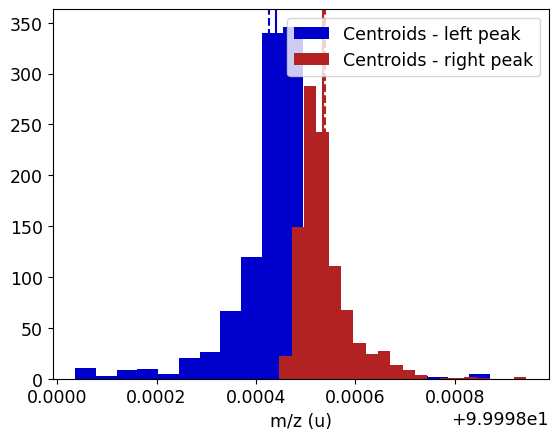

Peak separation: 0.000186 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/sample.py:384: UserWarning: 1 simulated events fell outside the specified sampling range and were discarded. Peak areas and area ratios might deviate from expectation.
  warnings.warn(msg, UserWarning)


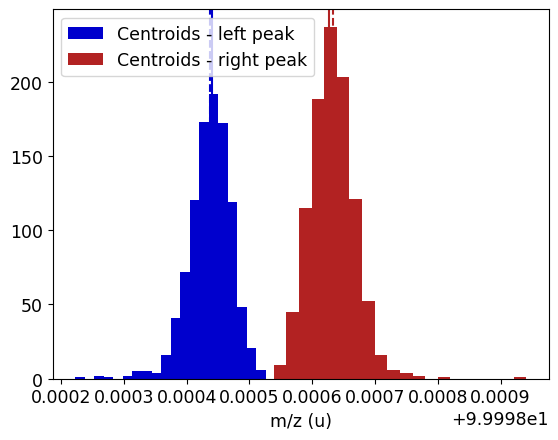

Peak separation: 0.000279 u


  0%|          | 0/1000 [00:00<?, ?it/s]

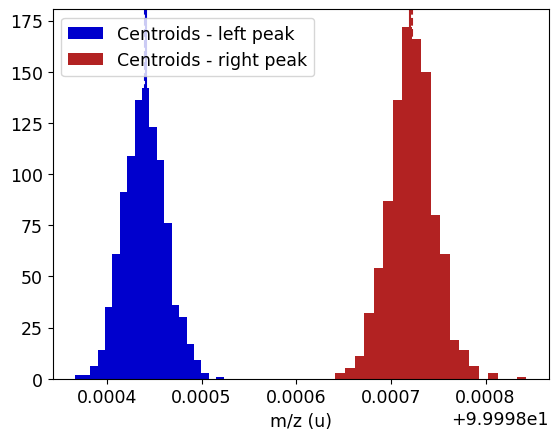

Peak separation: 0.000372 u


  0%|          | 0/1000 [00:00<?, ?it/s]

/Users/stefan/Library/CloudStorage/OneDrive-Personal/emgfit package/emgfit/emgfit/spectrum.py:2665: UserWarning: Best-fit value for p0_mu agrees with initial value within +/-1e-09 - danger of failed convergence!
  warnings.warn(msg)


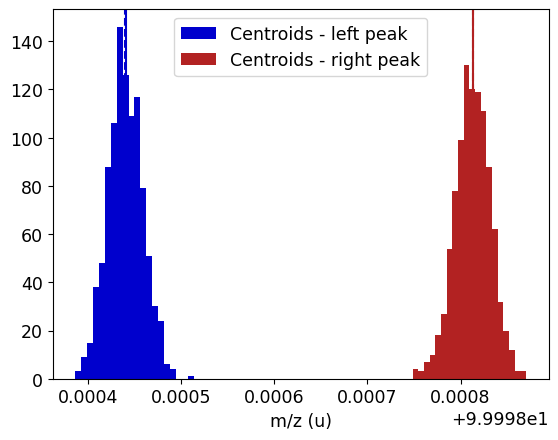

Peak separation: 0.00046499999999999997 u


  0%|          | 0/1000 [00:00<?, ?it/s]

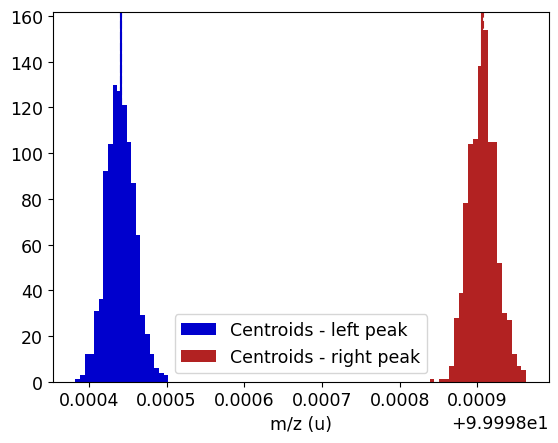

Peak separation: 0.000558 u


  0%|          | 0/1000 [00:00<?, ?it/s]

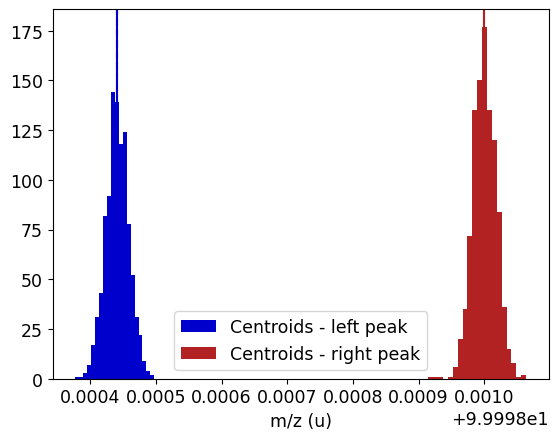

Peak separation: 0.000651 u


  0%|          | 0/1000 [00:00<?, ?it/s]

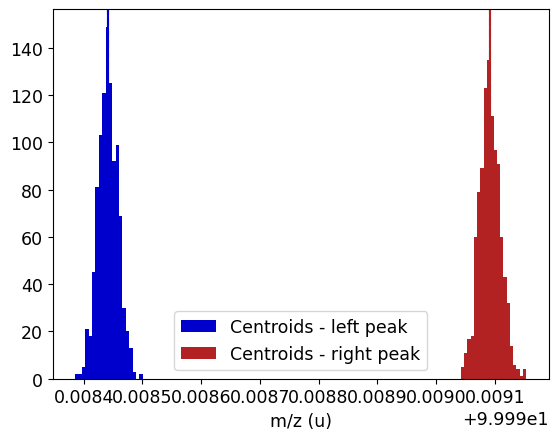

Peak separation: 0.000744 u


  0%|          | 0/1000 [00:00<?, ?it/s]

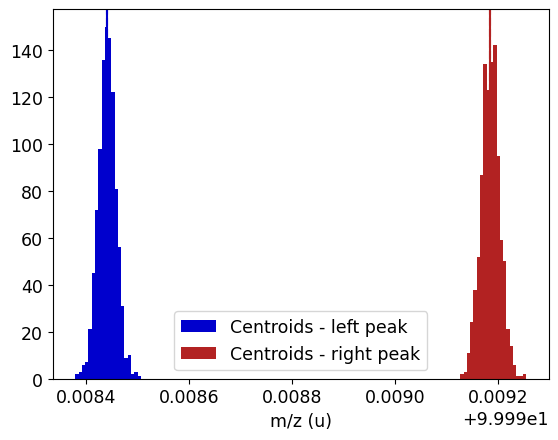

Peak separation: 0.000837 u


  0%|          | 0/1000 [00:00<?, ?it/s]

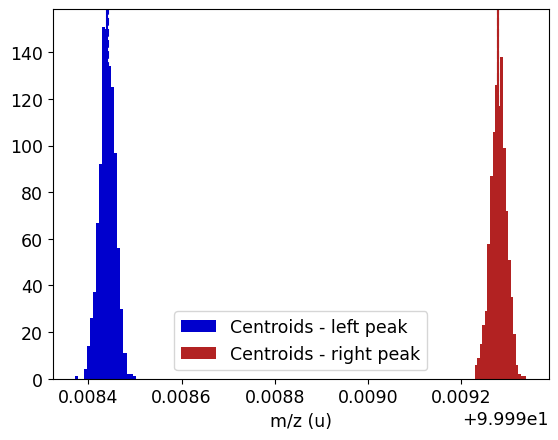

Peak separation: 0.0009299999999999999 u


  0%|          | 0/1000 [00:00<?, ?it/s]

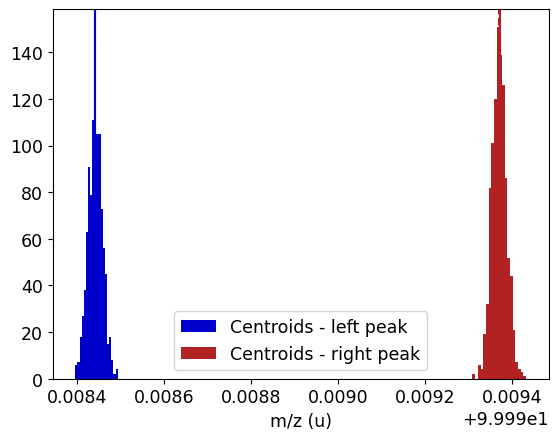

Peak separation: 0.001023 u


  0%|          | 0/1000 [00:00<?, ?it/s]

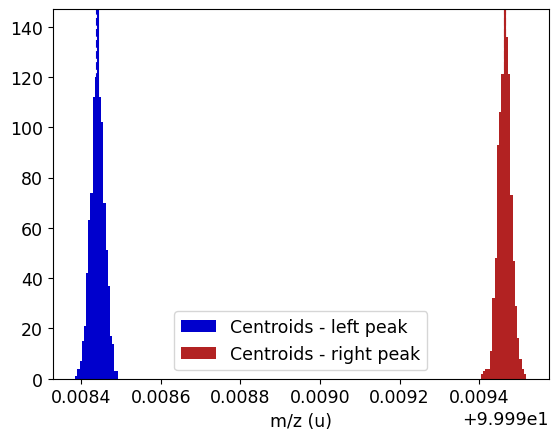

Peak separation: 0.001116 u


  0%|          | 0/1000 [00:00<?, ?it/s]

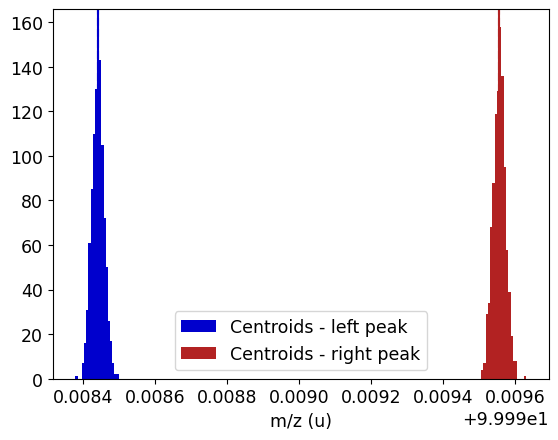

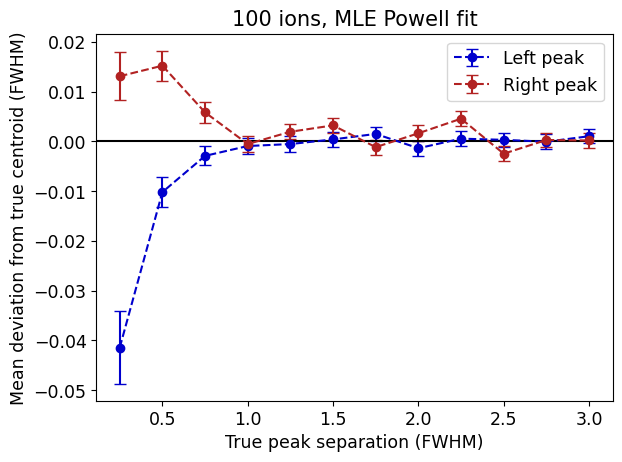

In [17]:
## amps = [0.1, 0.1]
N_ions = 100
N_bkg = 10
N_spectra = 1000
cost_func = "MLE"
method = "Powell"
peak_separations = np.linspace(0.25, 3, 12)*FWHM

evaluate_peak_overlap_bias(peak_separations, shape_pars, fit_model, FWHM, amps, N_ions, N_bkg, 
                           N_spectra=N_spectra, cost_func=cost_func, method=method, N_bins=N_bins, 
                           save_figure=True)